<h1><b>Time Series Analysis</b></h1>

Components of a Time-Series<br>

1. Trend - The trend shows a general direction of the time series data over a long period of time. A trend can be increasing (upward), decreasing (downward), or horizontal (stationary).
2. Seasonality - The seasonality component exhibits a trend that repeats with respect to timing, direction, and magnitude. Some examples include an increase in water consumption in summer due to hot weather conditions.   
3. Cyclical Component - These are the trends with no set repetition over a particular period of time. A cycle refers to the period of ups and downs, booms and slums of a time series, mostly observed in business cycles. These cycles do not exhibit a seasonal variation but generally occur over a time period of 3 to 12 years depending on the nature of the time series.
4. Irregular Variation - These are the fluctuations in the time series data which become evident when trend and cyclical variations are removed. These variations are unpredictable, erratic, and may or may not be random.
5. ETS Decomposition - ETS Decomposition is used to separate different components of a time series. The term ETS stands for Error, Trend and Seasonality.<br>
In this notebook, I conduct time series analysis of river flow data of the Grand River of Canada.

Reference: https://www.kaggle.com/code/prashant111/complete-guide-on-time-series-analysis-in-python

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# **Importing data**

In [ ]:
river_flow = pd.read_csv("RiverFlow.csv")
river_flow

,Timestamp,Aberfoyle,Ayr,BlairCreek,Bridgeport,BridgeportWQ,ClairCreek,Doon,Drayton,Elmira,...,Keldon,Leggatt,MillCreek,Moorefield,Phillipsburg,Road32,VictoriaRoad,Waldemar,WillowBrook,York
0,2018-01-01 00:00:00,0.382068,-999.000000,0.162000,44.202684,26.932000,0.048200,15.136015,1.633473,0.6800,...,1.207453,2.940143,0.898000,0.883397,2.394857,3.568644,1.059240,6.571770,1.142622,56.884066
1,2018-01-01 01:00:00,0.384540,-999.000000,0.162000,44.040912,26.825400,0.048200,15.150000,1.611479,0.6800,...,1.223004,2.957151,0.902000,0.887479,2.416549,3.634335,1.066568,6.589006,1.123353,55.332323
2,2018-01-01 02:00:00,0.384540,-999.000000,0.162250,44.404860,26.710600,0.047975,15.163985,1.615141,0.6800,...,1.230818,2.962889,0.898000,0.887479,2.387635,3.688094,1.051899,6.554596,1.156076,54.987491
3,2018-01-01 03:00:00,0.387731,-999.000000,0.156458,44.040912,26.620400,0.046400,15.177970,1.607817,0.6800,...,1.230835,2.957201,0.902000,0.888838,2.380400,3.697868,1.055549,6.545890,1.156076,54.987491
4,2018-01-01 04:00:00,0.388086,-999.000000,0.149000,44.121798,26.612200,0.045275,15.191955,1.589485,0.6800,...,1.223056,2.957189,0.902000,0.888838,2.344251,3.683207,1.059232,6.537265,1.156076,54.987491
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43843,2023-01-01 19:00:00,0.673899,68.246566,6.112500,63.906250,66.752000,0.347083,69.145801,44.066383,3.1520,...,11.259375,27.373467,2.099606,13.084098,61.677028,6.587513,0.456600,26.698283,1.973442,70.339806
43844,2023-01-01 20:00:00,0.655979,70.137500,6.677500,62.625000,65.328000,0.346561,67.147994,42.725918,3.1205,...,10.779167,26.982467,2.065631,12.854528,58.653723,6.661228,0.456600,26.765158,2.023615,77.500000
43845,2023-01-01 21:00:00,0.640239,71.650000,6.511250,61.468750,63.942500,0.342432,66.370603,41.430100,3.0890,...,10.689583,26.656740,2.033860,12.601612,55.564362,6.686446,0.456600,26.984320,2.150197,86.687500
43846,2023-01-01 22:00:00,0.624865,72.587500,6.135000,60.479167,62.864375,0.337916,64.925872,40.200860,3.0575,...,10.392708,26.371090,2.002358,12.344837,52.334574,6.670927,0.456600,27.173024,2.248953,90.843750


In [ ]:
river_flow.columns

Index(['Timestamp', 'Aberfoyle', 'Ayr', 'BlairCreek', 'Bridgeport',
       'BridgeportWQ', 'ClairCreek', 'Doon', 'Drayton', 'Elmira', 'Erbsville',
       'Floradale', 'Keldon', 'Leggatt', 'MillCreek', 'Moorefield',
       'Phillipsburg', 'Road32', 'VictoriaRoad', 'Waldemar', 'WillowBrook',
       'York'],
      dtype='object')

In [ ]:
#Number of Missing values
river_flow.isin([-999]).sum(axis= 0)

Timestamp           0
Aberfoyle        9903
Ayr              5307
BlairCreek        823
Bridgeport        105
BridgeportWQ      729
ClairCreek      21082
Doon                0
Drayton           200
Elmira            189
Erbsville          82
Floradale         870
Keldon            220
Leggatt           321
MillCreek         671
Moorefield        670
Phillipsburg     1194
Road32            274
VictoriaRoad       37
Waldemar          672
WillowBrook      2698
York                0
dtype: int64

In [ ]:
len(river_flow)

43848

In [ ]:
river_flow.dtypes

Timestamp        object
Aberfoyle       float64
Ayr             float64
BlairCreek      float64
Bridgeport      float64
BridgeportWQ    float64
ClairCreek      float64
Doon            float64
Drayton         float64
Elmira          float64
Erbsville       float64
Floradale       float64
Keldon          float64
Leggatt         float64
MillCreek       float64
Moorefield      float64
Phillipsburg    float64
Road32          float64
VictoriaRoad    float64
Waldemar        float64
WillowBrook     float64
York            float64
dtype: object

In [ ]:
river_flow['Timestamp'] = pd.to_datetime(river_flow['Timestamp'])
river_flow.Timestamp.dtype

dtype('<M8[ns]')

In [ ]:
river_flow.Timestamp.dtype

dtype('<M8[ns]')

In [ ]:
river_flow[river_flow == -999] = np.nan
river_flow.isin([np.nan]).sum(axis= 0)

Timestamp           0
Aberfoyle        9903
Ayr              5307
BlairCreek        823
Bridgeport        105
BridgeportWQ      729
ClairCreek      21082
Doon                0
Drayton           200
Elmira            189
Erbsville          82
Floradale         870
Keldon            220
Leggatt           321
MillCreek         671
Moorefield        670
Phillipsburg     1194
Road32            274
VictoriaRoad       37
Waldemar          672
WillowBrook      2698
York                0
dtype: int64

In [ ]:
river_flow.set_index("Timestamp", inplace=True)
river_flow

,Aberfoyle,Ayr,BlairCreek,Bridgeport,BridgeportWQ,ClairCreek,Doon,Drayton,Elmira,Erbsville,...,Keldon,Leggatt,MillCreek,Moorefield,Phillipsburg,Road32,VictoriaRoad,Waldemar,WillowBrook,York
Timestamp,,,,,,,,,,,,,,,,,,,,,
2018-01-01 00:00:00,0.382068,NaN,0.162000,44.202684,26.932000,0.048200,15.136015,1.633473,0.6800,0.135527,...,1.207453,2.940143,0.898000,0.883397,2.394857,3.568644,1.059240,6.571770,1.142622,56.884066
2018-01-01 01:00:00,0.384540,NaN,0.162000,44.040912,26.825400,0.048200,15.150000,1.611479,0.6800,0.135047,...,1.223004,2.957151,0.902000,0.887479,2.416549,3.634335,1.066568,6.589006,1.123353,55.332323
2018-01-01 02:00:00,0.384540,NaN,0.162250,44.404860,26.710600,0.047975,15.163985,1.615141,0.6800,0.135527,...,1.230818,2.962889,0.898000,0.887479,2.387635,3.688094,1.051899,6.554596,1.156076,54.987491
2018-01-01 03:00:00,0.387731,NaN,0.156458,44.040912,26.620400,0.046400,15.177970,1.607817,0.6800,0.136970,...,1.230835,2.957201,0.902000,0.888838,2.380400,3.697868,1.055549,6.545890,1.156076,54.987491
2018-01-01 04:00:00,0.388086,NaN,0.149000,44.121798,26.612200,0.045275,15.191955,1.589485,0.6800,0.135047,...,1.223056,2.957189,0.902000,0.888838,2.344251,3.683207,1.059232,6.537265,1.156076,54.987491
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-01-01 19:00:00,0.673899,68.246566,6.112500,63.906250,66.752000,0.347083,69.145801,44.066383,3.1520,0.462402,...,11.259375,27.373467,2.099606,13.084098,61.677028,6.587513,0.456600,26.698283,1.973442,70.339806
2023-01-01 20:00:00,0.655979,70.137500,6.677500,62.625000,65.328000,0.346561,67.147994,42.725918,3.1205,0.433461,...,10.779167,26.982467,2.065631,12.854528,58.653723,6.661228,0.456600,26.765158,2.023615,77.500000
2023-01-01 21:00:00,0.640239,71.650000,6.511250,61.468750,63.942500,0.342432,66.370603,41.430100,3.0890,0.410553,...,10.689583,26.656740,2.033860,12.601612,55.564362,6.686446,0.456600,26.984320,2.150197,86.687500


In [ ]:
#Percentage of Missing values
l = len(river_flow)
for i in range(1, len(river_flow.columns)):
  m = river_flow.iloc[ : , i].isin([np.nan]).sum(axis= 0)
  p = 100*m/l
  print(river_flow.columns[i], "         ",p)

Ayr           12.103174603174603
BlairCreek           1.8769385148695494
Bridgeport           0.23946360153256704
BridgeportWQ           1.6625615763546797
ClairCreek           48.0797299762817
Doon           0.0
Drayton           0.4561211457763182
Elmira           0.43103448275862066
Erbsville           0.18700966976829045
Floradale           1.9841269841269842
Keldon           0.50173326035395
Leggatt           0.7320744389709907
MillCreek           1.5302864440795476
Moorefield           1.5280058383506658
Phillipsburg           2.7230432402846194
Road32           0.6248859697135559
VictoriaRoad           0.08438241196861887
Waldemar           1.5325670498084292
WillowBrook           6.153074256522532
York           0.0


Clair Creek have nearly half of its data missing. So I will drop it for now.

In [ ]:
river_flow.drop(columns= ["ClairCreek"], inplace= True)

In [ ]:
#Percentage of Missing values
l = len(river_flow)
for i in range(1, len(river_flow.columns)):
  m = river_flow.iloc[ : , i].isin([np.nan]).sum(axis= 0)
  p = 100*m/l
  print(river_flow.columns[i], "         ", p)

Ayr           12.103174603174603
BlairCreek           1.8769385148695494
Bridgeport           0.23946360153256704
BridgeportWQ           1.6625615763546797
Doon           0.0
Drayton           0.4561211457763182
Elmira           0.43103448275862066
Erbsville           0.18700966976829045
Floradale           1.9841269841269842
Keldon           0.50173326035395
Leggatt           0.7320744389709907
MillCreek           1.5302864440795476
Moorefield           1.5280058383506658
Phillipsburg           2.7230432402846194
Road32           0.6248859697135559
VictoriaRoad           0.08438241196861887
Waldemar           1.5325670498084292
WillowBrook           6.153074256522532
York           0.0


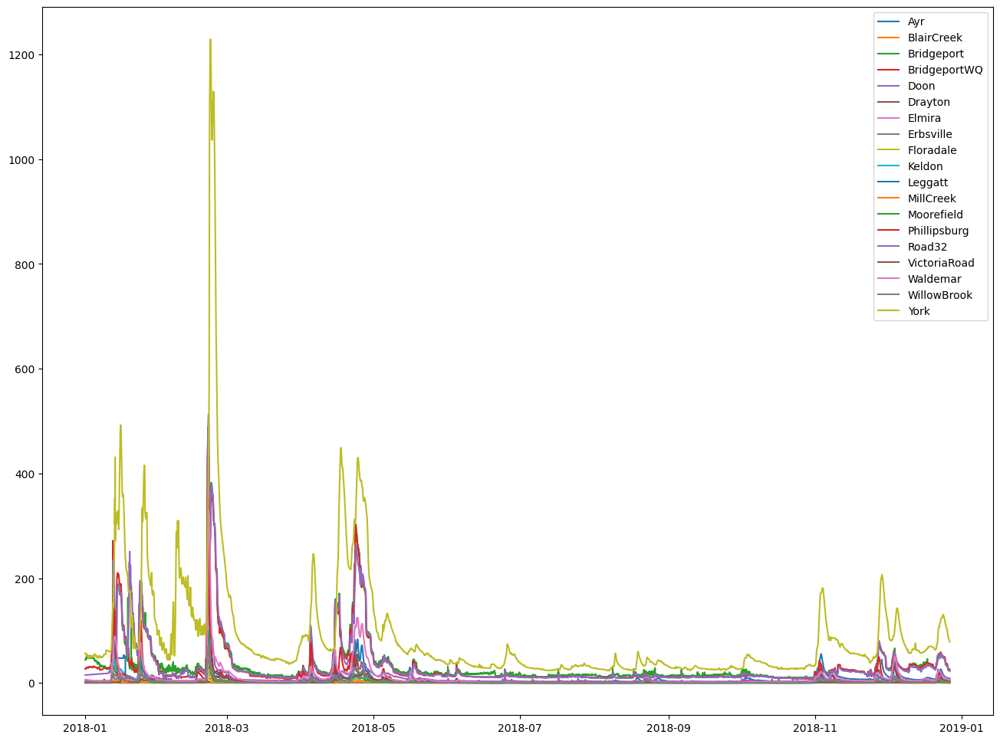

In [ ]:
#Simple 2018 plot
plt.figure(figsize= (16,12))
for i in range(1, len(river_flow.columns)):
  plt.plot(river_flow.iloc[0:8640, i], label= river_flow.columns[i])
plt.legend()

# **Interpolation of Missing values**

[Text(0.5, 1.0, 'Data')]

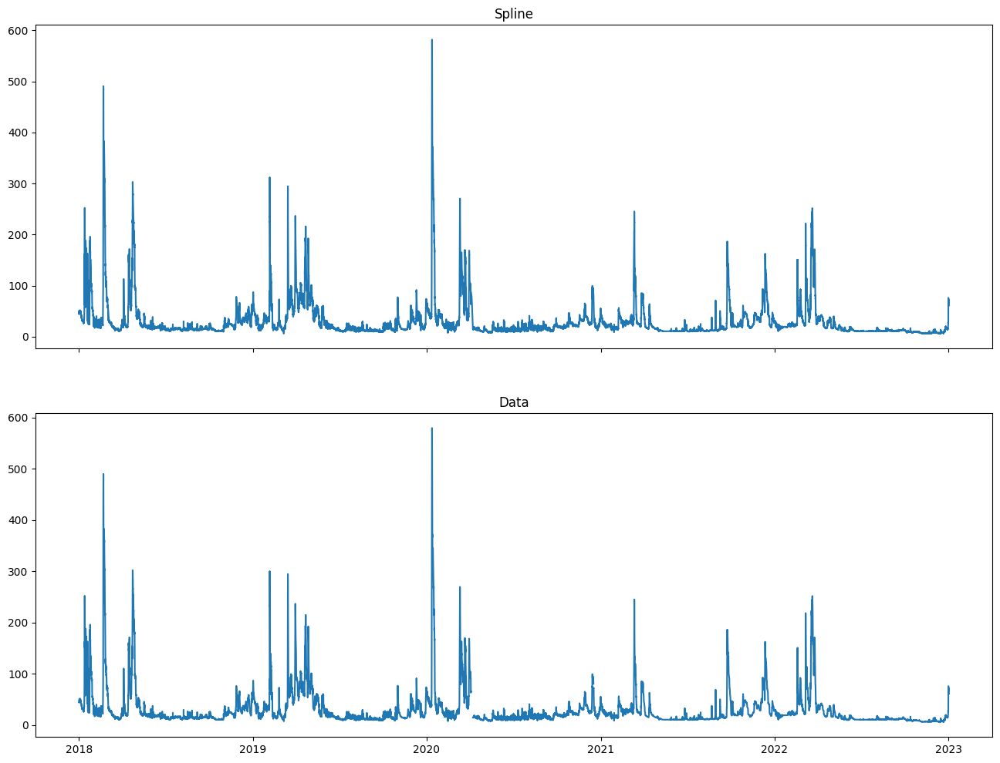

In [ ]:
#Comparing Spline Interpolation with our data for one columns with around 2% missing values
river_flow_re = river_flow.iloc[:, 3].resample('T').mean()
#river_flow_re.interpolate(method='spline', order=3).plot(label= "Spline")
#river_flow.iloc[:, 3].plot()
fig, ax = plt.subplots(2, sharex='col', sharey='row', figsize= (16,12))

ax[0].plot(river_flow_re.interpolate(method='spline', order=3))
ax[0].set(title='Spline')

ax[1].plot(river_flow.iloc[:, 3])
ax[1].set(title='Data')

[Text(0.5, 1.0, 'Data')]

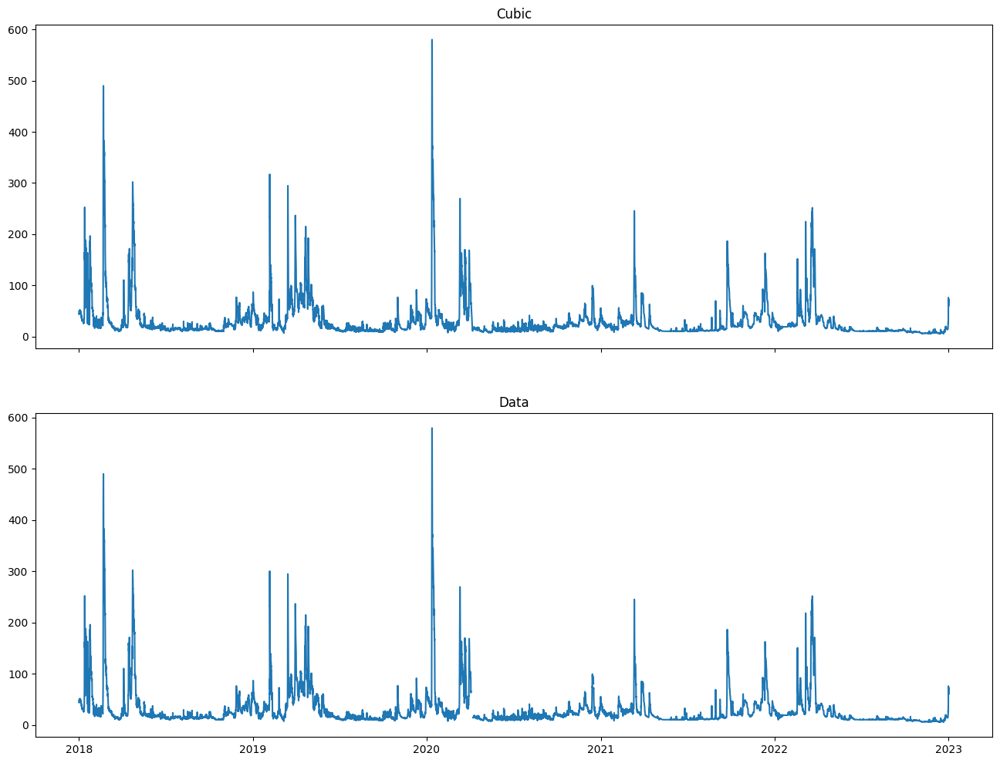

In [ ]:
#Comparing cubic Interpolation with our data for one columns with around 2% missing values
river_flow_re = river_flow.iloc[:, 3].resample('T').mean()
#river_flow_re.interpolate(method='spline', order=3).plot(label= "Spline")
#river_flow.iloc[:, 3].plot()
fig, ax = plt.subplots(2, sharex='col', sharey='row', figsize= (16,12))

ax[0].plot(river_flow_re.interpolate(method='cubic', order=3))
ax[0].set(title='Cubic')

ax[1].plot(river_flow.iloc[:, 3])
ax[1].set(title='Data')

[Text(0.5, 1.0, 'Data')]

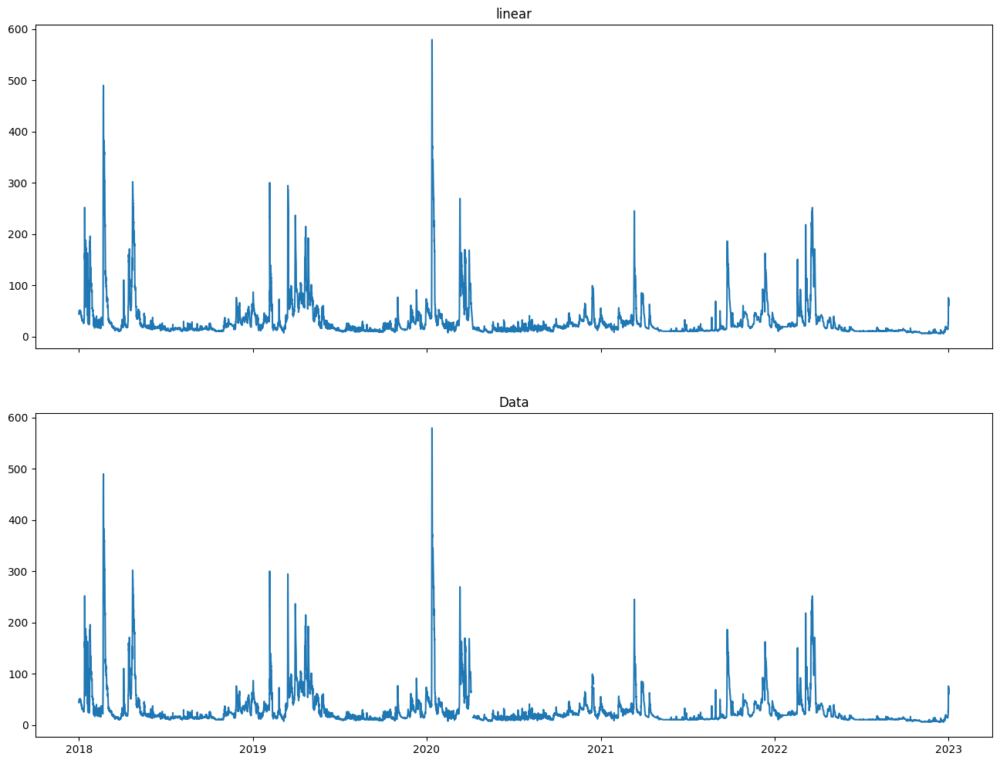

In [ ]:
#Comparing linear Interpolation with our data for one columns with around 2% missing values
river_flow_re = river_flow.iloc[:, 3].resample('T').mean()
#river_flow_re.interpolate(method='spline', order=3).plot(label= "Spline")
#river_flow.iloc[:, 3].plot()
fig, ax = plt.subplots(2, sharex='col', sharey='row', figsize= (16,12))

ax[0].plot(river_flow_re.interpolate(method='linear'))
ax[0].set(title='linear')

ax[1].plot(river_flow.iloc[:, 3])
ax[1].set(title='Data')

[Text(0.5, 1.0, 'Data')]

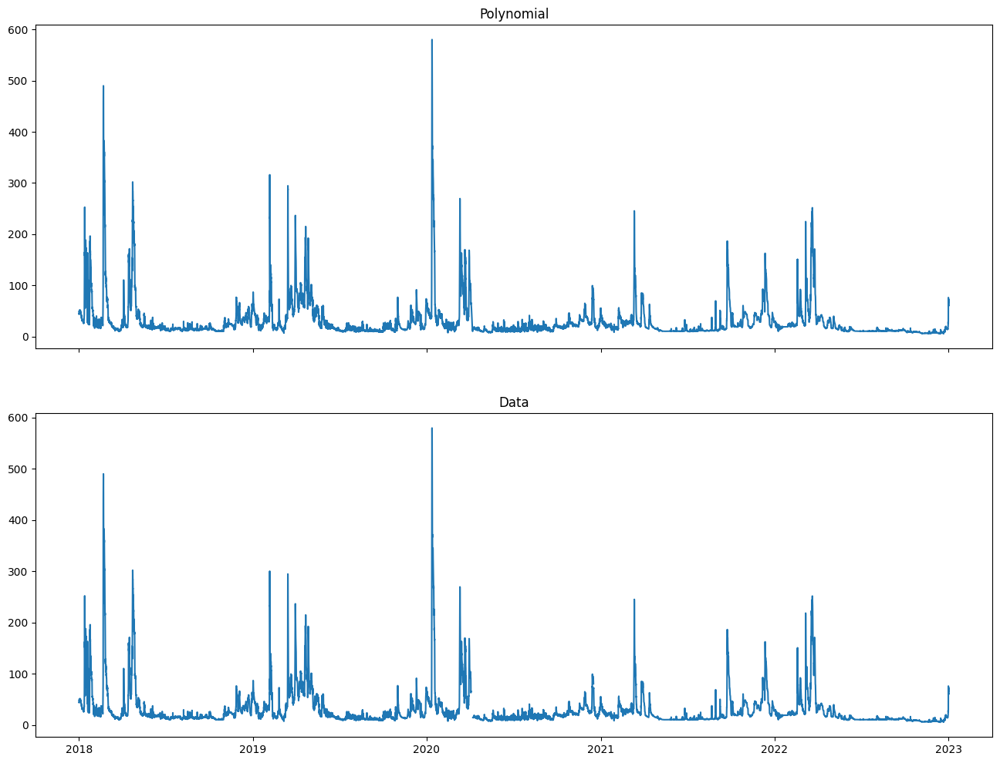

In [ ]:
#Comparing Polynomial (3) Interpolation with our data for one columns with around 2% missing values
river_flow_re = river_flow.iloc[:, 3].resample('T').mean()
#river_flow_re.interpolate(method='spline', order=3).plot(label= "Spline")
#river_flow.iloc[:, 3].plot()
fig, ax = plt.subplots(2, sharex='col', sharey='row', figsize= (16,12))

ax[0].plot(river_flow_re.interpolate(method='polynomial', order=2))
ax[0].set(title='Polynomial')

ax[1].plot(river_flow.iloc[:, 3])
ax[1].set(title='Data')

[Text(0.5, 1.0, 'Data')]

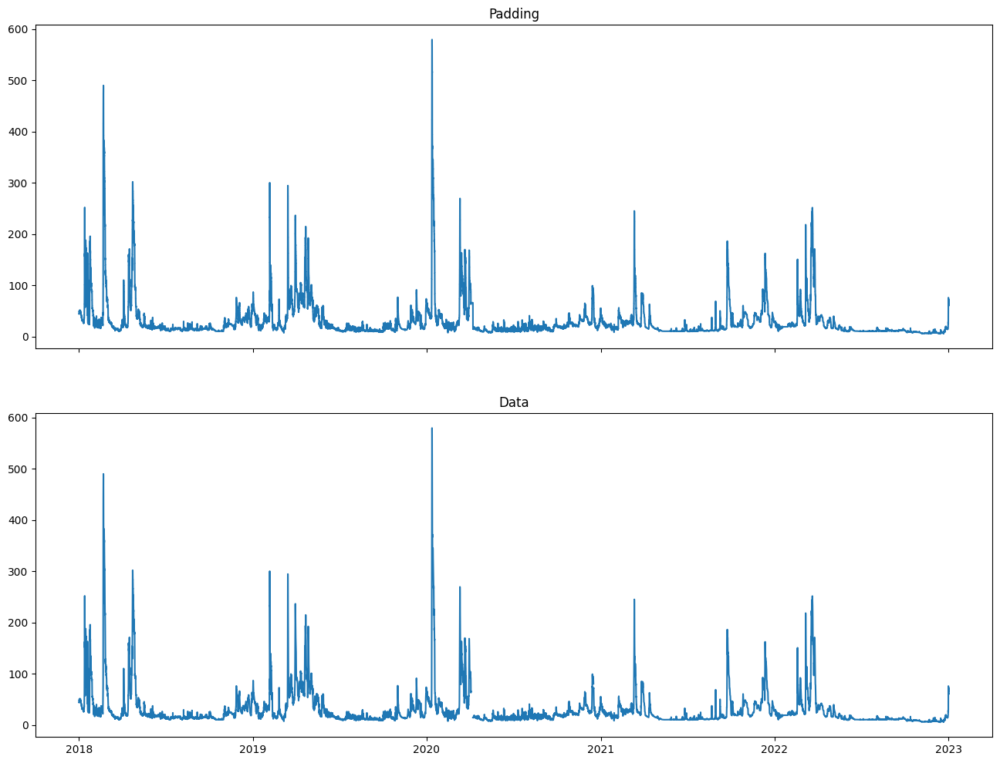

In [ ]:
#Comparing Padding Interpolation with our data for one columns with around 2% missing values
river_flow_re = river_flow.iloc[:, 3].resample('T').mean()
#river_flow_re.interpolate(method='spline', order=3).plot(label= "Spline")
#river_flow.iloc[:, 3].plot()
fig, ax = plt.subplots(2, sharex='col', sharey='row', figsize= (16,12))

ax[0].plot(river_flow_re.interpolate(method='pad', order=3))
ax[0].set(title='Padding')

ax[1].plot(river_flow.iloc[:, 3])
ax[1].set(title='Data')

Using different interpolation techniques, I feel that the spline interpolation works best as compared to the others for small percentages of missing values, but it also depend on the number of negative values as well.

[Text(0.5, 1.0, 'Data')]

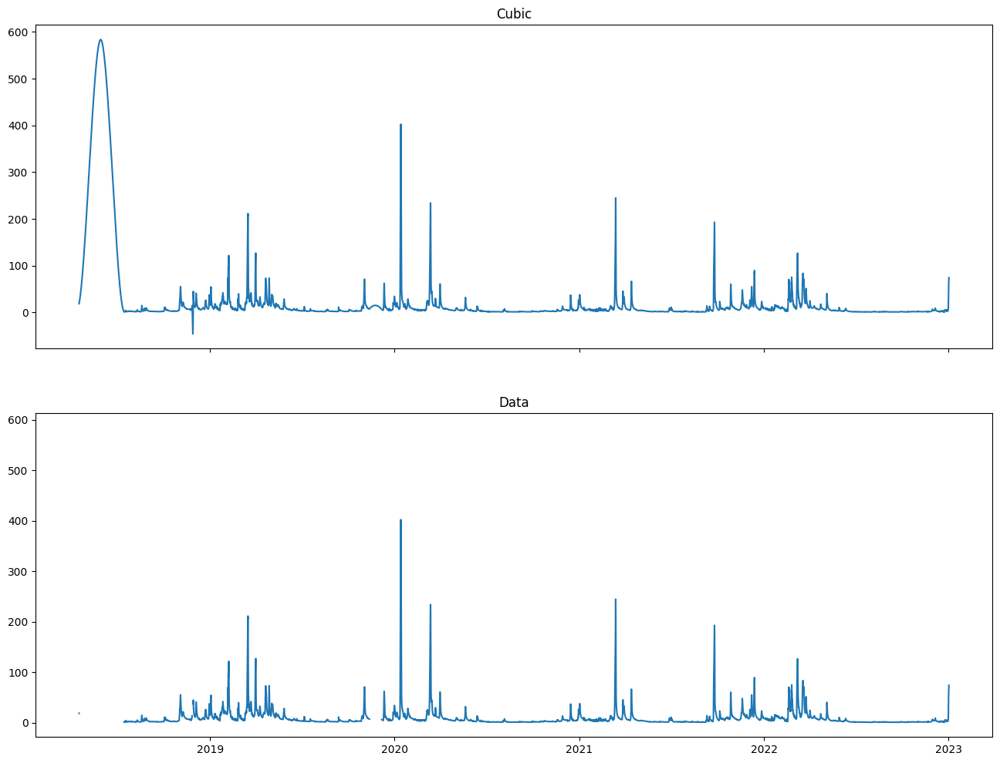

In [ ]:
river_flow_re = river_flow.iloc[:, 1].resample('T').mean()
#river_flow_re.interpolate(method='spline', order=3).plot(label= "Spline")
#river_flow.iloc[:, 3].plot()
fig, ax = plt.subplots(2, sharex='col', sharey='row', figsize= (16,12))

ax[0].plot(river_flow_re.interpolate(method='cubic', order=3))
ax[0].set(title='Cubic')

ax[1].plot(river_flow.iloc[:, 1])
ax[1].set(title='Data')

[Text(0.5, 1.0, 'Data')]

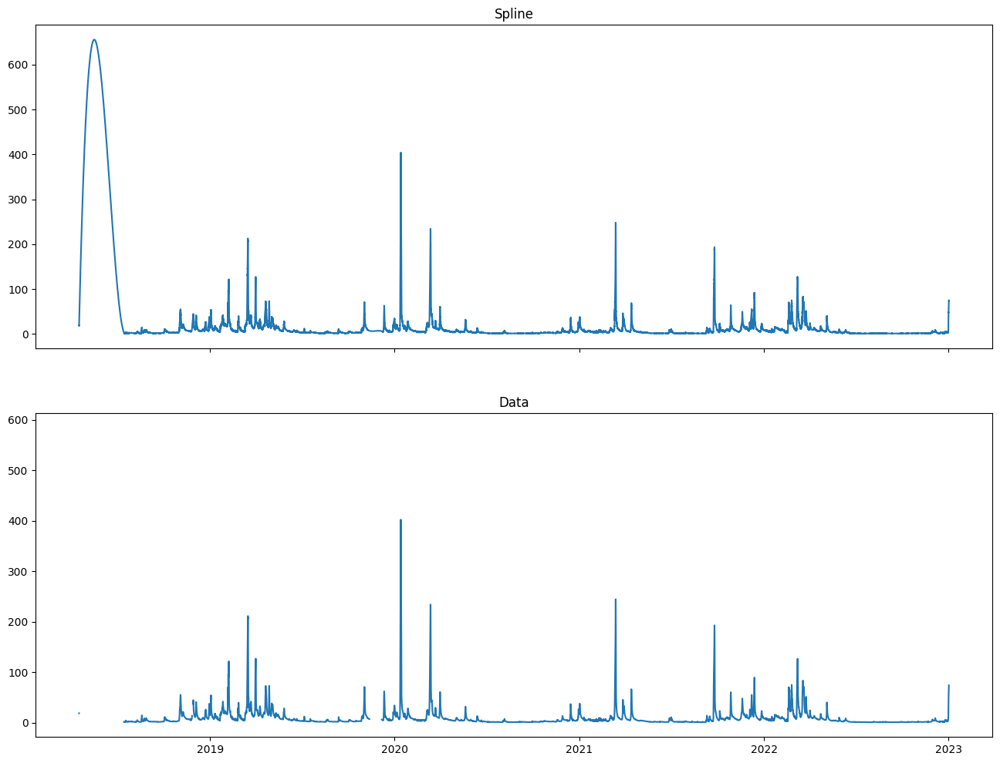

In [ ]:
river_flow_re = river_flow.iloc[:, 1].resample('T').mean()
#river_flow_re.interpolate(method='spline', order=3).plot(label= "Spline")
#river_flow.iloc[:, 3].plot()
fig, ax = plt.subplots(2, sharex='col', sharey='row', figsize= (16,12))

ax[0].plot(river_flow_re.interpolate(method='spline', order=3))
ax[0].set(title='Spline')

ax[1].plot(river_flow.iloc[:, 1])
ax[1].set(title='Data')

[Text(0.5, 1.0, 'Data')]

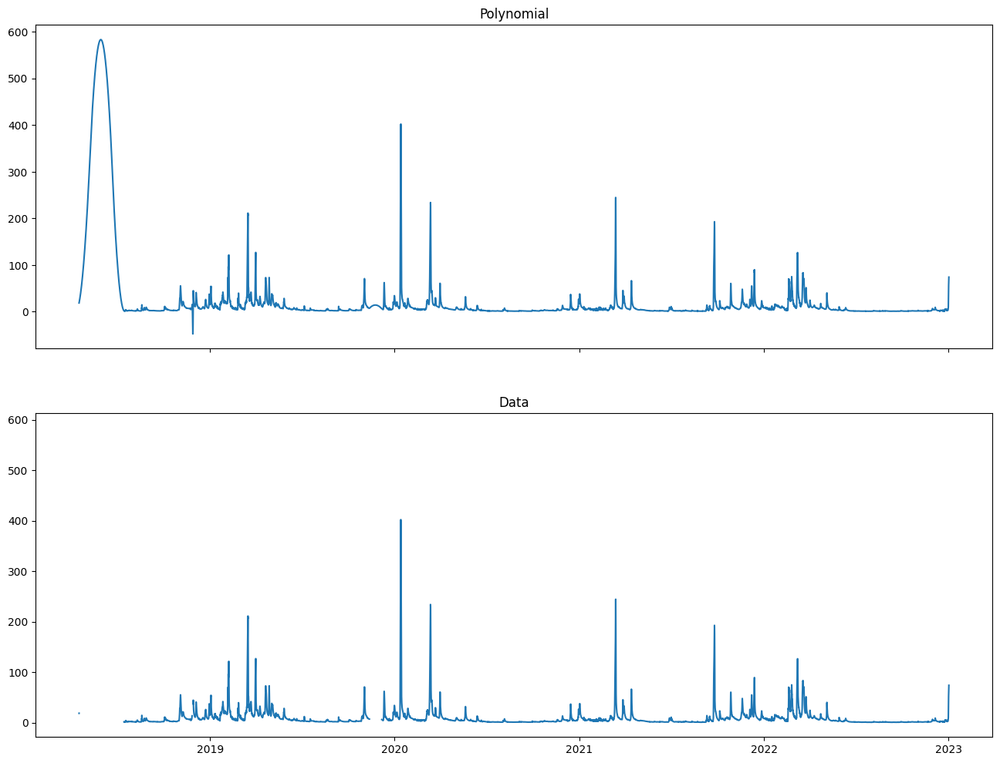

In [ ]:
river_flow_re = river_flow.iloc[:, 1].resample('T').mean()
#river_flow_re.interpolate(method='spline', order=3).plot(label= "Spline")
#river_flow.iloc[:, 3].plot()
fig, ax = plt.subplots(2, sharex='col', sharey='row', figsize= (16,12))

ax[0].plot(river_flow_re.interpolate(method='polynomial', order=2))
ax[0].set(title='Polynomial')

ax[1].plot(river_flow.iloc[:, 1])
ax[1].set(title='Data')

[Text(0.5, 1.0, 'Data')]

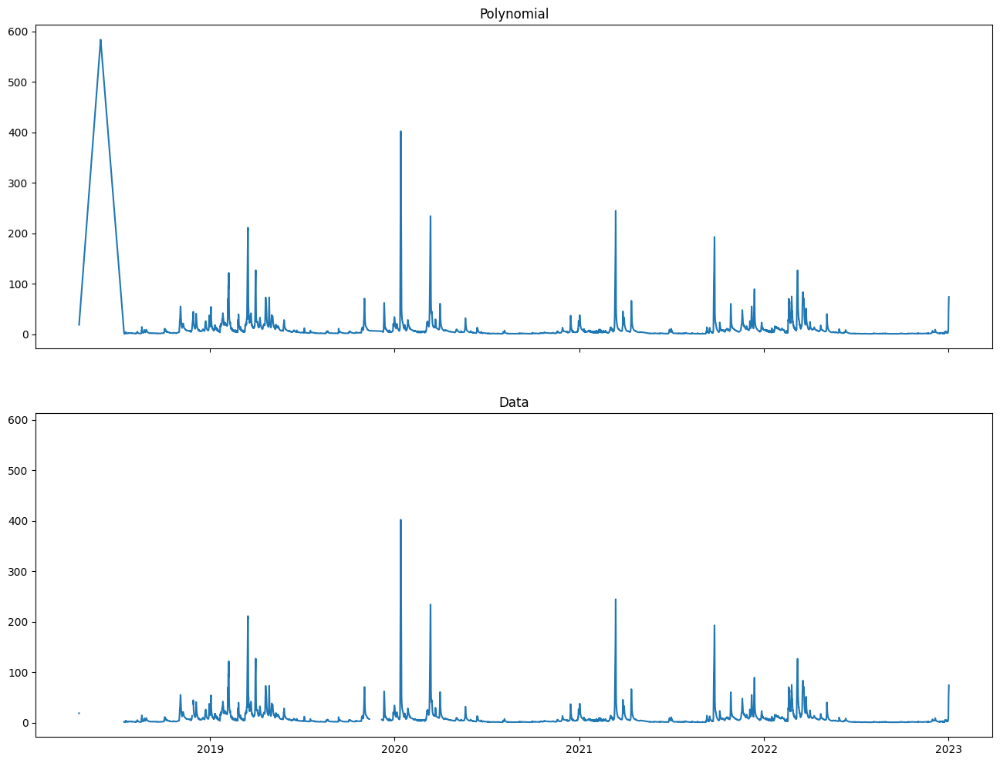

In [ ]:
river_flow_re = river_flow.iloc[:, 1].resample('T').mean()
#river_flow_re.interpolate(method='spline', order=3).plot(label= "Spline")
#river_flow.iloc[:, 3].plot()
fig, ax = plt.subplots(2, sharex='col', sharey='row', figsize= (16,12))

ax[0].plot(river_flow_re.interpolate(method='linear'))
ax[0].set(title='Polynomial')

ax[1].plot(river_flow.iloc[:, 1])
ax[1].set(title='Data')

Doubt on how to interpolate missing values for 2 locations with more than 10% missing values

I will drop the 2 locations with >10% missing values and interpolate the others with spline interpolation.

In [ ]:
river_flow.drop(columns= ["Aberfoyle", "Ayr"], inplace= True)

In [ ]:
river_flow

,BlairCreek,Bridgeport,BridgeportWQ,Doon,Drayton,Elmira,Erbsville,Floradale,Keldon,Leggatt,MillCreek,Moorefield,Phillipsburg,Road32,VictoriaRoad,Waldemar,WillowBrook,York
Timestamp,,,,,,,,,,,,,,,,,,
2018-01-01 00:00:00,0.162000,44.202684,26.932000,15.136015,1.633473,0.6800,0.135527,1.028997,1.207453,2.940143,0.898000,0.883397,2.394857,3.568644,1.059240,6.571770,1.142622,56.884066
2018-01-01 01:00:00,0.162000,44.040912,26.825400,15.150000,1.611479,0.6800,0.135047,1.022004,1.223004,2.957151,0.902000,0.887479,2.416549,3.634335,1.066568,6.589006,1.123353,55.332323
2018-01-01 02:00:00,0.162250,44.404860,26.710600,15.163985,1.615141,0.6800,0.135527,1.031338,1.230818,2.962889,0.898000,0.887479,2.387635,3.688094,1.051899,6.554596,1.156076,54.987491
2018-01-01 03:00:00,0.156458,44.040912,26.620400,15.177970,1.607817,0.6800,0.136970,1.012669,1.230835,2.957201,0.902000,0.888838,2.380400,3.697868,1.055549,6.545890,1.156076,54.987491
2018-01-01 04:00:00,0.149000,44.121798,26.612200,15.191955,1.589485,0.6800,0.135047,1.015000,1.223056,2.957189,0.902000,0.888838,2.344251,3.683207,1.059232,6.537265,1.156076,54.987491
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-01-01 19:00:00,6.112500,63.906250,66.752000,69.145801,44.066383,3.1520,0.462402,1.120000,11.259375,27.373467,2.099606,13.084098,61.677028,6.587513,0.456600,26.698283,1.973442,70.339806
2023-01-01 20:00:00,6.677500,62.625000,65.328000,67.147994,42.725918,3.1205,0.433461,0.785667,10.779167,26.982467,2.065631,12.854528,58.653723,6.661228,0.456600,26.765158,2.023615,77.500000
2023-01-01 21:00:00,6.511250,61.468750,63.942500,66.370603,41.430100,3.0890,0.410553,0.913646,10.689583,26.656740,2.033860,12.601612,55.564362,6.686446,0.456600,26.984320,2.150197,86.687500


In [ ]:
river_flow_linear  = river_flow.interpolate(method= "linear")

In [ ]:
river_flow_spline3  = river_flow.interpolate(method= "spline", order= 3)

In [ ]:
river_flow_spline2  = river_flow.interpolate(method= "spline", order= 2)

In [ ]:
river_flow_spline2

,BlairCreek,Bridgeport,BridgeportWQ,Doon,Drayton,Elmira,Erbsville,Floradale,Keldon,Leggatt,MillCreek,Moorefield,Phillipsburg,Road32,VictoriaRoad,Waldemar,WillowBrook,York
Timestamp,,,,,,,,,,,,,,,,,,
2018-01-01 00:00:00,0.162000,44.202684,26.932000,15.136015,1.633473,0.6800,0.135527,1.028997,1.207453,2.940143,0.898000,0.883397,2.394857,3.568644,1.059240,6.571770,1.142622,56.884066
2018-01-01 01:00:00,0.162000,44.040912,26.825400,15.150000,1.611479,0.6800,0.135047,1.022004,1.223004,2.957151,0.902000,0.887479,2.416549,3.634335,1.066568,6.589006,1.123353,55.332323
2018-01-01 02:00:00,0.162250,44.404860,26.710600,15.163985,1.615141,0.6800,0.135527,1.031338,1.230818,2.962889,0.898000,0.887479,2.387635,3.688094,1.051899,6.554596,1.156076,54.987491
2018-01-01 03:00:00,0.156458,44.040912,26.620400,15.177970,1.607817,0.6800,0.136970,1.012669,1.230835,2.957201,0.902000,0.888838,2.380400,3.697868,1.055549,6.545890,1.156076,54.987491
2018-01-01 04:00:00,0.149000,44.121798,26.612200,15.191955,1.589485,0.6800,0.135047,1.015000,1.223056,2.957189,0.902000,0.888838,2.344251,3.683207,1.059232,6.537265,1.156076,54.987491
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-01-01 19:00:00,6.112500,63.906250,66.752000,69.145801,44.066383,3.1520,0.462402,1.120000,11.259375,27.373467,2.099606,13.084098,61.677028,6.587513,0.456600,26.698283,1.973442,70.339806
2023-01-01 20:00:00,6.677500,62.625000,65.328000,67.147994,42.725918,3.1205,0.433461,0.785667,10.779167,26.982467,2.065631,12.854528,58.653723,6.661228,0.456600,26.765158,2.023615,77.500000
2023-01-01 21:00:00,6.511250,61.468750,63.942500,66.370603,41.430100,3.0890,0.410553,0.913646,10.689583,26.656740,2.033860,12.601612,55.564362,6.686446,0.456600,26.984320,2.150197,86.687500


In [ ]:
river_flow_linear

,BlairCreek,Bridgeport,BridgeportWQ,Doon,Drayton,Elmira,Erbsville,Floradale,Keldon,Leggatt,MillCreek,Moorefield,Phillipsburg,Road32,VictoriaRoad,Waldemar,WillowBrook,York
Timestamp,,,,,,,,,,,,,,,,,,
2018-01-01 00:00:00,0.162000,44.202684,26.932000,15.136015,1.633473,0.6800,0.135527,1.028997,1.207453,2.940143,0.898000,0.883397,2.394857,3.568644,1.059240,6.571770,1.142622,56.884066
2018-01-01 01:00:00,0.162000,44.040912,26.825400,15.150000,1.611479,0.6800,0.135047,1.022004,1.223004,2.957151,0.902000,0.887479,2.416549,3.634335,1.066568,6.589006,1.123353,55.332323
2018-01-01 02:00:00,0.162250,44.404860,26.710600,15.163985,1.615141,0.6800,0.135527,1.031338,1.230818,2.962889,0.898000,0.887479,2.387635,3.688094,1.051899,6.554596,1.156076,54.987491
2018-01-01 03:00:00,0.156458,44.040912,26.620400,15.177970,1.607817,0.6800,0.136970,1.012669,1.230835,2.957201,0.902000,0.888838,2.380400,3.697868,1.055549,6.545890,1.156076,54.987491
2018-01-01 04:00:00,0.149000,44.121798,26.612200,15.191955,1.589485,0.6800,0.135047,1.015000,1.223056,2.957189,0.902000,0.888838,2.344251,3.683207,1.059232,6.537265,1.156076,54.987491
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-01-01 19:00:00,6.112500,63.906250,66.752000,69.145801,44.066383,3.1520,0.462402,1.120000,11.259375,27.373467,2.099606,13.084098,61.677028,6.587513,0.456600,26.698283,1.973442,70.339806
2023-01-01 20:00:00,6.677500,62.625000,65.328000,67.147994,42.725918,3.1205,0.433461,0.785667,10.779167,26.982467,2.065631,12.854528,58.653723,6.661228,0.456600,26.765158,2.023615,77.500000
2023-01-01 21:00:00,6.511250,61.468750,63.942500,66.370603,41.430100,3.0890,0.410553,0.913646,10.689583,26.656740,2.033860,12.601612,55.564362,6.686446,0.456600,26.984320,2.150197,86.687500


In [ ]:
#Percentage of Missing values
l = len(river_flow)
for i in range(1, len(river_flow.columns)):
  m = river_flow_spline2.iloc[ : , i].isin([np.nan]).sum(axis= 0)
  p = 100*m/l
  print(river_flow_spline2.columns[i], "         ", p)

Bridgeport           0.0
BridgeportWQ           0.0
Doon           0.0
Drayton           0.0
Elmira           0.0
Erbsville           0.0
Floradale           0.0
Keldon           0.0
Leggatt           0.0
MillCreek           0.0
Moorefield           0.0
Phillipsburg           0.0
Road32           0.0
VictoriaRoad           0.0
Waldemar           0.0
WillowBrook           0.0
York           0.0


In [ ]:
#Percentage of Missing values
l = len(river_flow)
for i in range(1, len(river_flow.columns)):
  m = river_flow_linear.iloc[ : , i].isin([np.nan]).sum(axis= 0)
  p = 100*m/l
  print(river_flow_spline2.columns[i], "         ", p)

Bridgeport           0.0
BridgeportWQ           0.0
Doon           0.0
Drayton           0.0
Elmira           0.0
Erbsville           0.0
Floradale           0.0
Keldon           0.0
Leggatt           0.0
MillCreek           0.0
Moorefield           0.0
Phillipsburg           0.0
Road32           0.0
VictoriaRoad           0.0
Waldemar           0.0
WillowBrook           0.0
York           0.0


In [ ]:
#Checking for negative values as decomposition does not work with negative and zero values
river_flow_spline2[river_flow_spline2 < 0].sum()

BlairCreek           0.000000
Bridgeport           0.000000
BridgeportWQ        -3.659529
Doon                 0.000000
Drayton             -0.008635
Elmira             -12.765072
Erbsville            0.000000
Floradale            0.000000
Keldon             -11.457346
Leggatt              0.000000
MillCreek           -1.757368
Moorefield     -729826.752625
Phillipsburg         0.000000
Road32               0.000000
VictoriaRoad         0.000000
Waldemar             0.000000
WillowBrook         -0.230879
York                 0.000000
dtype: float64

In [ ]:
river_flow_spline2[river_flow_spline2 < 0].count()

BlairCreek        0
Bridgeport        0
BridgeportWQ      6
Doon              0
Drayton           5
Elmira           34
Erbsville         0
Floradale         0
Keldon           67
Leggatt           0
MillCreek         5
Moorefield      468
Phillipsburg      0
Road32            0
VictoriaRoad      0
Waldemar          0
WillowBrook       2
York              0
dtype: int64

In [ ]:
#Checking for negative values as decomposition does not work with negative and zero values
river_flow_linear[river_flow_linear < 0].sum()

BlairCreek      0.000000
Bridgeport      0.000000
BridgeportWQ    0.000000
Doon            0.000000
Drayton        -0.008635
Elmira          0.000000
Erbsville       0.000000
Floradale       0.000000
Keldon          0.000000
Leggatt         0.000000
MillCreek      -4.583625
Moorefield      0.000000
Phillipsburg    0.000000
Road32          0.000000
VictoriaRoad    0.000000
Waldemar        0.000000
WillowBrook     0.000000
York            0.000000
dtype: float64

In [ ]:
river_flow_linear[river_flow_linear < 0].count()

BlairCreek       0
Bridgeport       0
BridgeportWQ     0
Doon             0
Drayton          5
Elmira           0
Erbsville        0
Floradale        0
Keldon           0
Leggatt          0
MillCreek       17
Moorefield       0
Phillipsburg     0
Road32           0
VictoriaRoad     0
Waldemar         0
WillowBrook      0
York             0
dtype: int64

In [ ]:
river_flow_linear["Drayton"][river_flow_linear["Drayton"] < 0]

Timestamp
2018-08-06 18:00:00   -0.001724
2018-08-06 19:00:00   -0.002303
2018-08-06 20:00:00   -0.002304
2018-08-06 21:00:00   -0.000003
2018-08-06 22:00:00   -0.002301
Name: Drayton, dtype: float64

In [ ]:
river_flow_linear.loc['2018-08-06 01:00:00': '2018-08-07 23:00:00', "Drayton"]

Timestamp
2018-08-06 01:00:00    0.002303
2018-08-06 02:00:00    0.001154
2018-08-06 03:00:00    0.002304
2018-08-06 04:00:00    0.001154
2018-08-06 05:00:00    0.001153
2018-08-06 06:00:00    0.001728
2018-08-06 07:00:00    0.001153
2018-08-06 08:00:00    0.001153
2018-08-06 09:00:00    0.002304
2018-08-06 10:00:00    0.001154
2018-08-06 11:00:00    0.002302
2018-08-06 12:00:00    0.001729
2018-08-06 13:00:00    0.001728
2018-08-06 14:00:00    0.002305
2018-08-06 15:00:00    0.002880
2018-08-06 16:00:00    0.001730
2018-08-06 17:00:00    0.001728
2018-08-06 18:00:00   -0.001724
2018-08-06 19:00:00   -0.002303
2018-08-06 20:00:00   -0.002304
2018-08-06 21:00:00   -0.000003
2018-08-06 22:00:00   -0.002301
2018-08-06 23:00:00    0.001149
2018-08-07 00:00:00    0.001153
2018-08-07 01:00:00    0.002304
2018-08-07 02:00:00    0.002305
2018-08-07 03:00:00    0.002305
2018-08-07 04:00:00    0.029353
2018-08-07 05:00:00    0.037439
2018-08-07 06:00:00    0.029967
2018-08-07 07:00:00    0.01960

In [ ]:
river_flow_linear["MillCreek"][river_flow_linear["MillCreek"] < 0]

Timestamp
2022-10-15 16:00:00   -0.356120
2022-10-27 19:00:00   -0.190540
2022-10-27 20:00:00   -0.397126
2022-10-27 21:00:00   -0.307015
2022-10-30 14:00:00   -0.506566
2022-10-30 15:00:00   -0.464867
2022-10-30 16:00:00   -0.423168
2022-10-30 17:00:00   -0.381469
2022-10-30 18:00:00   -0.339770
2022-10-30 19:00:00   -0.298070
2022-10-30 20:00:00   -0.256371
2022-10-30 21:00:00   -0.214672
2022-10-30 22:00:00   -0.172973
2022-10-30 23:00:00   -0.131273
2022-10-31 00:00:00   -0.089574
2022-10-31 01:00:00   -0.047875
2022-10-31 02:00:00   -0.006176
Name: MillCreek, dtype: float64

In [ ]:
river_flow_linear.loc['2022-10-15 00:00:00': '2022-10-15 23:00:00', "MillCreek"]

Timestamp
2022-10-15 00:00:00    0.394921
2022-10-15 01:00:00    0.394099
2022-10-15 02:00:00    0.393085
2022-10-15 03:00:00    0.392059
2022-10-15 04:00:00    0.391473
2022-10-15 05:00:00    0.389020
2022-10-15 06:00:00    0.387790
2022-10-15 07:00:00    0.385033
2022-10-15 08:00:00    0.382131
2022-10-15 09:00:00    0.378447
2022-10-15 10:00:00    0.372210
2022-10-15 11:00:00    0.368017
2022-10-15 12:00:00    0.368000
2022-10-15 13:00:00    0.368140
2022-10-15 14:00:00    0.294282
2022-10-15 15:00:00    0.150299
2022-10-15 16:00:00   -0.356120
2022-10-15 17:00:00    0.251911
2022-10-15 18:00:00    0.374026
2022-10-15 19:00:00    0.375912
2022-10-15 20:00:00    0.375982
2022-10-15 21:00:00    0.375860
2022-10-15 22:00:00    0.375649
2022-10-15 23:00:00    0.375632
Name: MillCreek, dtype: float64

In [ ]:
river_flow_linear.loc['2022-10-27 00:00:00': '2022-10-27 23:00:00', "MillCreek"]

Timestamp
2022-10-27 00:00:00    0.459132
2022-10-27 01:00:00    0.459000
2022-10-27 02:00:00    0.459000
2022-10-27 03:00:00    0.457638
2022-10-27 04:00:00    0.455934
2022-10-27 05:00:00    0.456000
2022-10-27 06:00:00    0.451040
2022-10-27 07:00:00    0.447658
2022-10-27 08:00:00    0.444746
2022-10-27 09:00:00    0.442088
2022-10-27 10:00:00    0.442000
2022-10-27 11:00:00    0.441140
2022-10-27 12:00:00    0.440131
2022-10-27 13:00:00    0.438518
2022-10-27 14:00:00    0.437132
2022-10-27 15:00:00    0.373669
2022-10-27 16:00:00    0.296804
2022-10-27 17:00:00    0.212630
2022-10-27 18:00:00    0.016045
2022-10-27 19:00:00   -0.190540
2022-10-27 20:00:00   -0.397126
2022-10-27 21:00:00   -0.307015
2022-10-27 22:00:00    0.451158
2022-10-27 23:00:00    0.449974
Name: MillCreek, dtype: float64

In [ ]:
river_flow_linear.loc['2022-10-30 01:00:00': '2022-10-31 23:00:00', "MillCreek"]

Timestamp
2022-10-30 01:00:00    0.425798
2022-10-30 02:00:00    0.425930
2022-10-30 03:00:00    0.426000
2022-10-30 04:00:00    0.426035
2022-10-30 05:00:00    0.426000
2022-10-30 06:00:00    0.421053
2022-10-30 07:00:00    0.418456
2022-10-30 08:00:00    0.417965
2022-10-30 09:00:00    0.416272
2022-10-30 10:00:00    0.417027
2022-10-30 11:00:00    0.422947
2022-10-30 12:00:00    0.434500
2022-10-30 13:00:00    0.032746
2022-10-30 14:00:00   -0.506566
2022-10-30 15:00:00   -0.464867
2022-10-30 16:00:00   -0.423168
2022-10-30 17:00:00   -0.381469
2022-10-30 18:00:00   -0.339770
2022-10-30 19:00:00   -0.298070
2022-10-30 20:00:00   -0.256371
2022-10-30 21:00:00   -0.214672
2022-10-30 22:00:00   -0.172973
2022-10-30 23:00:00   -0.131273
2022-10-31 00:00:00   -0.089574
2022-10-31 01:00:00   -0.047875
2022-10-31 02:00:00   -0.006176
2022-10-31 03:00:00    0.035524
2022-10-31 04:00:00    0.077223
2022-10-31 05:00:00    0.118922
2022-10-31 06:00:00    0.160621
2022-10-31 07:00:00    0.20232

It can be seen that the negative values after linear interpolation are very less and all are near to zero. So we can compute a mean value for the day and replace it with the negative value.

<u>For MillCreek:</u><br>
it can be seen that the values for 2022-10-30 13:00:00 and for 2022-10-31 03:00:00 and the next hour are very less as compared to the other values of the day. So for changing the negative values, I will take mean of the three values of 2022-10-30 13:00:00 , 2022-10-31 03:00:00 and 2022-10-31 04:00:00 and use that. For 2022-10-15 and 2022-10-27 negative values, I will take the mean for the day and use it.

<u>For Drayton:</u><br>
It can be seen that almost all the values for 2018-08-06 and 2018-08-07 are similar. So I took mean for the two days and then used it.

In [ ]:
drayton_mean_for_negative_values = river_flow_linear.loc['2018-08-06 01:00:00': '2018-08-07 23:00:00', "Drayton"].values.mean()
drayton_mean_for_negative_values

0.01740454634042553

In [ ]:
millCreek_mean_for_negative_values_3031 = (river_flow_linear.loc['2022-10-30 13:00:00', "MillCreek"] + river_flow_linear.loc['2022-10-31 03:00:00', "MillCreek"] + river_flow_linear.loc["2022-10-31 04:00:00", "MillCreek"])/3
millCreek_mean_for_negative_values_3031

0.048497555101449284

In [ ]:
millCreek_mean_for_negative_values_15 = river_flow_linear.loc["2022-10-15 00:00:00" : "2022-10-15 23:00:00", "MillCreek"].values.mean()
millCreek_mean_for_negative_values_27 = river_flow_linear.loc["2022-10-27 00:00:00" : "2022-10-27 23:00:00", "MillCreek"].values.mean()

In [ ]:
river_flow.interpolate(method= "linear", inplace= True)

In [ ]:
river_flow[river_flow < 0].count()

BlairCreek       0
Bridgeport       0
BridgeportWQ     0
Doon             0
Drayton          5
Elmira           0
Erbsville        0
Floradale        0
Keldon           0
Leggatt          0
MillCreek       17
Moorefield       0
Phillipsburg     0
Road32           0
VictoriaRoad     0
Waldemar         0
WillowBrook      0
York             0
dtype: int64

In [ ]:
river_flow.loc["2022-10-15 00:00:00", "MillCreek"] = millCreek_mean_for_negative_values_15
river_flow.loc["2022-10-27 19:00:00" : "2022-10-27 22:00:00", "MillCreek"] = millCreek_mean_for_negative_values_27

In [ ]:
river_flow["MillCreek"][river_flow["MillCreek"] < 0].count()

14

In [ ]:
#Fixing negative values of Mill Creek
river_flow["MillCreek"][river_flow["MillCreek"] < 0] = millCreek_mean_for_negative_values_3031

In [ ]:
river_flow[river_flow < 0].count()

BlairCreek      0
Bridgeport      0
BridgeportWQ    0
Doon            0
Drayton         5
Elmira          0
Erbsville       0
Floradale       0
Keldon          0
Leggatt         0
MillCreek       0
Moorefield      0
Phillipsburg    0
Road32          0
VictoriaRoad    0
Waldemar        0
WillowBrook     0
York            0
dtype: int64

In [ ]:
#Fixing negative values of Drayton
river_flow["Drayton"][river_flow["Drayton"] < 0] = drayton_mean_for_negative_values

In [ ]:
river_flow[river_flow < 0].count()

BlairCreek      0
Bridgeport      0
BridgeportWQ    0
Doon            0
Drayton         0
Elmira          0
Erbsville       0
Floradale       0
Keldon          0
Leggatt         0
MillCreek       0
Moorefield      0
Phillipsburg    0
Road32          0
VictoriaRoad    0
Waldemar        0
WillowBrook     0
York            0
dtype: int64

There are no negative values now.

Now checking for zero values.

In [ ]:
river_flow[river_flow == 0].count()

BlairCreek        0
Bridgeport        0
BridgeportWQ      0
Doon              0
Drayton           0
Elmira            1
Erbsville         0
Floradale       311
Keldon            0
Leggatt           0
MillCreek         0
Moorefield        0
Phillipsburg      0
Road32            0
VictoriaRoad      0
Waldemar          0
WillowBrook       0
York              0
dtype: int64

In [ ]:
river_flow["Floradale"][river_flow["Floradale"] == 0].index

DatetimeIndex(['2021-09-07 17:00:00', '2021-09-07 18:00:00',
               '2021-09-07 19:00:00', '2021-09-07 20:00:00',
               '2021-09-07 21:00:00', '2021-09-07 23:00:00',
               '2021-09-09 04:00:00', '2021-09-09 05:00:00',
               '2021-09-09 06:00:00', '2021-09-09 07:00:00',
               ...
               '2021-09-21 18:00:00', '2021-09-21 19:00:00',
               '2021-09-21 20:00:00', '2021-09-21 21:00:00',
               '2021-09-21 22:00:00', '2021-09-21 23:00:00',
               '2021-09-22 00:00:00', '2021-09-22 01:00:00',
               '2021-09-22 02:00:00', '2021-09-22 03:00:00'],
              dtype='datetime64[ns]', name='Timestamp', length=311, freq=None)

In [ ]:
river_flow["Elmira"][river_flow["Elmira"] == 0]

Timestamp
2018-09-12 19:00:00    0.0
Name: Elmira, dtype: float64

In [ ]:
river_flow.loc["2018-09-12 00:00:00": "2018-09-12 23:00:00", "Elmira"]

Timestamp
2018-09-12 00:00:00    0.482595
2018-09-12 01:00:00    0.478335
2018-09-12 02:00:00    0.476998
2018-09-12 03:00:00    0.478335
2018-09-12 04:00:00    0.481110
2018-09-12 05:00:00    0.479667
2018-09-12 06:00:00    0.478335
2018-09-12 07:00:00    0.476998
2018-09-12 08:00:00    0.476998
2018-09-12 09:00:00    0.476998
2018-09-12 10:00:00    0.479667
2018-09-12 11:00:00    0.397002
2018-09-12 12:00:00    0.406335
2018-09-12 13:00:00    0.388890
2018-09-12 14:00:00    0.388890
2018-09-12 15:00:00    0.387405
2018-09-12 16:00:00    0.388890
2018-09-12 17:00:00    0.407667
2018-09-12 18:00:00    0.426333
2018-09-12 19:00:00    0.000000
2018-09-12 20:00:00    0.388890
2018-09-12 21:00:00    0.387405
2018-09-12 22:00:00    0.388890
2018-09-12 23:00:00    0.387405
Name: Elmira, dtype: float64

There are two columns with zero values i.e., Floradale and Elmira. I will change the zero value in Elmira with the mean value for the day as only one value is zero. For Floradale, I will drop the column as of now

In [ ]:
river_flow["Elmira"][river_flow["Elmira"] == 0] = river_flow.loc["2018-09-12 00:00:00": "2018-09-12 23:00:00", "Elmira"].values.mean()

In [ ]:
river_flow.drop(columns= ["Floradale"], inplace= True)

In [ ]:
river_flow

,BlairCreek,Bridgeport,BridgeportWQ,Doon,Drayton,Elmira,Erbsville,Keldon,Leggatt,MillCreek,Moorefield,Phillipsburg,Road32,VictoriaRoad,Waldemar,WillowBrook,York
Timestamp,,,,,,,,,,,,,,,,,
2018-01-01 00:00:00,0.162000,44.202684,26.932000,15.136015,1.633473,0.6800,0.135527,1.207453,2.940143,0.898000,0.883397,2.394857,3.568644,1.059240,6.571770,1.142622,56.884066
2018-01-01 01:00:00,0.162000,44.040912,26.825400,15.150000,1.611479,0.6800,0.135047,1.223004,2.957151,0.902000,0.887479,2.416549,3.634335,1.066568,6.589006,1.123353,55.332323
2018-01-01 02:00:00,0.162250,44.404860,26.710600,15.163985,1.615141,0.6800,0.135527,1.230818,2.962889,0.898000,0.887479,2.387635,3.688094,1.051899,6.554596,1.156076,54.987491
2018-01-01 03:00:00,0.156458,44.040912,26.620400,15.177970,1.607817,0.6800,0.136970,1.230835,2.957201,0.902000,0.888838,2.380400,3.697868,1.055549,6.545890,1.156076,54.987491
2018-01-01 04:00:00,0.149000,44.121798,26.612200,15.191955,1.589485,0.6800,0.135047,1.223056,2.957189,0.902000,0.888838,2.344251,3.683207,1.059232,6.537265,1.156076,54.987491
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-01-01 19:00:00,6.112500,63.906250,66.752000,69.145801,44.066383,3.1520,0.462402,11.259375,27.373467,2.099606,13.084098,61.677028,6.587513,0.456600,26.698283,1.973442,70.339806
2023-01-01 20:00:00,6.677500,62.625000,65.328000,67.147994,42.725918,3.1205,0.433461,10.779167,26.982467,2.065631,12.854528,58.653723,6.661228,0.456600,26.765158,2.023615,77.500000
2023-01-01 21:00:00,6.511250,61.468750,63.942500,66.370603,41.430100,3.0890,0.410553,10.689583,26.656740,2.033860,12.601612,55.564362,6.686446,0.456600,26.984320,2.150197,86.687500


In [ ]:
river_flow[river_flow == 0].count()

BlairCreek      0
Bridgeport      0
BridgeportWQ    0
Doon            0
Drayton         0
Elmira          0
Erbsville       0
Keldon          0
Leggatt         0
MillCreek       0
Moorefield      0
Phillipsburg    0
Road32          0
VictoriaRoad    0
Waldemar        0
WillowBrook     0
York            0
dtype: int64

In [ ]:
river_flow[river_flow == np.nan].count()

BlairCreek      0
Bridgeport      0
BridgeportWQ    0
Doon            0
Drayton         0
Elmira          0
Erbsville       0
Keldon          0
Leggatt         0
MillCreek       0
Moorefield      0
Phillipsburg    0
Road32          0
VictoriaRoad    0
Waldemar        0
WillowBrook     0
York            0
dtype: int64

In [ ]:
river_flow[river_flow < 0].count()

BlairCreek      0
Bridgeport      0
BridgeportWQ    0
Doon            0
Drayton         0
Elmira          0
Erbsville       0
Keldon          0
Leggatt         0
MillCreek       0
Moorefield      0
Phillipsburg    0
Road32          0
VictoriaRoad    0
Waldemar        0
WillowBrook     0
York            0
dtype: int64

Now, there are no negative values, so we can move forward with decomposition of the time series.

# **Decomposition of Time Series**

In [ ]:
#Decomposition of Time Series
from statsmodels.tsa.seasonal import seasonal_decompose
from dateutil.parser import parse

In [ ]:
#Daily decomposition for all the 17 locations in the dataset

for i in range(0, len(river_flow.columns)):
  #Multiplicative Decomposition
  multiplicative_decomposition = seasonal_decompose(river_flow.iloc[: , i], model= 'multiplicative', period= 24)

  #Additive Decomposition
  additive_decomposition = seasonal_decompose(river_flow.iloc[: , i], model= "additive", period= 24)

  plt.rcParams.update({"figure.figsize": (16, 12)})
  multiplicative_decomposition.plot().suptitle("Multiplicative Decomposition", fontsize= 16)
  plt.tight_layout(rect= [0, 0.03, 1, 0.95])

  additive_decomposition.plot().suptitle("Additive Decomposition", fontsize= 16)
  plt.tight_layout(rect= [0, 0.03, 1, 0.95])

  plt.show()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
#Weekly decomposition for all the 14 locations in the dataset

#Decomposition of Time Series
for i in range(0, len(river_flow.columns)):
  #Multiplicative Decomposition
  multiplicative_decomposition = seasonal_decompose(river_flow.iloc[: , i], model= 'multiplicative', period= 168)

  #Additive Decomposition
  additive_decomposition = seasonal_decompose(river_flow.iloc[: , i], model= "additive", period= 168)

  plt.rcParams.update({"figure.figsize": (16, 12)})
  multiplicative_decomposition.plot().suptitle("Multiplicative Decomposition", fontsize= 16)
  plt.tight_layout(rect= [0, 0.03, 1, 0.95])

  additive_decomposition.plot().suptitle("Additive Decomposition", fontsize= 16)
  plt.tight_layout(rect= [0, 0.03, 1, 0.95])

  plt.show()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
#Monthly decomposition for all the 14 locations in the dataset

#Decomposition of Time Series
for i in range(0, len(river_flow.columns)):
  #Multiplicative Decomposition
  multiplicative_decomposition = seasonal_decompose(river_flow.iloc[: , i], model= 'multiplicative', period= 720)

  #Additive Decomposition
  additive_decomposition = seasonal_decompose(river_flow.iloc[: , i], model= "additive", period= 720)

  plt.rcParams.update({"figure.figsize": (16, 12)})
  multiplicative_decomposition.plot().suptitle("Multiplicative Decomposition", fontsize= 16)
  plt.tight_layout(rect= [0, 0.03, 1, 0.95])

  additive_decomposition.plot().suptitle("Additive Decomposition", fontsize= 16)
  plt.tight_layout(rect= [0, 0.03, 1, 0.95])

  plt.show()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
#Quarterly decomposition for all the 14 locations in the dataset

#Decomposition of Time Series
for i in range(0, len(river_flow.columns)):
  #Multiplicative Decomposition
  multiplicative_decomposition = seasonal_decompose(river_flow.iloc[: , i], model= 'multiplicative', period= 2160)

  #Additive Decomposition
  additive_decomposition = seasonal_decompose(river_flow.iloc[: , i], model= "additive", period= 2160)

  plt.rcParams.update({"figure.figsize": (16, 12)})
  multiplicative_decomposition.plot().suptitle("Multiplicative Decomposition", fontsize= 16)
  plt.tight_layout(rect= [0, 0.03, 1, 0.95])

  additive_decomposition.plot().suptitle("Additive Decomposition", fontsize= 16)
  plt.tight_layout(rect= [0, 0.03, 1, 0.95])

  plt.show()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
#half-yearly decomposition for all the 14 locations in the dataset

#Decomposition of Time Series
for i in range(0, len(river_flow.columns)):
  #Multiplicative Decomposition
  multiplicative_decomposition = seasonal_decompose(river_flow.iloc[: , i], model= 'multiplicative', period= 4320)

  #Additive Decomposition
  additive_decomposition = seasonal_decompose(river_flow.iloc[: , i], model= "additive", period= 4320)

  plt.rcParams.update({"figure.figsize": (16, 12)})
  multiplicative_decomposition.plot().suptitle("Multiplicative Decomposition", fontsize= 16)
  plt.tight_layout(rect= [0, 0.03, 1, 0.95])

  additive_decomposition.plot().suptitle("Additive Decomposition", fontsize= 16)
  plt.tight_layout(rect= [0, 0.03, 1, 0.95])

  plt.show()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
#yearly decomposition for all the 14 locations in the dataset

#Decomposition of Time Series
for i in range(0, len(river_flow.columns)):
  #Multiplicative Decomposition
  multiplicative_decomposition = seasonal_decompose(river_flow.iloc[: , i], model= 'multiplicative', period= 8640)

  #Additive Decomposition
  additive_decomposition = seasonal_decompose(river_flow.iloc[: , i], model= "additive", period= 8640)

  plt.rcParams.update({"figure.figsize": (16, 12)})
  multiplicative_decomposition.plot().suptitle("Multiplicative Decomposition", fontsize= 16)
  plt.tight_layout(rect= [0, 0.03, 1, 0.95])

  additive_decomposition.plot().suptitle("Additive Decomposition", fontsize= 16)
  plt.tight_layout(rect= [0, 0.03, 1, 0.95])

  plt.show()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
#2.5 year decomposition for all the 14 locations in the dataset

#Decomposition of Time Series
for i in range(0, len(river_flow.columns)):
  #Multiplicative Decomposition
  multiplicative_decomposition = seasonal_decompose(river_flow.iloc[: , i], model= 'multiplicative', period= 21924)

  #Additive Decomposition
  additive_decomposition = seasonal_decompose(river_flow.iloc[: , i], model= "additive", period= 21924)

  plt.rcParams.update({"figure.figsize": (16, 12)})
  multiplicative_decomposition.plot().suptitle("Multiplicative Decomposition", fontsize= 16)
  plt.tight_layout(rect= [0, 0.03, 1, 0.95])

  additive_decomposition.plot().suptitle("Additive Decomposition", fontsize= 16)
  plt.tight_layout(rect= [0, 0.03, 1, 0.95])

  plt.show()

Output hidden; open in https://colab.research.google.com to view.

# **Tranformation to Stationary Time Series**

Reasons to convert to a stationary time series:

1. Forecasting a stationary series is relatively easy and the forecasts are more reliable.
2. An important reason is, autoregressive forecasting models are essentially linear regression models that utilize the lag(s) of the series itself as predictors.
3. We know that linear regression works best if the predictors (X variables) are not correlated against each other. So, stationarizing the series solves this problem since it removes any persistent autocorrelation, thereby making the predictors(lags of the series) in the forecasting models nearly independent.




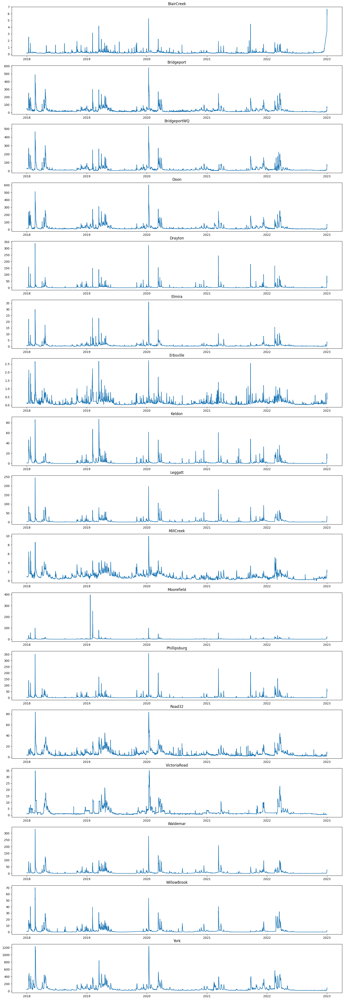

In [ ]:
fig, ax = plt.subplots(17, 1, figsize= (20, 60))

for i in range(0, len(river_flow.columns)):
  ax[i].plot(river_flow.iloc[: , i])
  ax[i].set(title=river_flow.columns[i])

Firstly, we need to check for stationarity. We can do this by observing plots. There are several quantitative methods we can use to determine if a given series is stationary or not. This can be done using statistical tests called **Unit Root Tests**.

There are multiple implementations of Unit Root tests like:
1. Augmented Dickey Fuller test (ADF Test)
2. Kwiatkowski-Phillip-Schmidt-Shin-KPSS Test (trend stationary)
3. Philips Perron test (PP test)

## **Augmented Dicker Fuller Test**

We calculate the p-value. If p-value < 0.05, then the time series is stationary, else it is not stationary.

In [ ]:
from statsmodels.tsa.stattools import adfuller

In [ ]:
river_flow

,BlairCreek,Bridgeport,BridgeportWQ,Doon,Drayton,Elmira,Erbsville,Keldon,Leggatt,MillCreek,Moorefield,Phillipsburg,Road32,VictoriaRoad,Waldemar,WillowBrook,York
Timestamp,,,,,,,,,,,,,,,,,
2018-01-01 00:00:00,0.162000,44.202684,26.932000,15.136015,1.633473,0.6800,0.135527,1.207453,2.940143,0.898000,0.883397,2.394857,3.568644,1.059240,6.571770,1.142622,56.884066
2018-01-01 01:00:00,0.162000,44.040912,26.825400,15.150000,1.611479,0.6800,0.135047,1.223004,2.957151,0.902000,0.887479,2.416549,3.634335,1.066568,6.589006,1.123353,55.332323
2018-01-01 02:00:00,0.162250,44.404860,26.710600,15.163985,1.615141,0.6800,0.135527,1.230818,2.962889,0.898000,0.887479,2.387635,3.688094,1.051899,6.554596,1.156076,54.987491
2018-01-01 03:00:00,0.156458,44.040912,26.620400,15.177970,1.607817,0.6800,0.136970,1.230835,2.957201,0.902000,0.888838,2.380400,3.697868,1.055549,6.545890,1.156076,54.987491
2018-01-01 04:00:00,0.149000,44.121798,26.612200,15.191955,1.589485,0.6800,0.135047,1.223056,2.957189,0.902000,0.888838,2.344251,3.683207,1.059232,6.537265,1.156076,54.987491
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-01-01 19:00:00,6.112500,63.906250,66.752000,69.145801,44.066383,3.1520,0.462402,11.259375,27.373467,2.099606,13.084098,61.677028,6.587513,0.456600,26.698283,1.973442,70.339806
2023-01-01 20:00:00,6.677500,62.625000,65.328000,67.147994,42.725918,3.1205,0.433461,10.779167,26.982467,2.065631,12.854528,58.653723,6.661228,0.456600,26.765158,2.023615,77.500000
2023-01-01 21:00:00,6.511250,61.468750,63.942500,66.370603,41.430100,3.0890,0.410553,10.689583,26.656740,2.033860,12.601612,55.564362,6.686446,0.456600,26.984320,2.150197,86.687500


In [ ]:
is_stationary = []
p_value = []
for i in range(0, len(river_flow.columns)):
  results = adfuller(river_flow.iloc[:, i].values, autolag= "AIC")
  print("For the location: ", river_flow.columns[i])
  print("Test-statistics: ", results[0])
  print("p-value: ", results[1])
  print("Critical Statistics: ", results[4])
  print("\n\n\n")
  p_value.append(results[1])
  is_stationary.append(1 if (results[1] < 0.05) else 0)

For the location:  BlairCreek
Test-statistics:  -9.27032493528828
p-value:  1.332207704934957e-15
Critical Statistics:  {'1%': -3.4304993282946503, '5%': -2.8616059998333285, '10%': -2.5668051295643513}




For the location:  Bridgeport
Test-statistics:  -12.467055824296551
p-value:  3.3076934081093656e-23
Critical Statistics:  {'1%': -3.430499287385995, '5%': -2.8616059817530544, '10%': -2.5668051199407302}




For the location:  BridgeportWQ
Test-statistics:  -12.903687711507448
p-value:  4.19616402737125e-24
Critical Statistics:  {'1%': -3.4304992805700647, '5%': -2.8616059787406383, '10%': -2.566805118337306}




For the location:  Doon
Test-statistics:  -12.252422370963613
p-value:  9.474042480187013e-23
Critical Statistics:  {'1%': -3.430499290794194, '5%': -2.8616059832593654, '10%': -2.5668051207424973}




For the location:  Drayton
Test-statistics:  -25.707751941803185
p-value:  0.0
Critical Statistics:  {'1%': -3.430499198827422, '5%': -2.8616059426130898, '10%': -2.56680509

In [ ]:
p_value

[1.332207704934957e-15,
 3.3076934081093656e-23,
 4.19616402737125e-24,
 9.474042480187013e-23,
 0.0,
 9.60320503938883e-30,
 2.6587089408948005e-27,
 1.1429924413175905e-26,
 4.7361826969680687e-29,
 7.069625007079494e-21,
 0.0,
 4.932266358316581e-30,
 9.926814914867721e-19,
 9.475362136140883e-17,
 1.0793119963505564e-26,
 9.408005495507935e-26,
 1.7169822099032536e-22]

In [ ]:
is_stationary

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]

Using the Augmented Dicker Fuller Test (ADF test), we can see that all the locations have stationary time series.

## **Kwiatkowski-Phillips-Schmidt-Shin Test**

This is used to test for trend stationary. In the statistical analysis of time series, a trend-stationary process is a stochastic process from which an underlying trend (function solely of time) can be removed, leaving just a stationary process.

The null hypothesis and the p-value is just the opposite of the ADF test. if p-value > 0.05, then the time series is stationary

In [ ]:
from statsmodels.tsa.stattools import kpss

In [ ]:
river_flow

,BlairCreek,Bridgeport,BridgeportWQ,Doon,Drayton,Elmira,Erbsville,Keldon,Leggatt,MillCreek,Moorefield,Phillipsburg,Road32,VictoriaRoad,Waldemar,WillowBrook,York
Timestamp,,,,,,,,,,,,,,,,,
2018-01-01 00:00:00,0.162000,44.202684,26.932000,15.136015,1.633473,0.6800,0.135527,1.207453,2.940143,0.898000,0.883397,2.394857,3.568644,1.059240,6.571770,1.142622,56.884066
2018-01-01 01:00:00,0.162000,44.040912,26.825400,15.150000,1.611479,0.6800,0.135047,1.223004,2.957151,0.902000,0.887479,2.416549,3.634335,1.066568,6.589006,1.123353,55.332323
2018-01-01 02:00:00,0.162250,44.404860,26.710600,15.163985,1.615141,0.6800,0.135527,1.230818,2.962889,0.898000,0.887479,2.387635,3.688094,1.051899,6.554596,1.156076,54.987491
2018-01-01 03:00:00,0.156458,44.040912,26.620400,15.177970,1.607817,0.6800,0.136970,1.230835,2.957201,0.902000,0.888838,2.380400,3.697868,1.055549,6.545890,1.156076,54.987491
2018-01-01 04:00:00,0.149000,44.121798,26.612200,15.191955,1.589485,0.6800,0.135047,1.223056,2.957189,0.902000,0.888838,2.344251,3.683207,1.059232,6.537265,1.156076,54.987491
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-01-01 19:00:00,6.112500,63.906250,66.752000,69.145801,44.066383,3.1520,0.462402,11.259375,27.373467,2.099606,13.084098,61.677028,6.587513,0.456600,26.698283,1.973442,70.339806
2023-01-01 20:00:00,6.677500,62.625000,65.328000,67.147994,42.725918,3.1205,0.433461,10.779167,26.982467,2.065631,12.854528,58.653723,6.661228,0.456600,26.765158,2.023615,77.500000
2023-01-01 21:00:00,6.511250,61.468750,63.942500,66.370603,41.430100,3.0890,0.410553,10.689583,26.656740,2.033860,12.601612,55.564362,6.686446,0.456600,26.984320,2.150197,86.687500


In [ ]:
def kpss_test(series, **kw):
    statistic, p_value, n_lags, critical_values = kpss(river_flow.iloc[:, 0].values, **kw)
    print(f'KPSS Statistic: {statistic}')
    print(f'p-value: {p_value}')
    print(f'num lags: {n_lags}')
    print('Critial Values:')
    for key, value in critical_values.items():
        print(f'   {key} : {value}')
    print(f'Result: The series is {"not " if p_value < 0.05 else ""}stationary')

In [ ]:
for i in range(0, len(river_flow.columns)):
  kpss_test(river_flow.iloc[:, i])
  print("\n\n")

KPSS Statistic: 0.4472584733792999
p-value: 0.05678514078478453
num lags: 119
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Result: The series is stationary



KPSS Statistic: 0.4472584733792999
p-value: 0.05678514078478453
num lags: 119
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Result: The series is stationary



KPSS Statistic: 0.4472584733792999
p-value: 0.05678514078478453
num lags: 119
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Result: The series is stationary



KPSS Statistic: 0.4472584733792999
p-value: 0.05678514078478453
num lags: 119
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Result: The series is stationary



KPSS Statistic: 0.4472584733792999
p-value: 0.05678514078478453
num lags: 119
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Result: The series is stationary



KPSS Statistic: 0.4472584733792999
p-value: 0.056785140

This test tells that all the locations have stationary time series.

## **Phillips-Perron**

This tests that a variable has a unit root or not. The null hypothesis is that the unit root is present. If p-value > 0.05, then null hypothesis is true and the series is non-stationary.

In [ ]:
!pip3 install arch

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 916.4/916.4 kB 13.3 MB/s eta 0:00:00


In [ ]:
from arch.unitroot import PhillipsPerron

In [ ]:
p_values = []
for i in range(0, len(river_flow.columns)):
  print("For ", river_flow.columns[i], ": ")
  pp = PhillipsPerron(river_flow.iloc[:, i].values)
  print(pp.summary().as_text())
  print("\n\n\n")
  p_values.append(pp.pvalue)

For  BlairCreek : 
     Phillips-Perron Test (Z-tau)    
Test Statistic                 -9.274
P-value                         0.000
Lags                               55
-------------------------------------

Trend: Constant
Critical Values: -3.43 (1%), -2.86 (5%), -2.57 (10%)
Null Hypothesis: The process contains a unit root.
Alternative Hypothesis: The process is weakly stationary.




For  Bridgeport : 
     Phillips-Perron Test (Z-tau)    
Test Statistic                -12.082
P-value                         0.000
Lags                               55
-------------------------------------

Trend: Constant
Critical Values: -3.43 (1%), -2.86 (5%), -2.57 (10%)
Null Hypothesis: The process contains a unit root.
Alternative Hypothesis: The process is weakly stationary.




For  BridgeportWQ : 
     Phillips-Perron Test (Z-tau)    
Test Statistic                -12.391
P-value                         0.000
Lags                               55
-------------------------------------

Tren

In [ ]:
p_values

[1.3061836168439845e-15,
 2.218529439384694e-22,
 4.7975745374010444e-23,
 3.3268158206316776e-22,
 2.4415875006167904e-30,
 3.6414772534848226e-29,
 3.545553198485662e-28,
 2.9904531344240686e-28,
 4.142467391441138e-29,
 3.4145214516212433e-22,
 0.0,
 4.6323056436252896e-30,
 1.7192240920459716e-17,
 4.830378958151812e-18,
 6.097339957223282e-28,
 1.3420430539644412e-26,
 3.567887113246364e-22]

As the p-values for the time series of all the locations are less than 0.05, we can conclude that all these time series are weakly stationary.

## **Results of Unit Root Test**

Performed Augmented Dicker Fuller Test (ADF), Kwiatkowski-Phillips-Schmidt-Shin Test (KPSS) and Phillips-Perron Test (PP).

ADF - Time Series of all the locations are stationary.

KPSS - Time Series of all the locations are stationary.

PP - Time Series of all the locations are weakly stationary.

There are many ways to comvert to a stationary time series. For example, taking log of the series, taking the nth root, combination of the two, and the most common method, differencing.

Differencing method:

If Y_t is the value at time t, then the first difference of Y = Yt – Yt-1. In simpler terms, differencing the series is nothing but subtracting the next value by the current value.
If the first difference doesn’t make a series stationary, we can go for the second differencing and so on.

# **Detrend of Time Series**

Detrending a time series means to remove the trend component from the time series. There are multiple approaches to do so.
1. Subtract the line (or curve) of best fit from the time series.
2. Subtract the trend component obtained from the time series decomposition.
3. Subtract the mean.
4. Apply a filter like **Baxter-King filter** or the **Hodrick-Prescott** Filter to remove the moving average trend lines or the cyclical component.

I have implemented the first two methods below.

## **Subtracting the line (or curve) of best fit**

Let's assume that the trend is linear. SO I will do a linear regression and then subtract that from our data set.

In [ ]:
from scipy import signal

In [ ]:
def detrending(ser, title):
  detrended = signal.detrend(ser)
  plt.figure(figsize= (20, 3))
  plt.plot(detrended, label= "Detrended")
  plt.plot(ser, label= "Original")
  plt.title(title, fontsize= 16)
  plt.show()

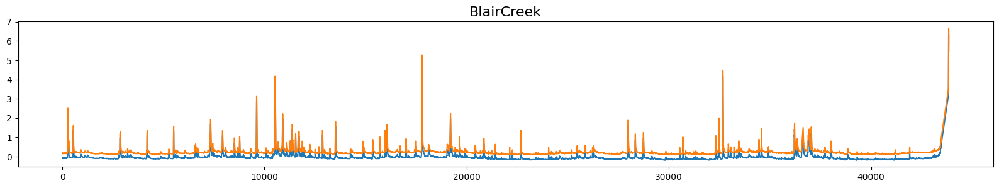

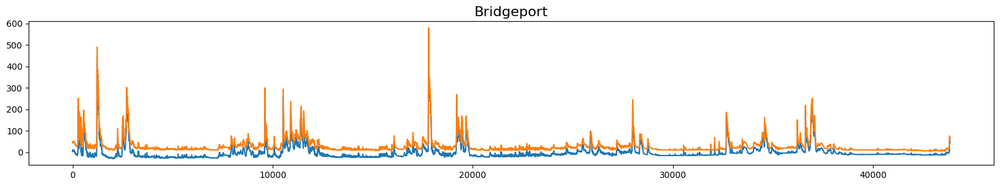

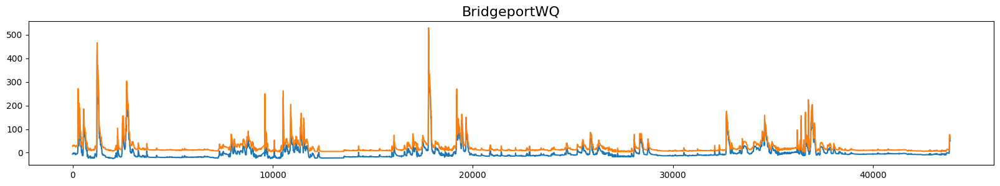

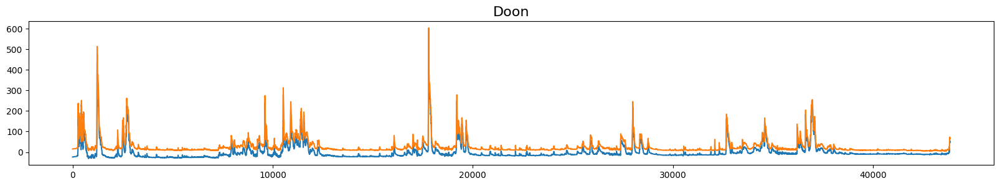

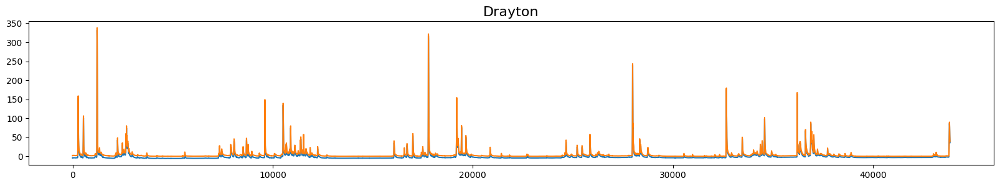

...

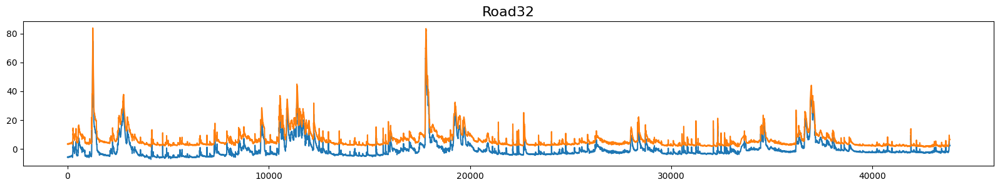

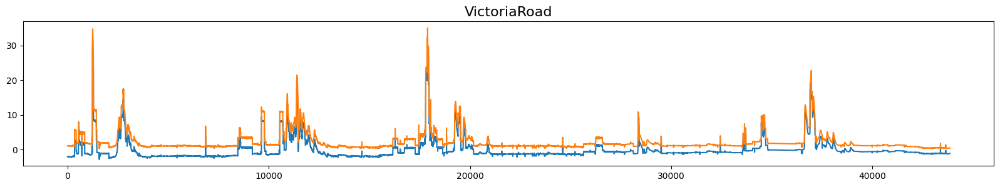

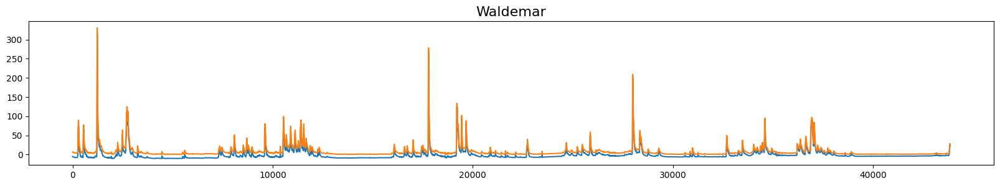

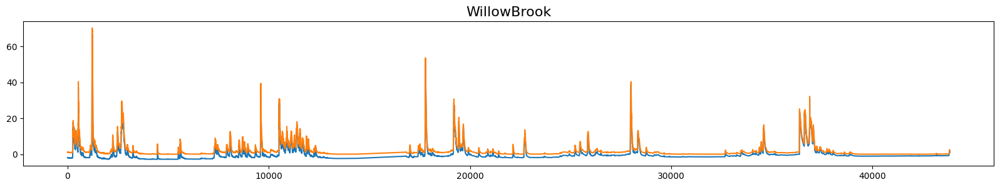

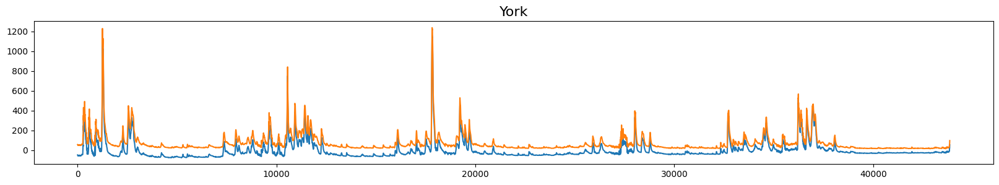

In [ ]:
for i in range(0, len(river_flow.columns)):
  ser = river_flow.iloc[:, i].values
  detrending(ser, river_flow.columns[i])

It seems that there is no change after detrending a linear component. Let's try a polynomial component

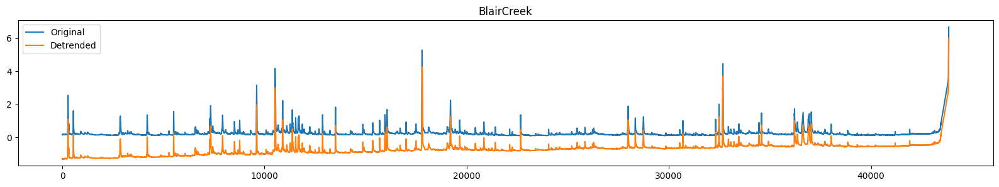

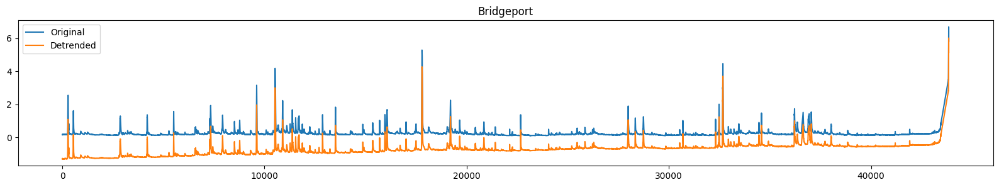

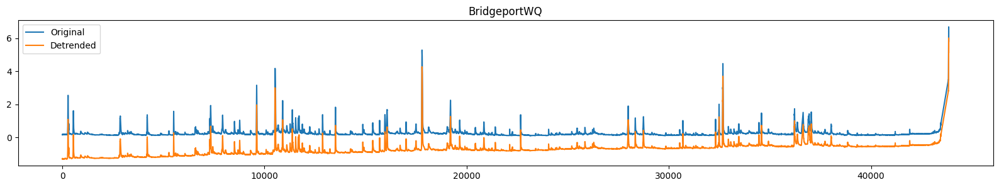

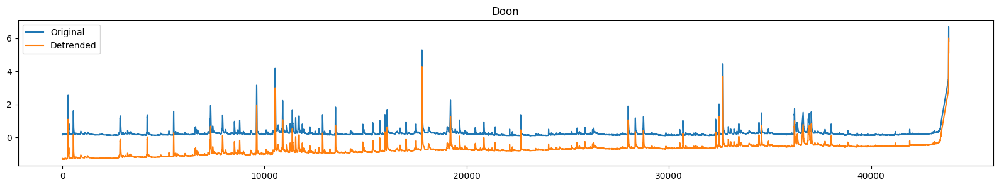

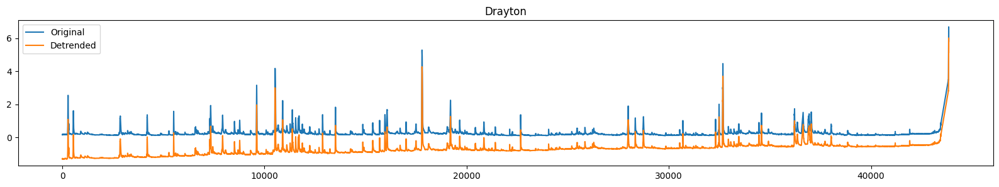

...

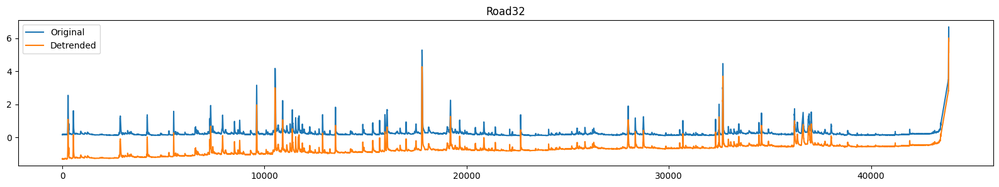

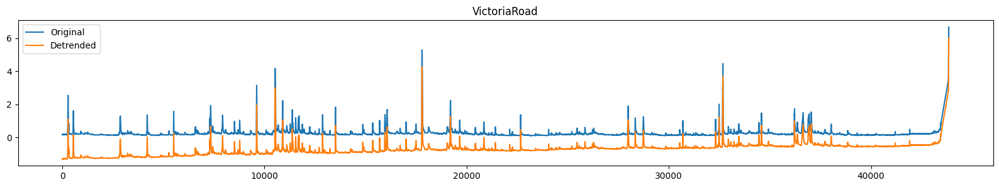

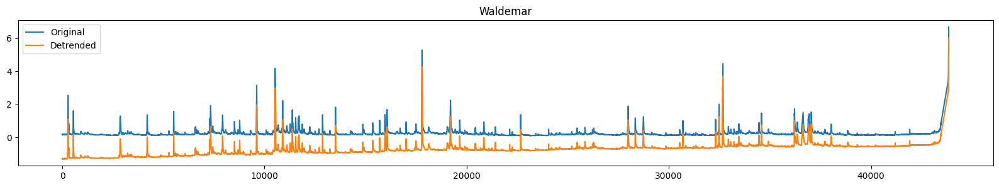

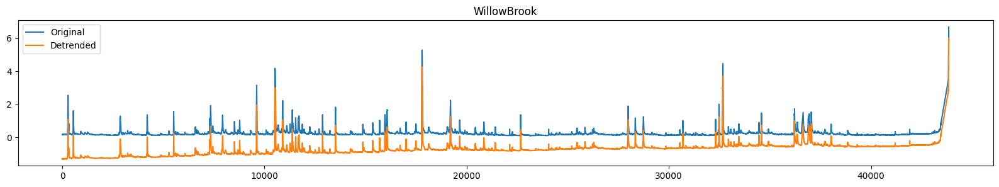

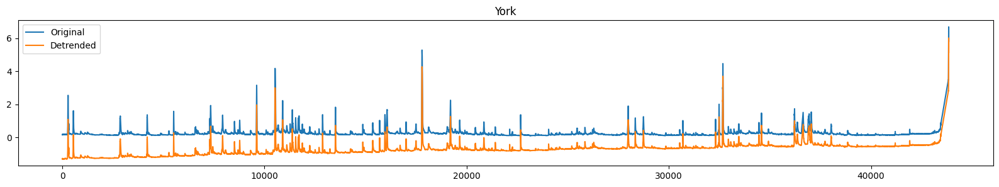

In [ ]:
for i in range(0, len(river_flow.columns)):
  model = np.polyfit(np.arange(len(river_flow)), river_flow.iloc[:, 5], 2)
  predicted = np.polyval(model, np.arange(len(river_flow.index)))
  plt.figure(figsize=(20, 3))
  plt.plot(np.arange(len(river_flow.index)), river_flow.iloc[:, 0], label= "Original")
  #plt.plot(np.arange(len(river_flow.index)), predicted, label= "trend")
  plt.title(river_flow.columns[i])
  plt.plot(np.arange(len(river_flow.index)), river_flow.iloc[:, 0] - predicted)
  plt.legend(["Original", "Detrended"])
  plt.show()

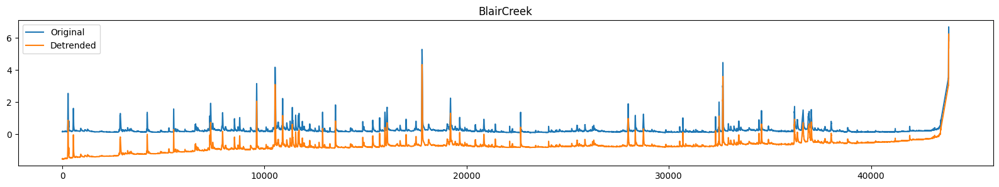

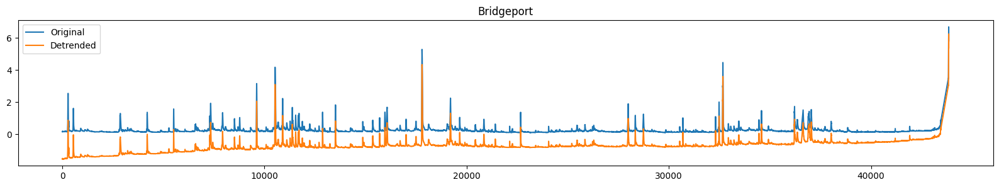

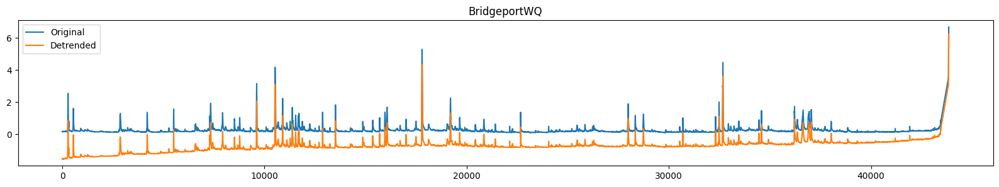

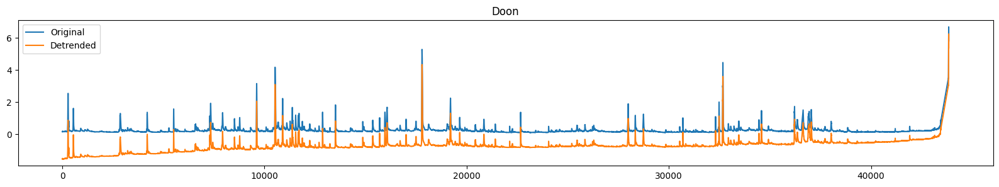

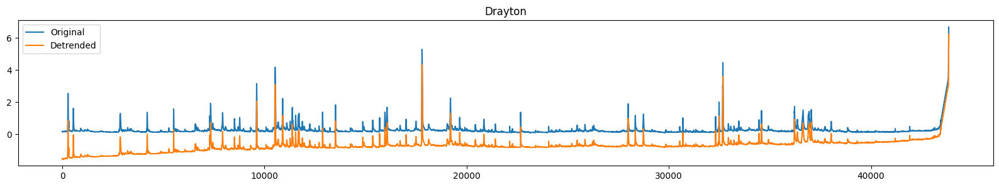

...

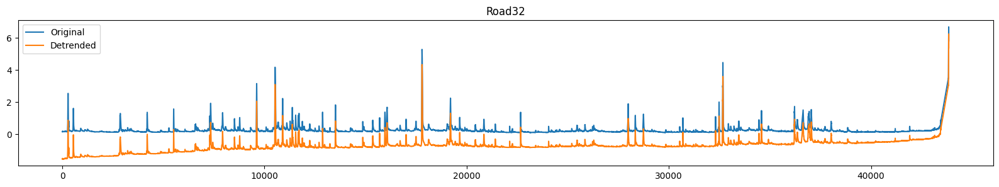

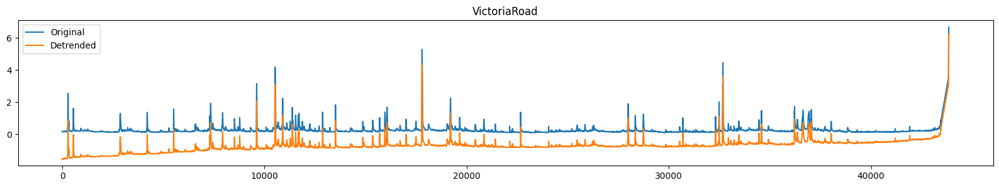

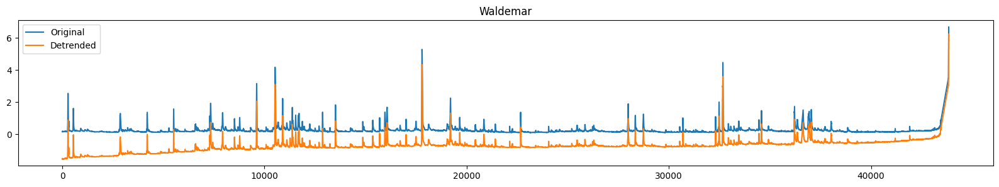

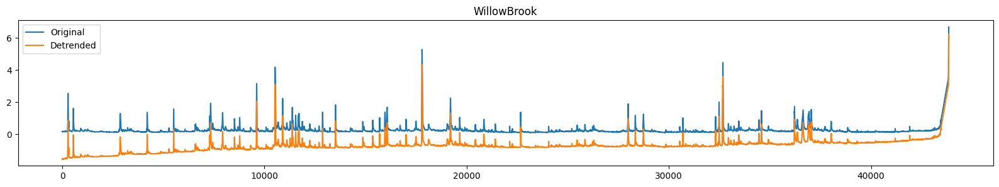

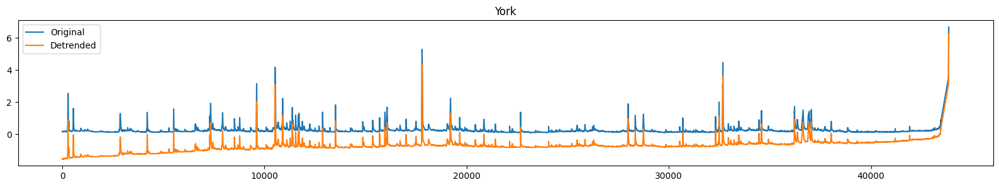

In [ ]:
for i in range(0, len(river_flow.columns)):
  model = np.polyfit(np.arange(len(river_flow)), river_flow.iloc[:, 5], 3)
  predicted = np.polyval(model, np.arange(len(river_flow.index)))
  plt.figure(figsize=(20, 3))
  plt.plot(np.arange(len(river_flow.index)), river_flow.iloc[:, 0], label= "Original")
  #plt.plot(np.arange(len(river_flow.index)), predicted, label= "trend")
  plt.title(river_flow.columns[i])
  plt.plot(np.arange(len(river_flow.index)), river_flow.iloc[:, 0] - predicted)
  plt.legend(["Original", "Detrended"])
  plt.show()

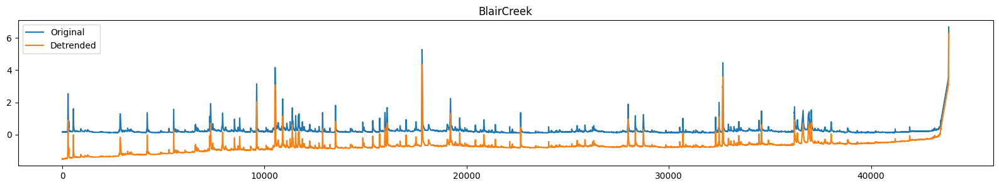

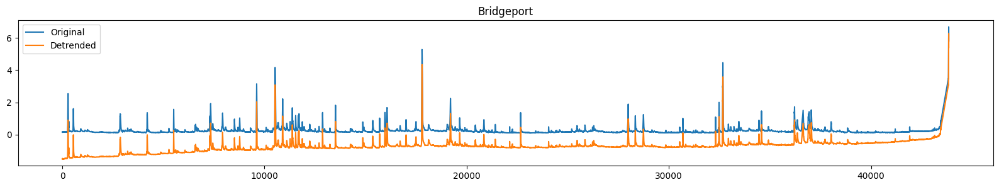

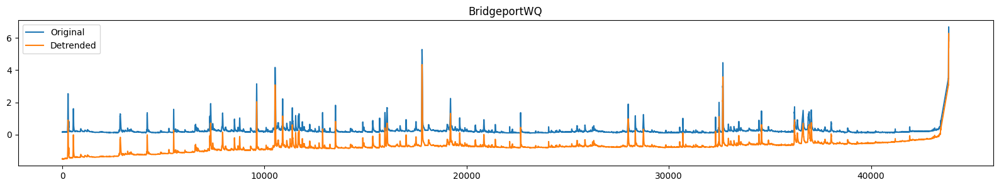

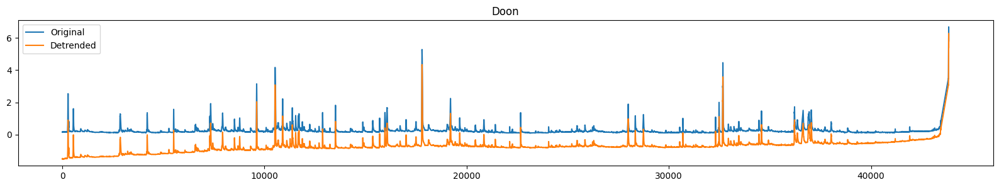

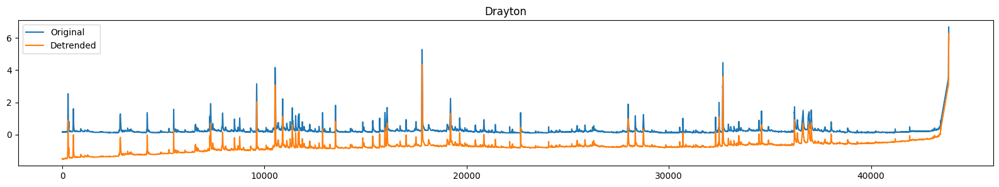

...

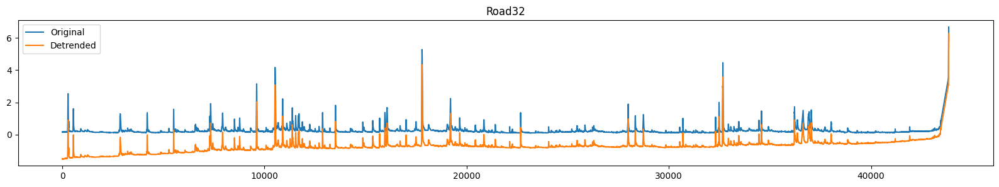

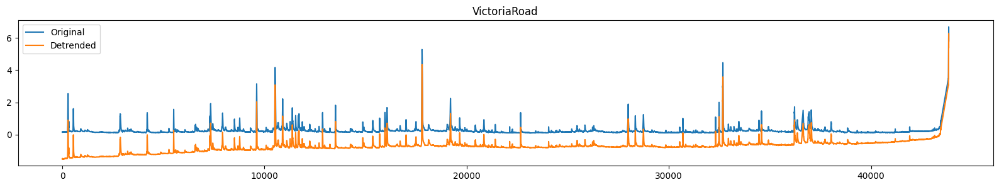

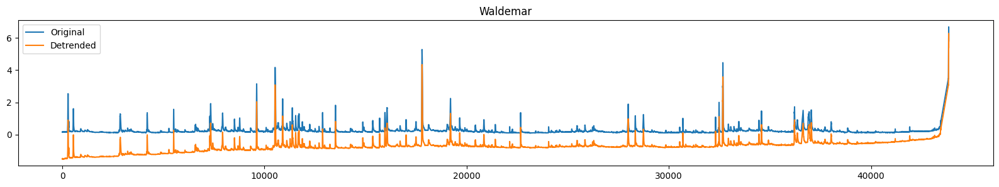

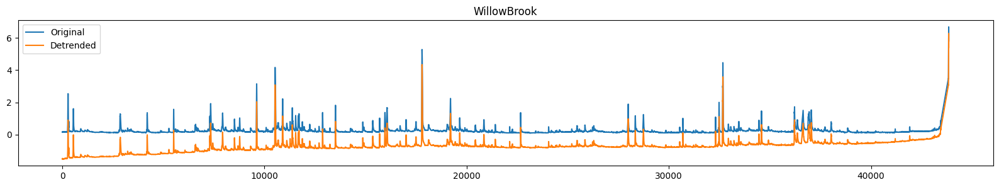

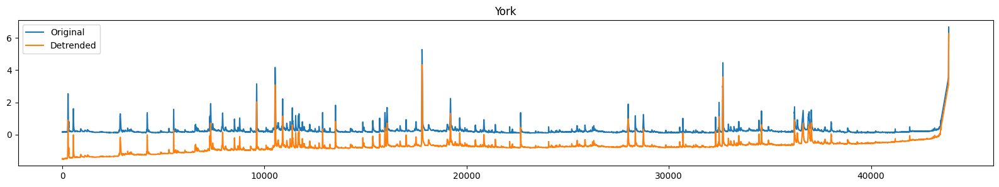

In [ ]:
for i in range(0, len(river_flow.columns)):
  model = np.polyfit(np.arange(len(river_flow)), river_flow.iloc[:, 5], 4)
  predicted = np.polyval(model, np.arange(len(river_flow.index)))
  plt.figure(figsize=(20, 3))
  plt.plot(np.arange(len(river_flow.index)), river_flow.iloc[:, 0], label= "Original")
  #plt.plot(np.arange(len(river_flow.index)), predicted, label= "trend")
  plt.title(river_flow.columns[i])
  plt.plot(np.arange(len(river_flow.index)), river_flow.iloc[:, 0] - predicted)
  plt.legend(["Original", "Detrended"])
  plt.show()

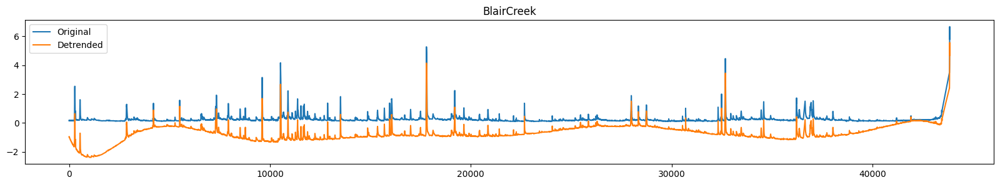

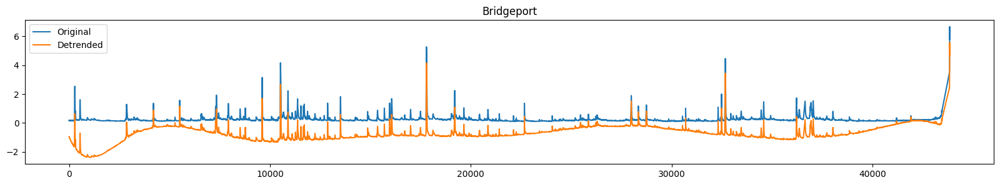

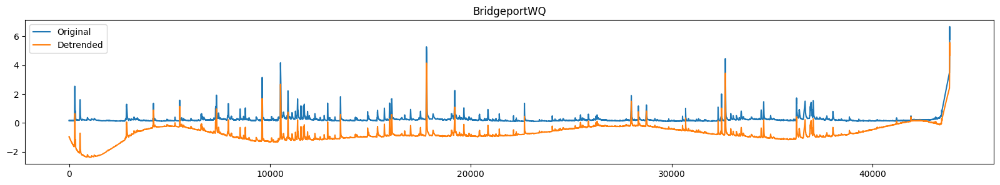

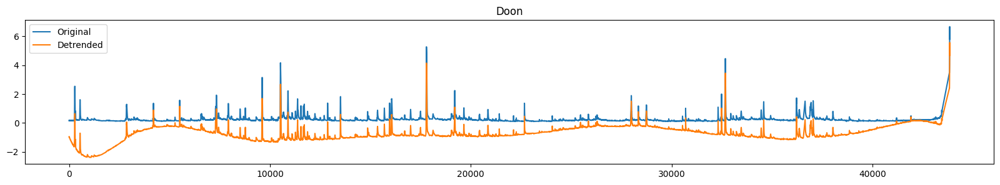

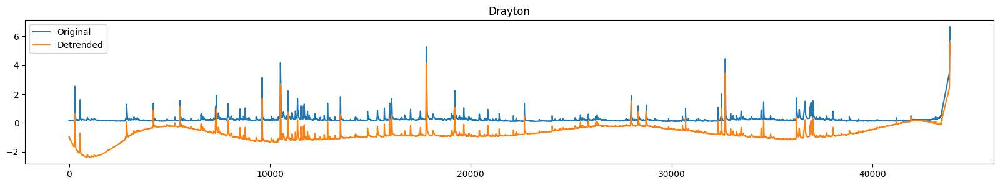

...

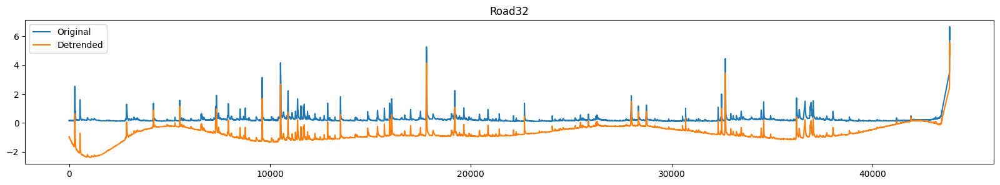

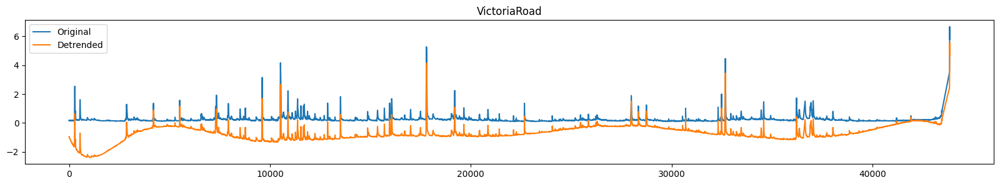

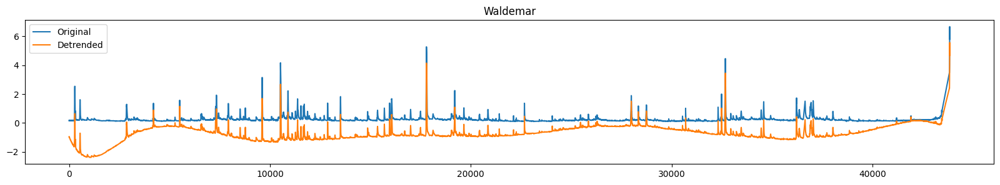

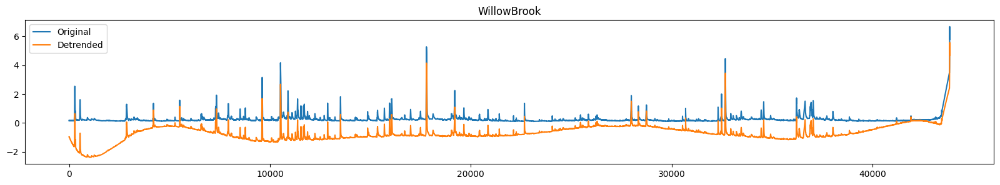

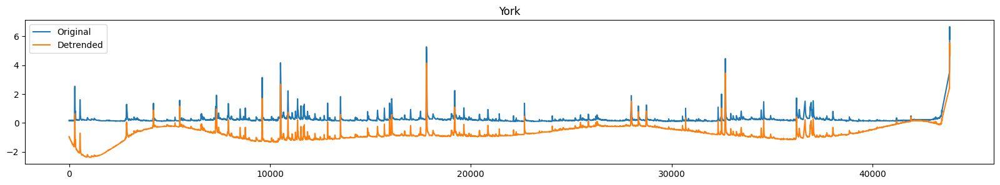

In [ ]:
for i in range(0, len(river_flow.columns)):
  model = np.polyfit(np.arange(len(river_flow)), river_flow.iloc[:, 5], 11)
  predicted = np.polyval(model, np.arange(len(river_flow.index)))
  plt.figure(figsize=(20, 3))
  plt.plot(np.arange(len(river_flow.index)), river_flow.iloc[:, 0], label= "Original")
  #plt.plot(np.arange(len(river_flow.index)), predicted, label= "trend")
  plt.title(river_flow.columns[i])
  plt.plot(np.arange(len(river_flow.index)), river_flow.iloc[:, 0] - predicted)
  plt.legend(["Original", "Detrended"])
  plt.show()

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


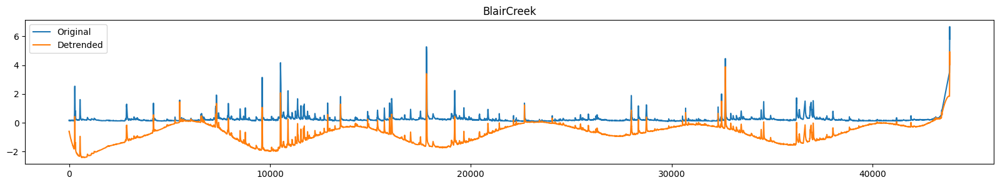

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


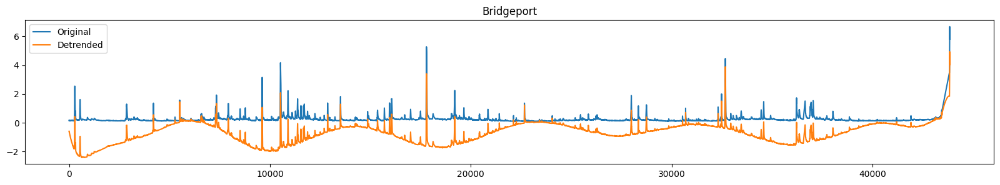

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


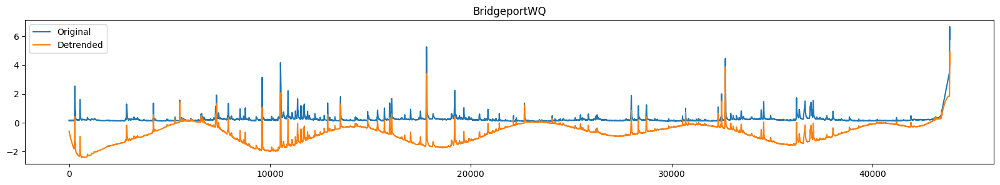

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


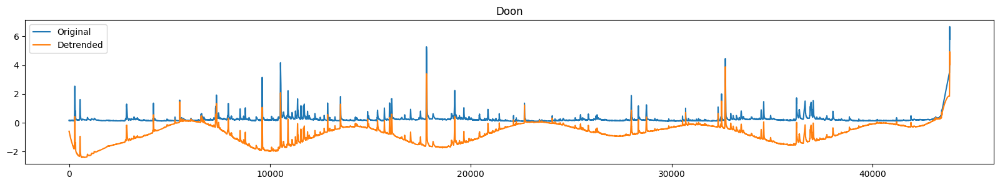

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


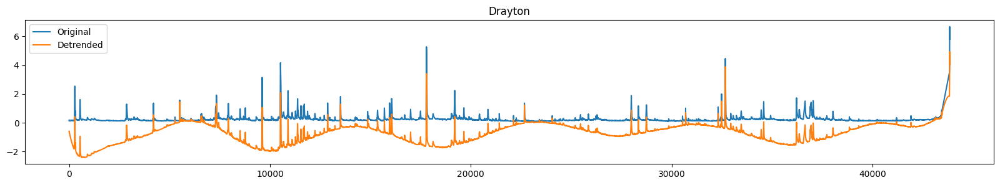

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


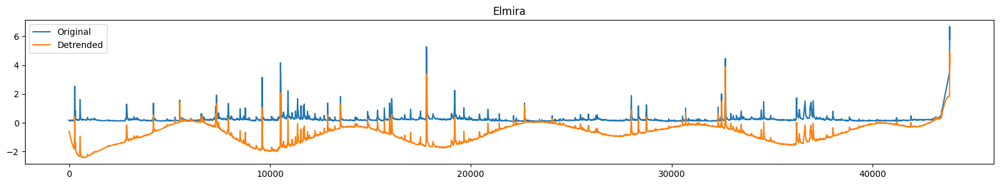

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


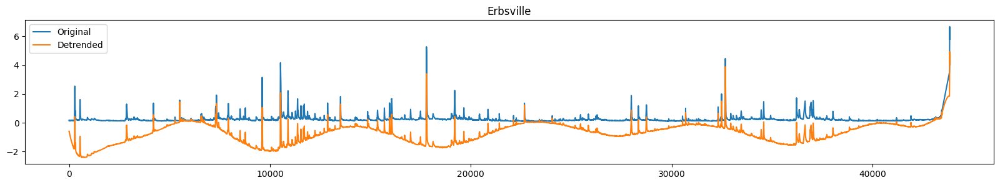

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


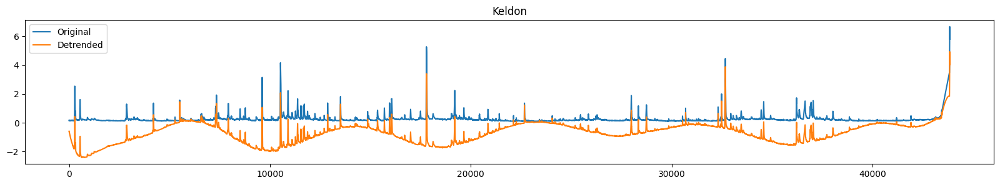

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


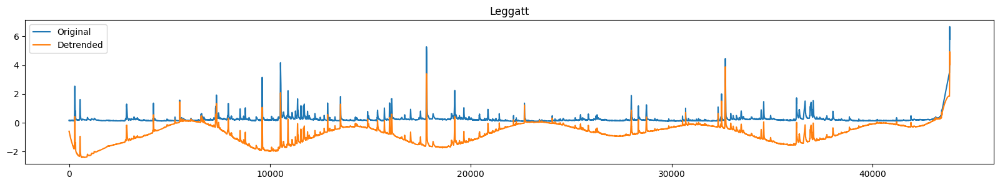

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


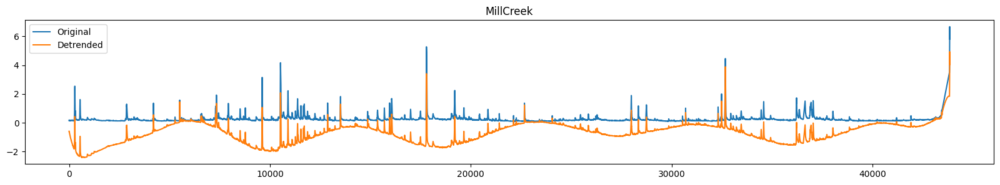

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


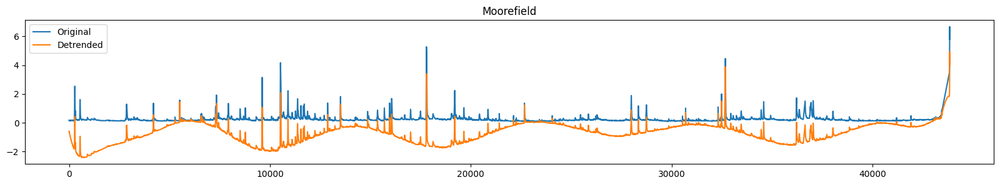

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


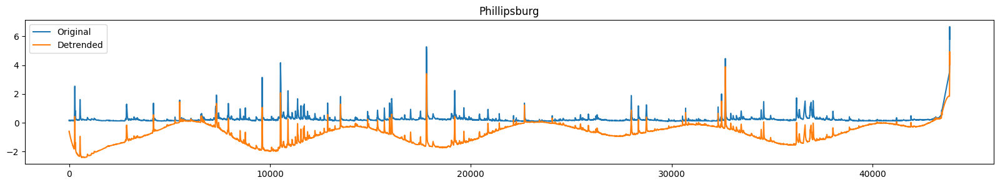

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


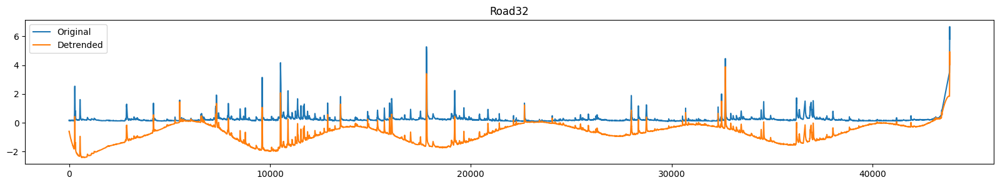

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


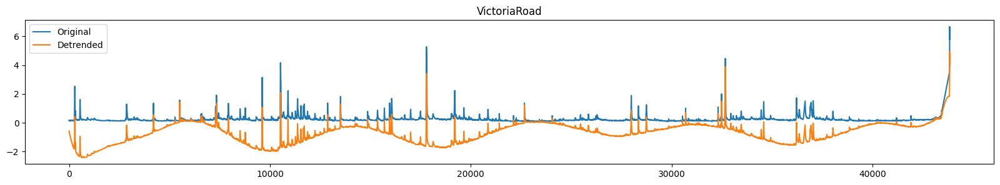

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


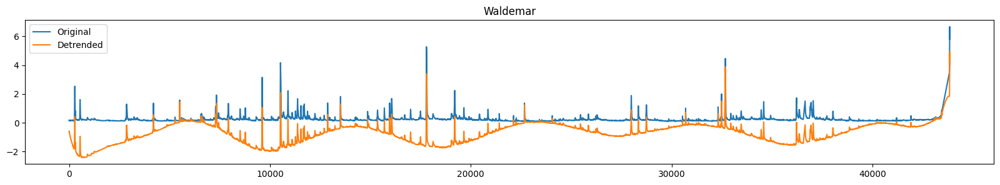

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


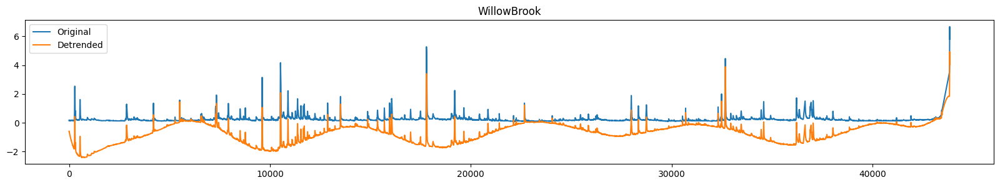

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


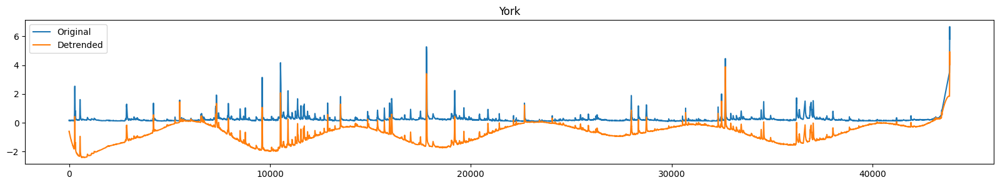

In [ ]:
for i in range(0, len(river_flow.columns)):
  model = np.polyfit(np.arange(len(river_flow)), river_flow.iloc[:, 5], 21)
  predicted = np.polyval(model, np.arange(len(river_flow.index)))
  plt.figure(figsize=(20, 3))
  plt.plot(np.arange(len(river_flow.index)), river_flow.iloc[:, 0], label= "Original")
  #plt.plot(np.arange(len(river_flow.index)), predicted, label= "trend")
  plt.title(river_flow.columns[i])
  plt.plot(np.arange(len(river_flow.index)), river_flow.iloc[:, 0] - predicted)
  plt.legend(["Original", "Detrended"])
  plt.show()

We can see that the polynomial trends are very weak and do not fit. It seems that there is no trend at all.

## **Subtracting the trend component**

Here, I will subtract the trend component from the seasonal_decompose

Subtracting daily trend

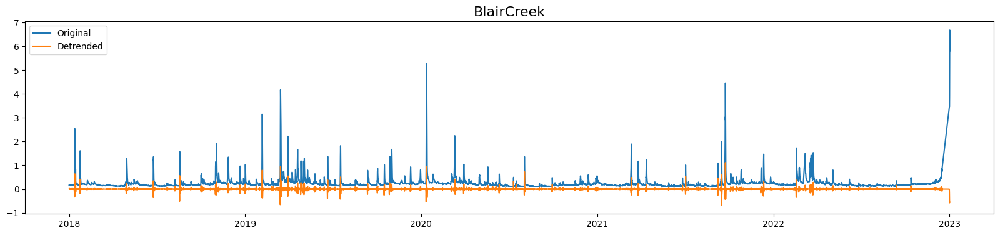

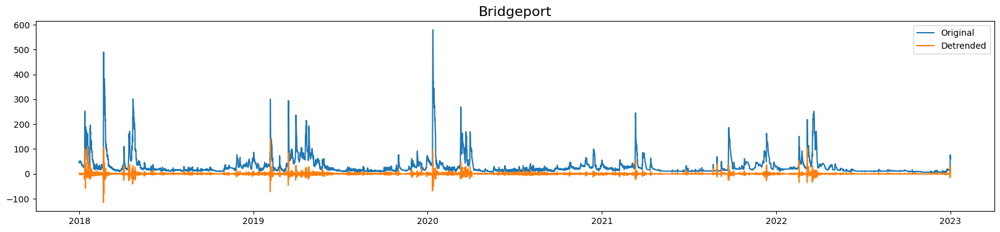

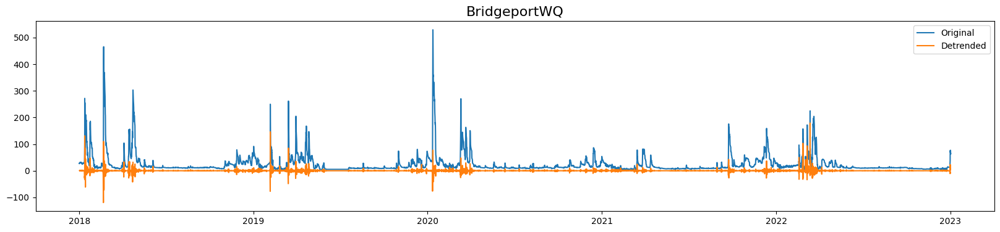

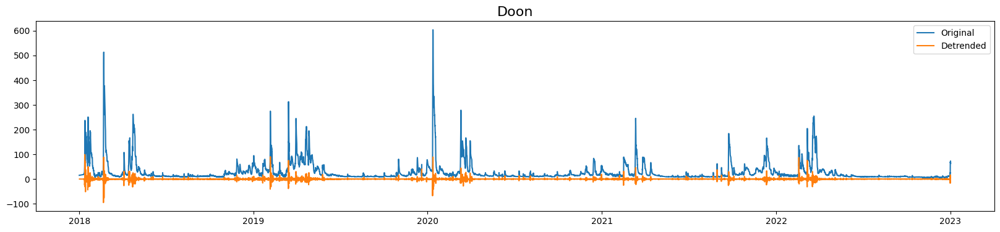

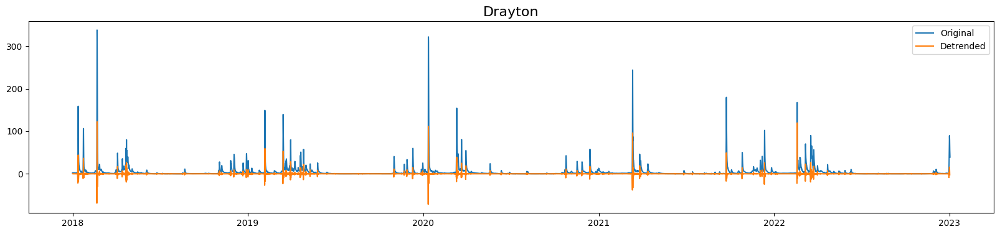

...

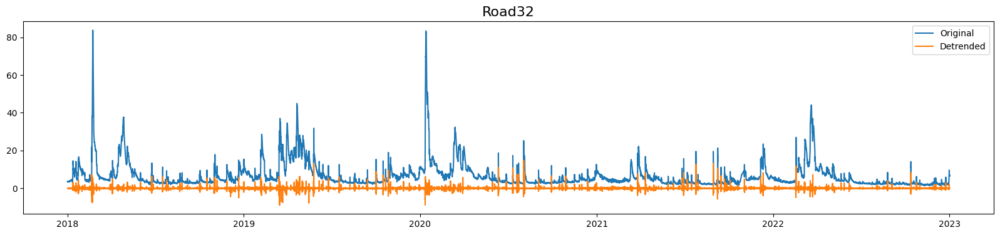

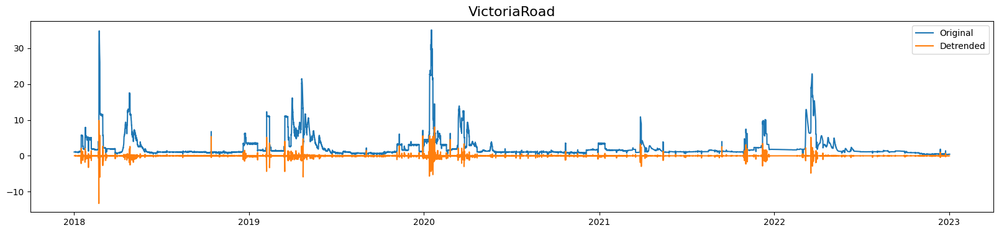

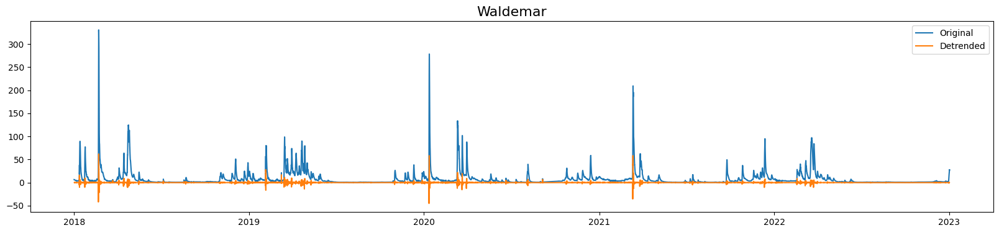

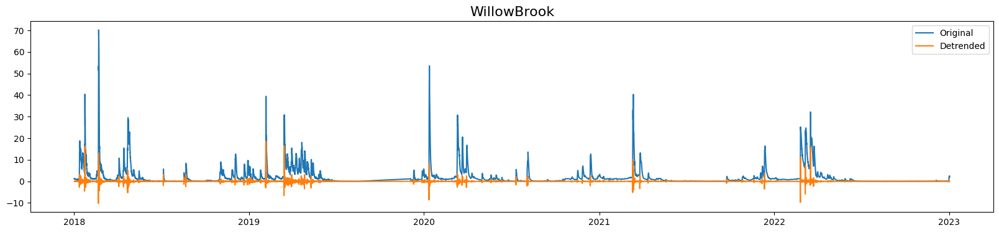

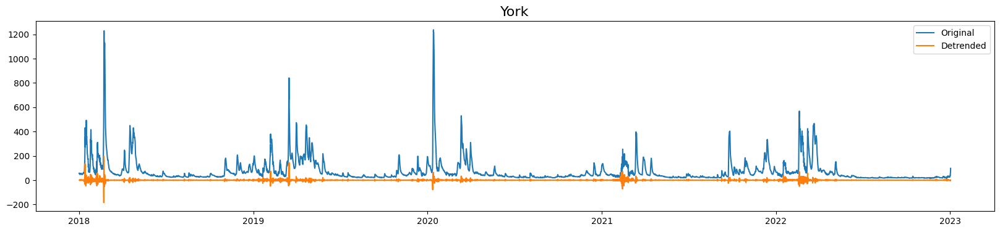

In [ ]:
for i in range(0, len(river_flow.columns)):
  result_mul = seasonal_decompose(river_flow.iloc[:, i], model='multiplicative', period=24)
  detrended = river_flow.iloc[:, i].values - result_mul.trend
  plt.figure(figsize= (20, 4))
  plt.plot(river_flow.iloc[:, i])
  plt.plot(detrended)
  plt.title(river_flow.columns[i], fontsize=16)
  plt.legend(["Original", "Detrended"])
  plt.show()

Subtracting weekly trend

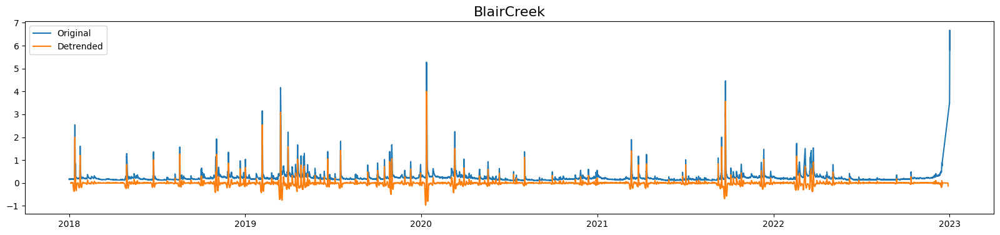

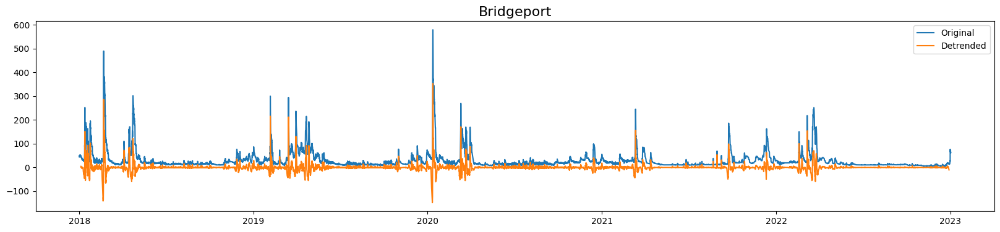

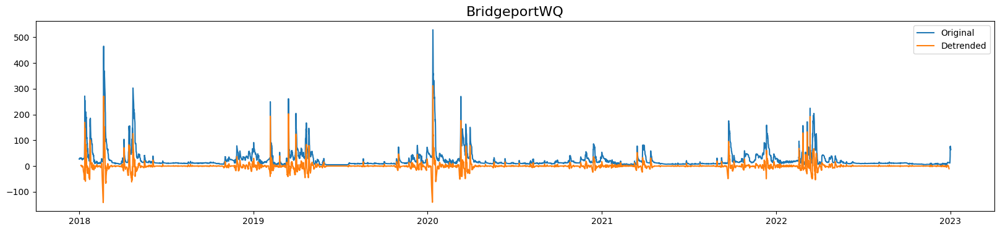

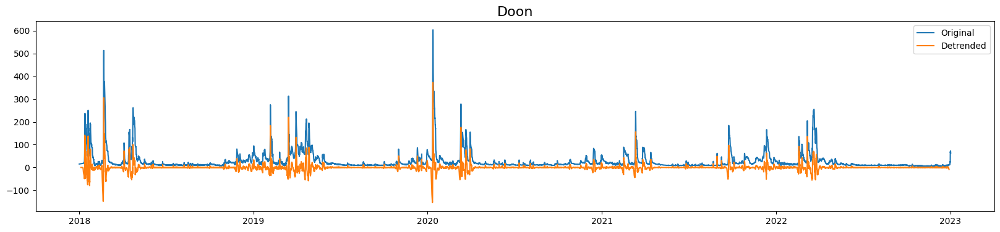

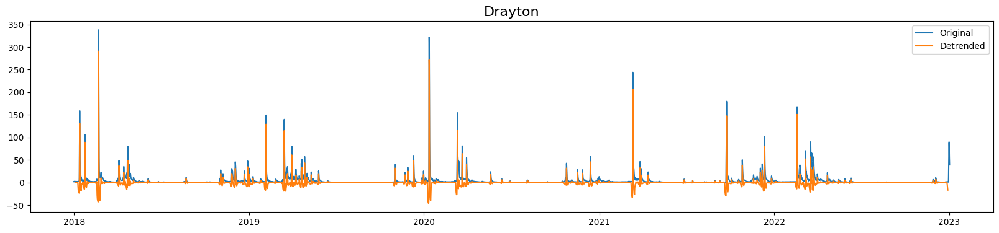

...

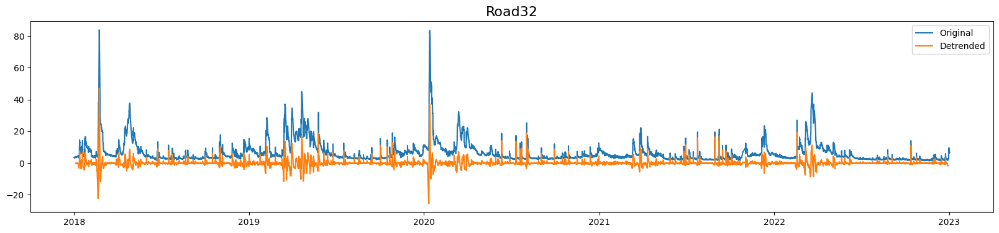

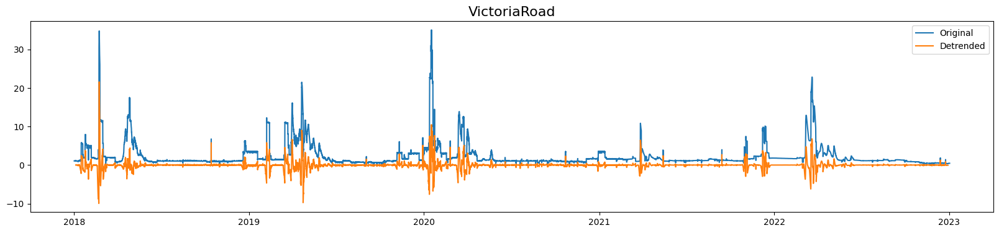

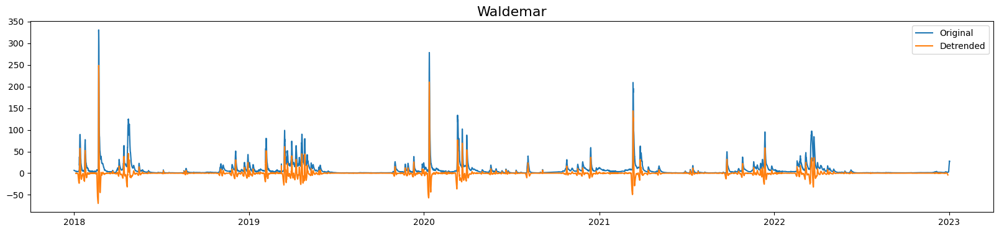

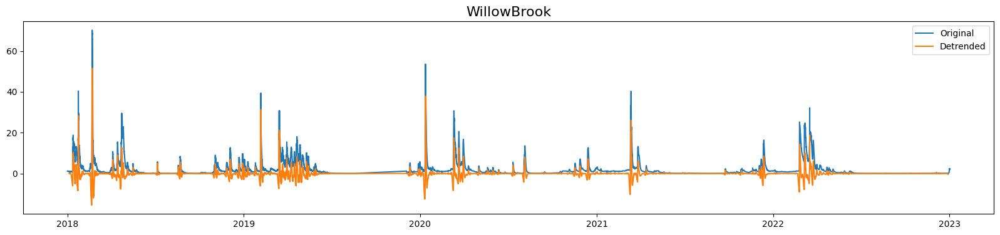

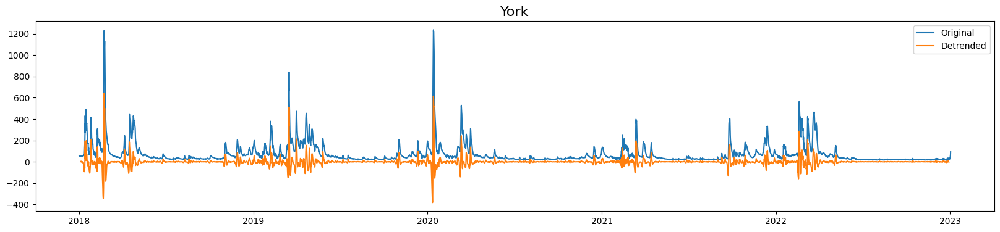

In [ ]:
for i in range(0, len(river_flow.columns)):
  result_mul = seasonal_decompose(river_flow.iloc[:, i], model='multiplicative', period=168)
  detrended = river_flow.iloc[:, i].values - result_mul.trend
  plt.figure(figsize= (20, 4))
  plt.plot(river_flow.iloc[:, i])
  plt.plot(detrended)
  plt.title(river_flow.columns[i], fontsize=16)
  plt.legend(["Original", "Detrended"])
  plt.show()

Subtracting Monthly trend

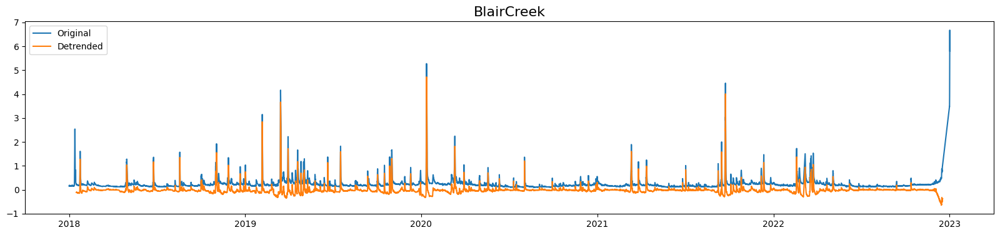

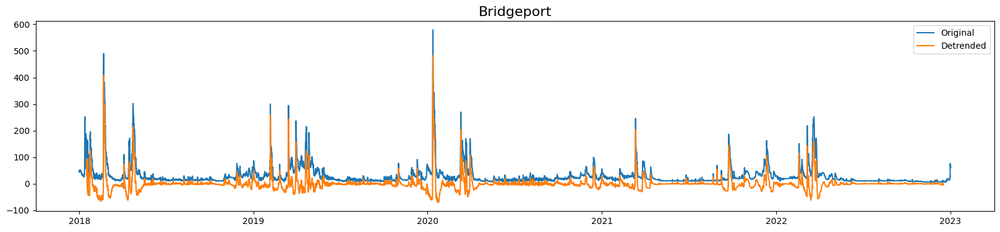

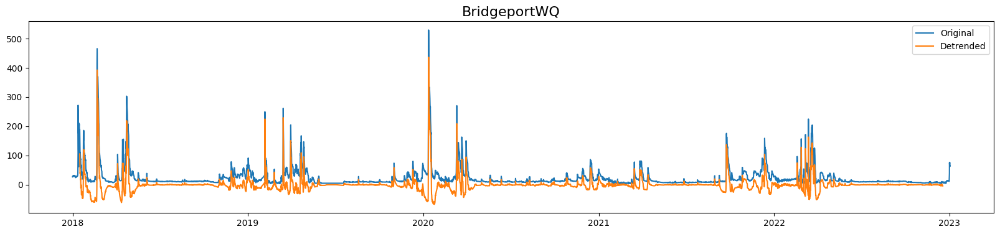

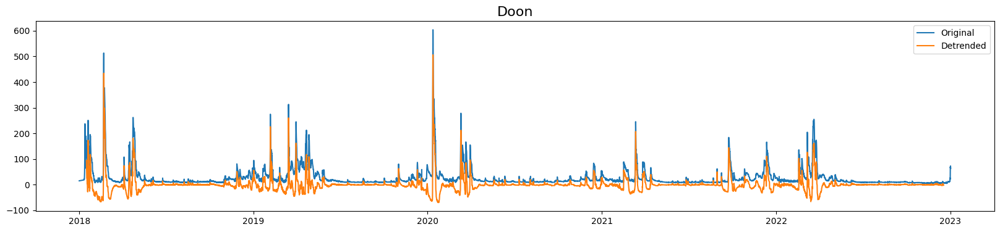

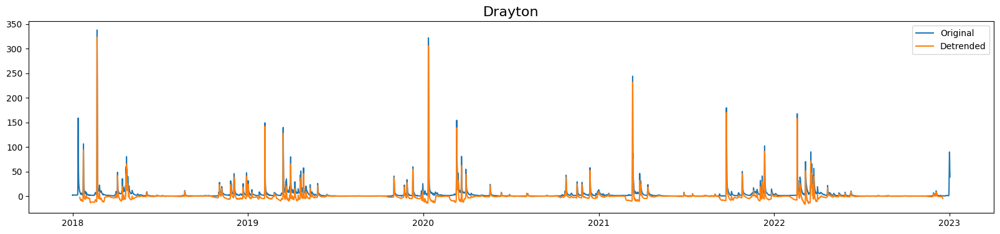

...

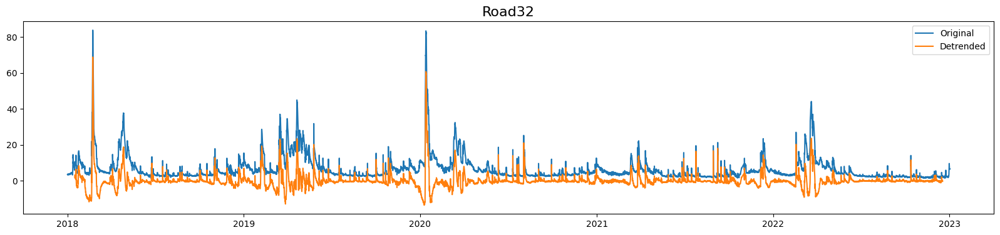

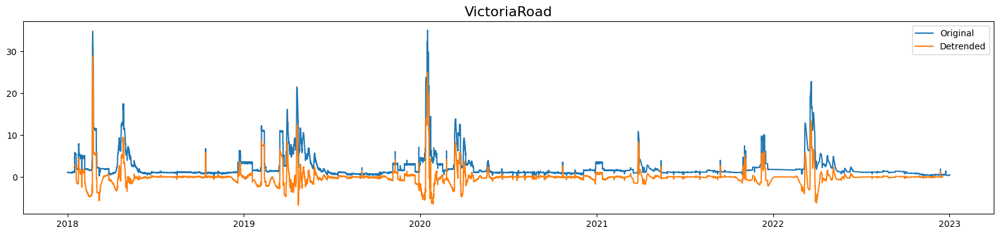

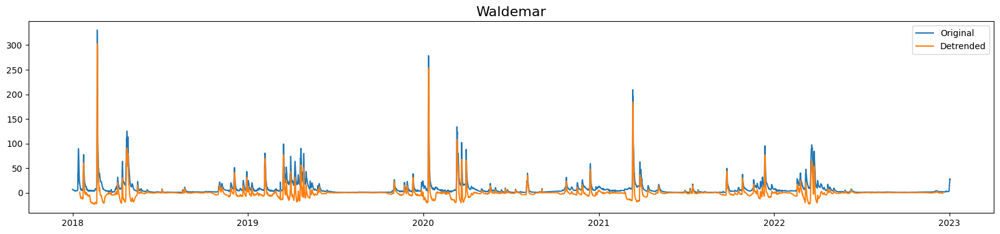

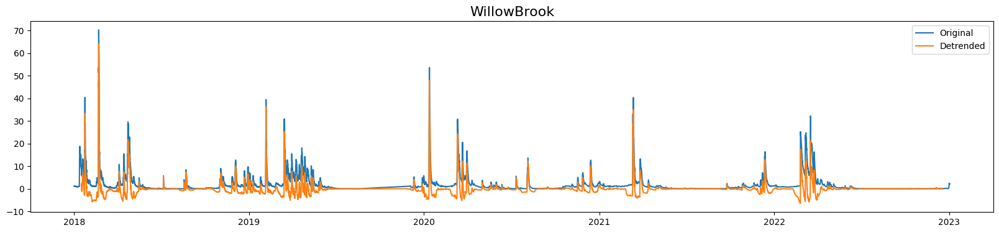

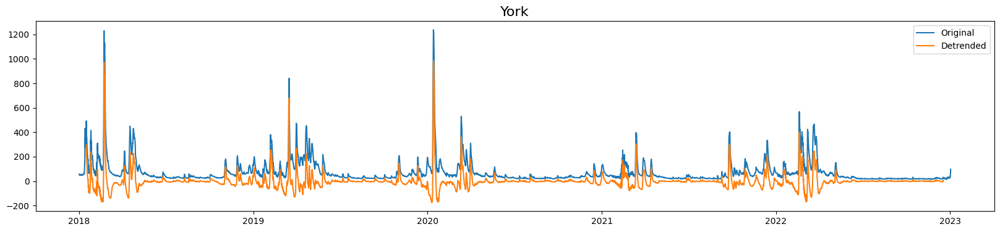

In [ ]:
for i in range(0, len(river_flow.columns)):
  result_mul = seasonal_decompose(river_flow.iloc[:, i], model='multiplicative', period=720)
  detrended = river_flow.iloc[:, i].values - result_mul.trend
  plt.figure(figsize= (20, 4))
  plt.plot(river_flow.iloc[:, i])
  plt.plot(detrended)
  plt.title(river_flow.columns[i], fontsize=16)
  plt.legend(["Original", "Detrended"])
  plt.show()

Subtracting Quarter yearly trend

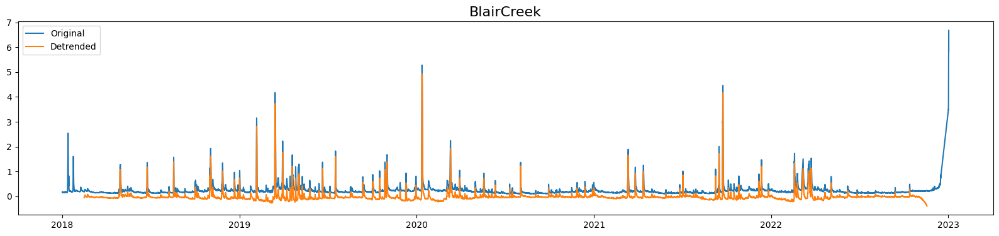

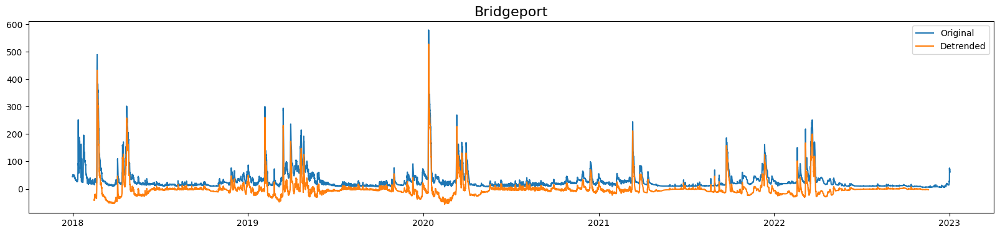

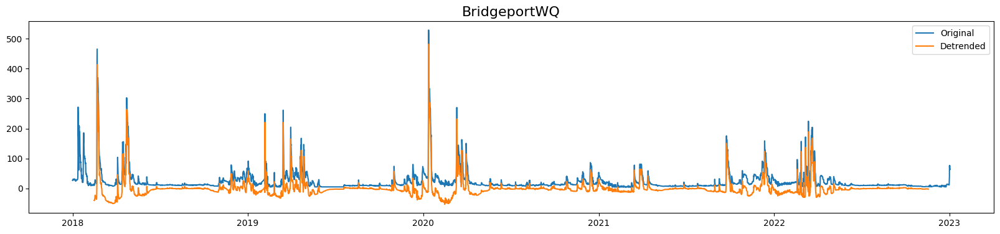

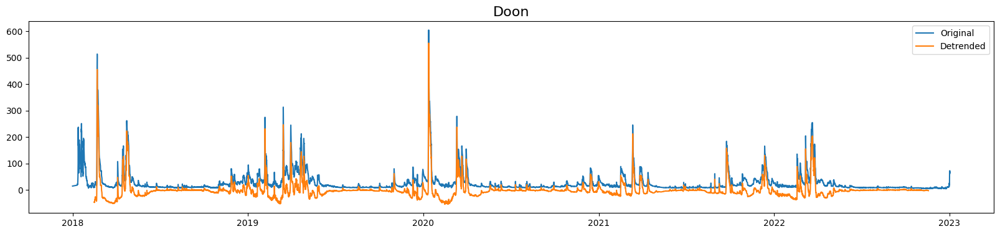

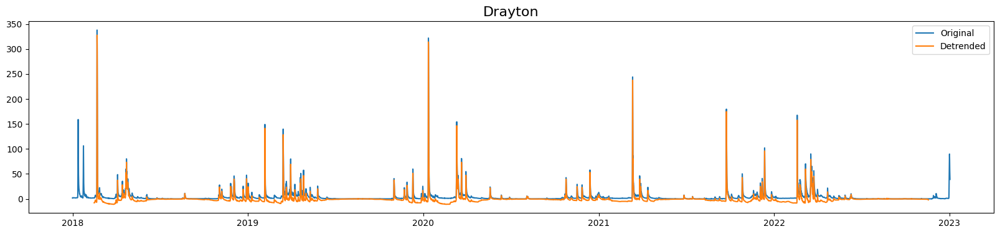

...

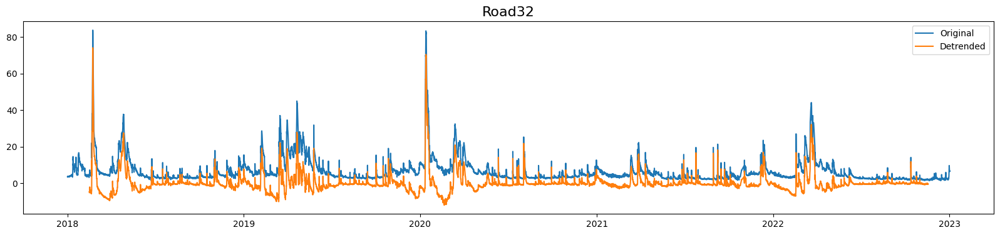

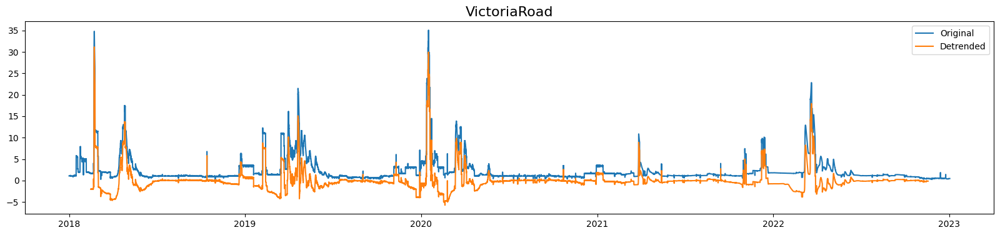

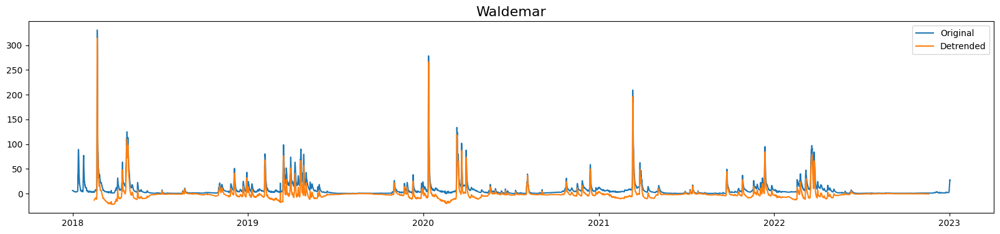

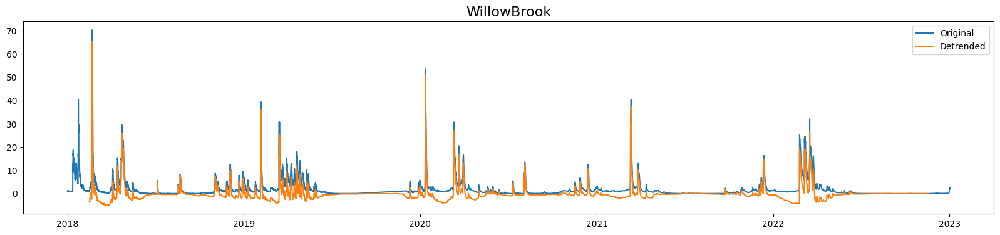

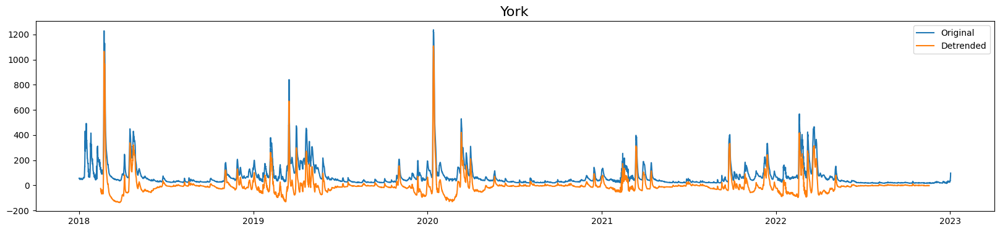

In [ ]:
for i in range(0, len(river_flow.columns)):
  result_mul = seasonal_decompose(river_flow.iloc[:, i], model='multiplicative', period=2160)
  detrended = river_flow.iloc[:, i].values - result_mul.trend
  plt.figure(figsize= (20, 4))
  plt.plot(river_flow.iloc[:, i])
  plt.plot(detrended)
  plt.title(river_flow.columns[i], fontsize=16)
  plt.legend(["Original", "Detrended"])
  plt.show()

Subtracting half-yearly trend

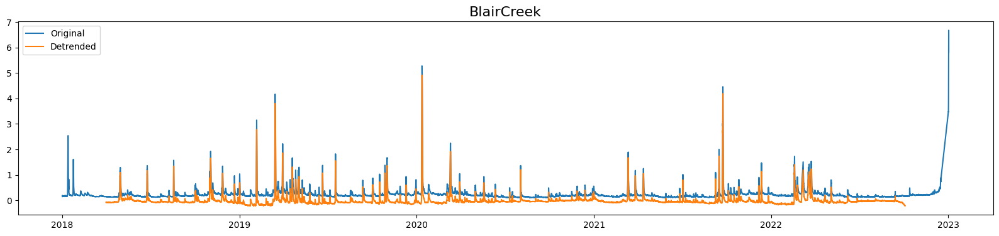

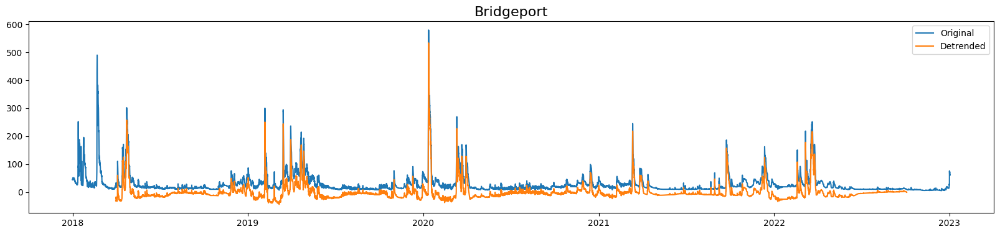

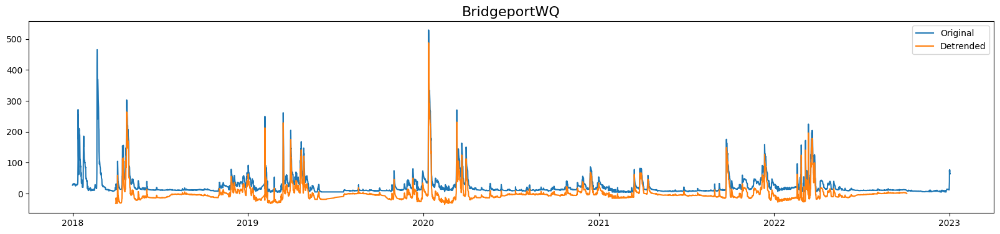

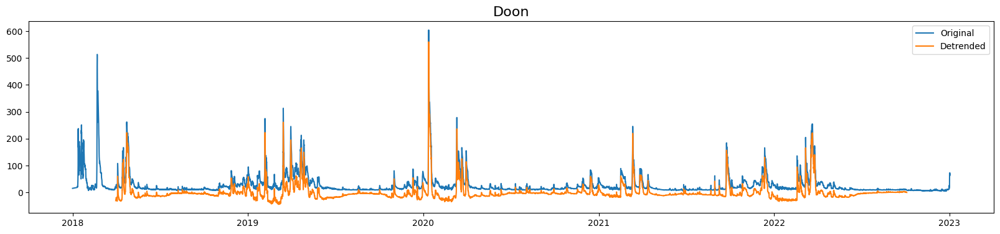

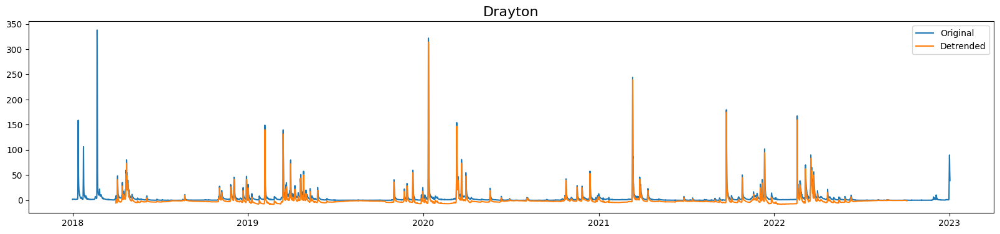

...

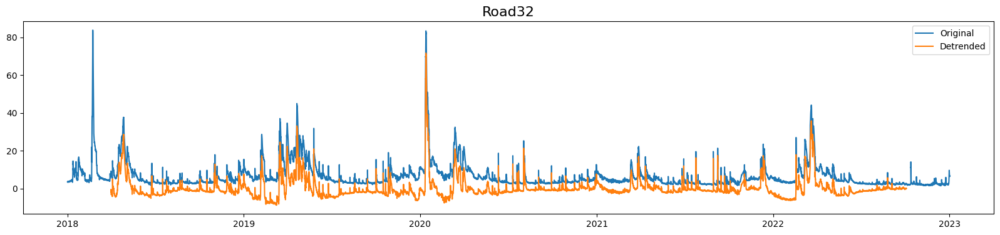

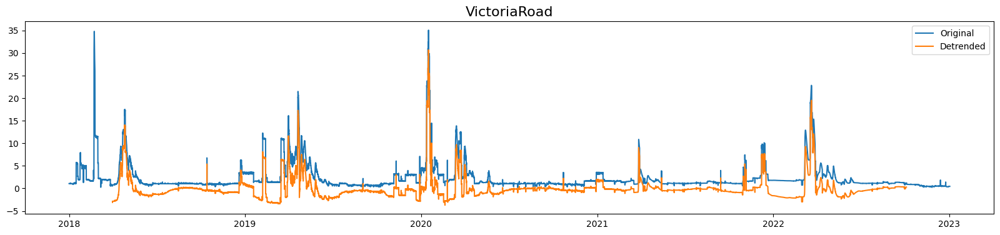

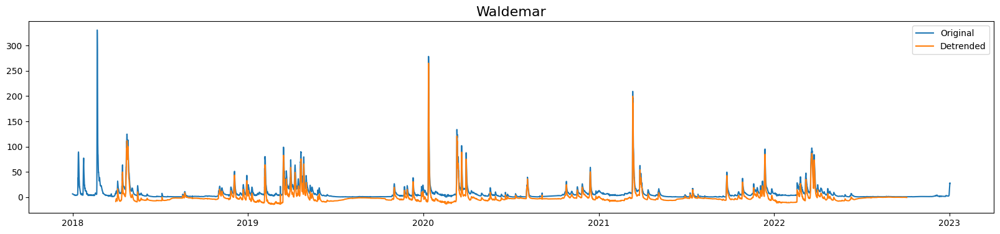

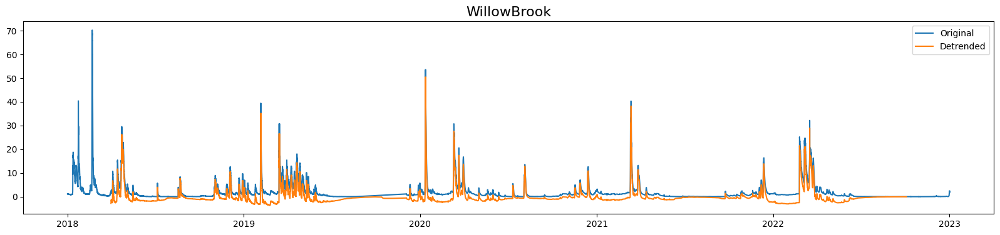

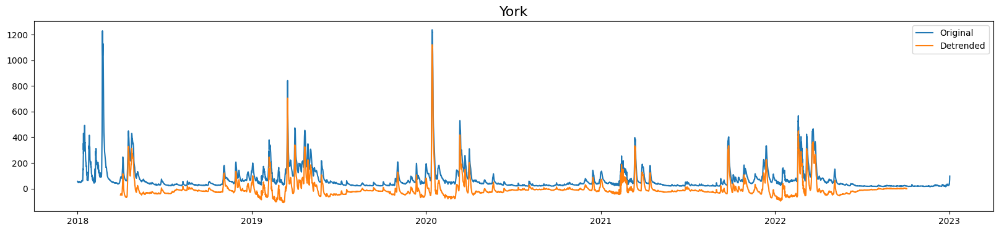

In [ ]:
for i in range(0, len(river_flow.columns)):
  result_mul = seasonal_decompose(river_flow.iloc[:, i], model='multiplicative', period=4320)
  detrended = river_flow.iloc[:, i].values - result_mul.trend
  plt.figure(figsize= (20, 4))
  plt.plot(river_flow.iloc[:, i])
  plt.plot(detrended)
  plt.title(river_flow.columns[i], fontsize=16)
  plt.legend(["Original", "Detrended"])
  plt.show()

Subtracting yearly trend

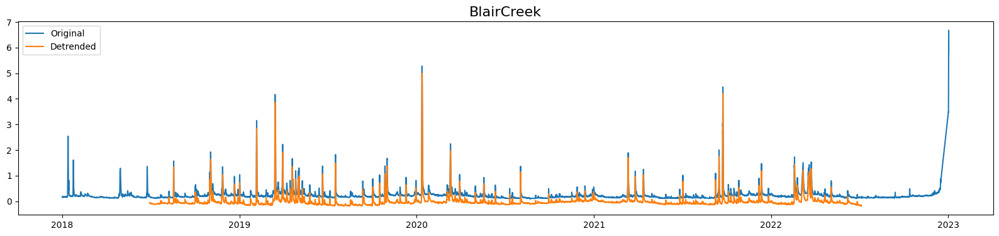

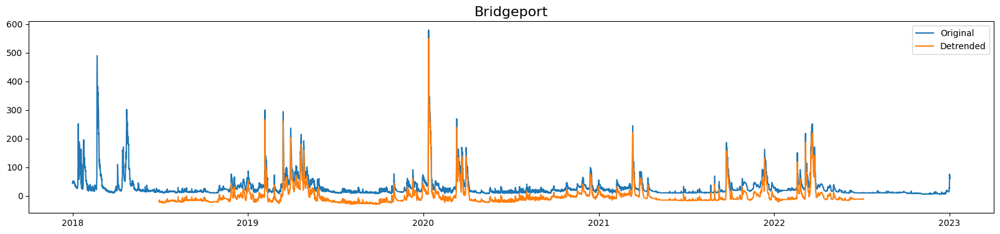

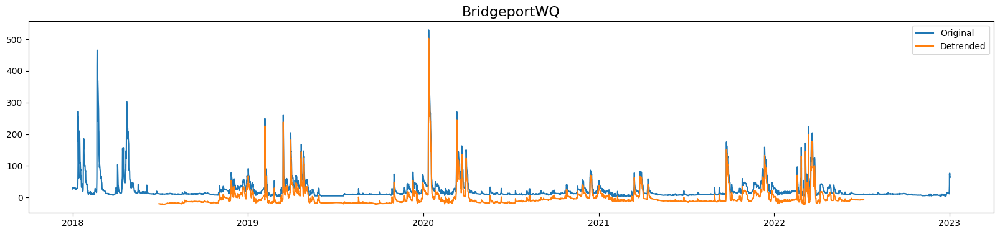

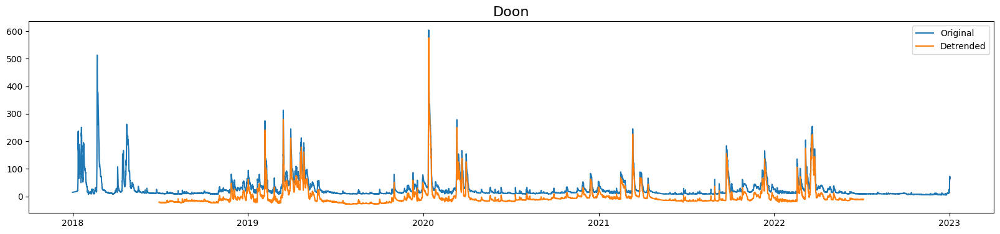

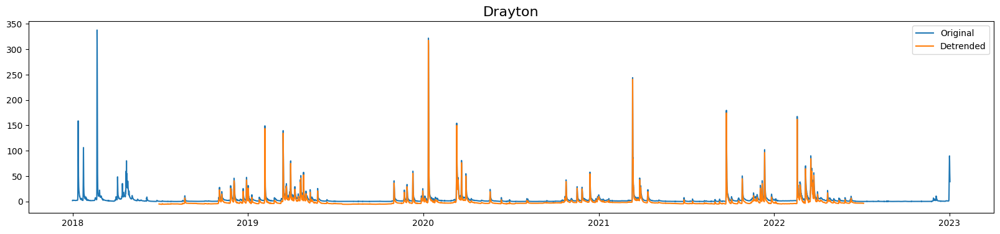

...

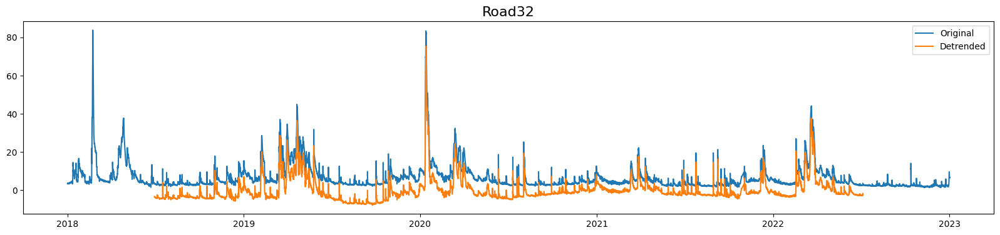

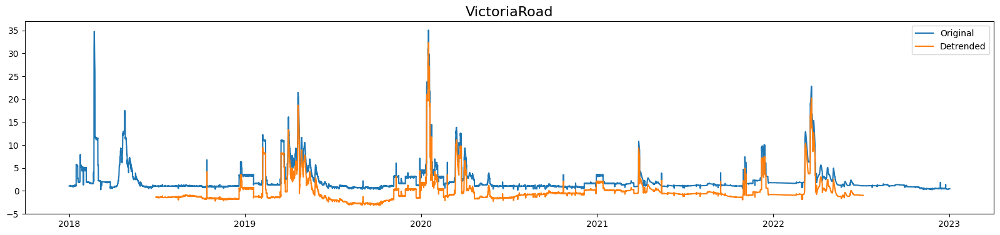

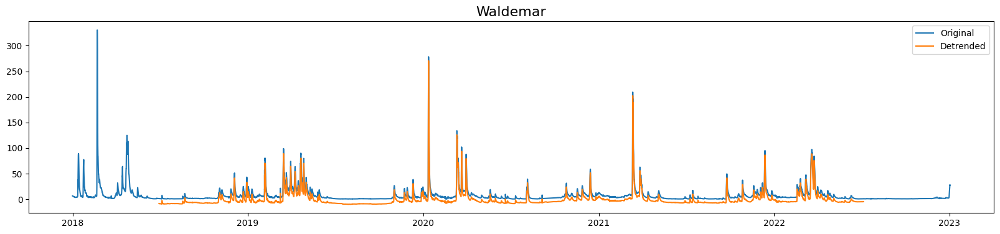

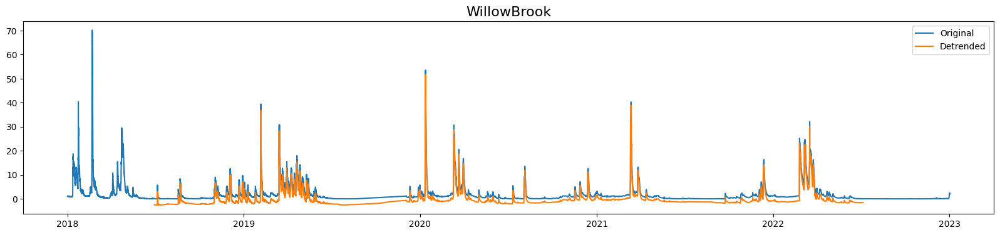

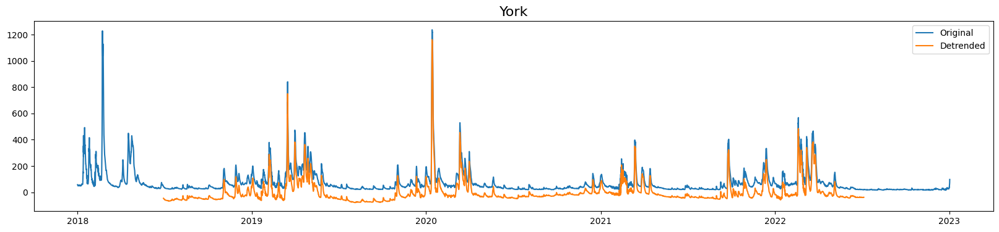

In [ ]:
for i in range(0, len(river_flow.columns)):
  result_mul = seasonal_decompose(river_flow.iloc[:, i], model='multiplicative', period=8640)
  detrended = river_flow.iloc[:, i].values - result_mul.trend
  plt.figure(figsize= (20, 4))
  plt.plot(river_flow.iloc[:, i])
  plt.plot(detrended)
  plt.title(river_flow.columns[i], fontsize=16)
  plt.legend(["Original", "Detrended"])
  plt.show()

Subtracting 2.5 yearly trend

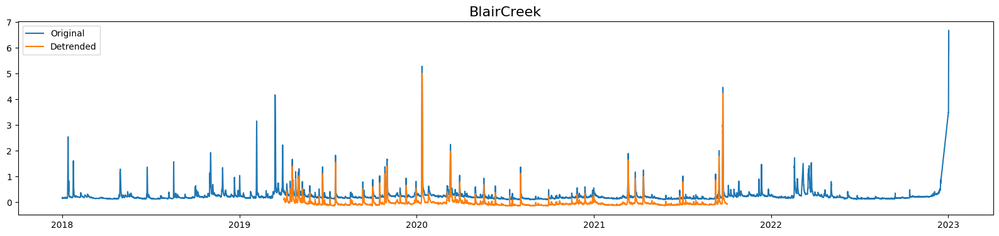

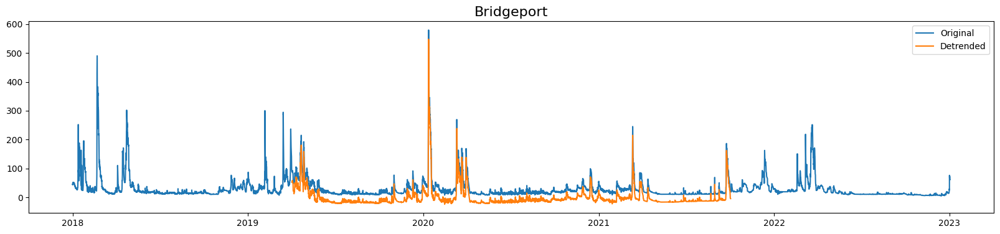

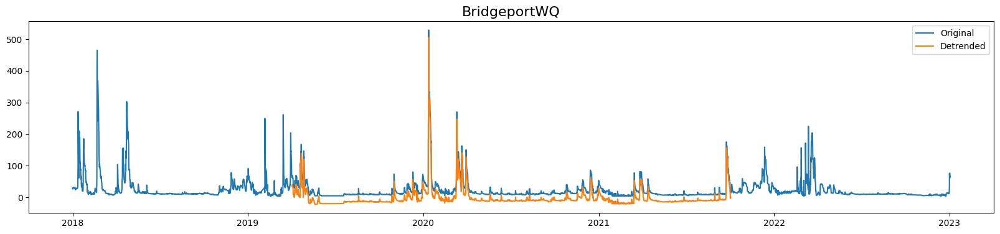

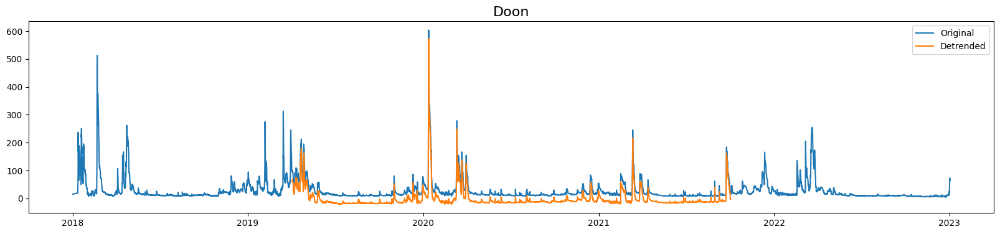

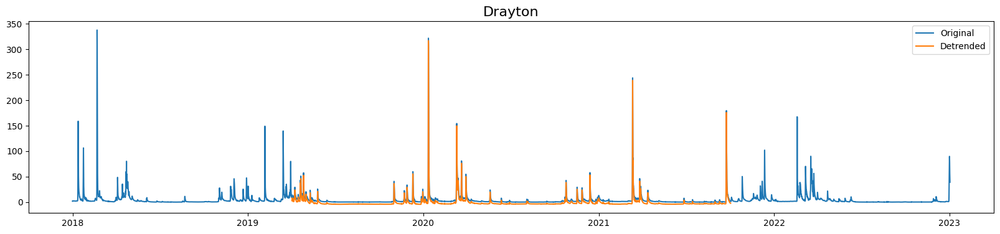

...

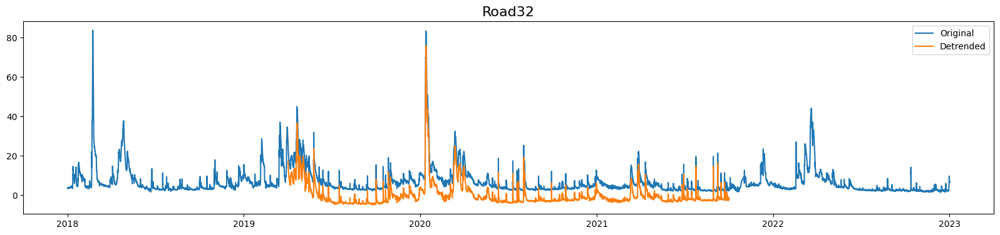

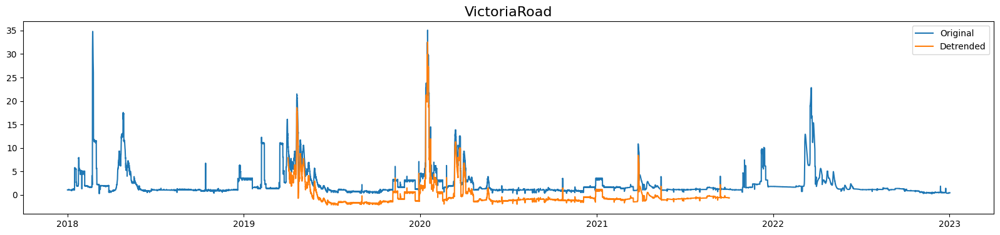

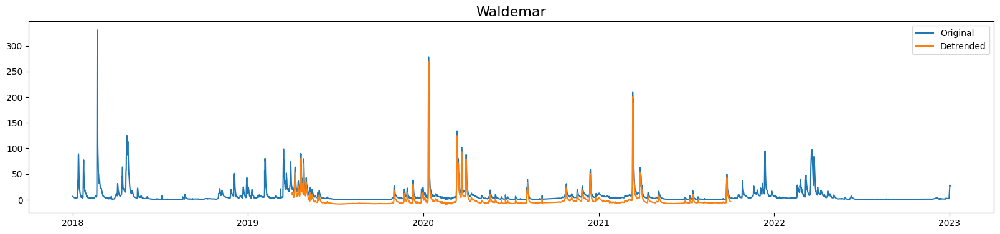

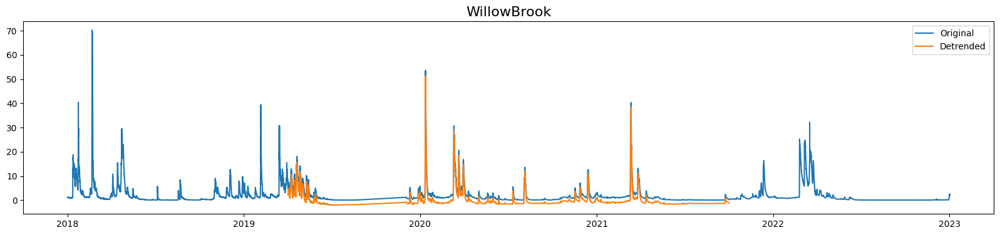

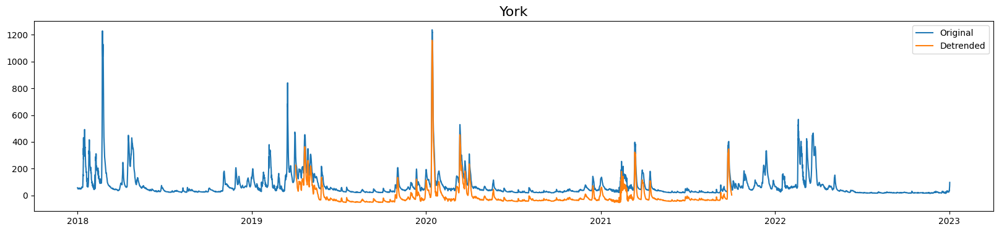

In [ ]:
for i in range(0, len(river_flow.columns)):
  result_mul = seasonal_decompose(river_flow.iloc[:, i], model='multiplicative', period=21924)
  detrended = river_flow.iloc[:, i].values - result_mul.trend
  plt.figure(figsize= (20, 4))
  plt.plot(river_flow.iloc[:, i])
  plt.plot(detrended)
  plt.title(river_flow.columns[i], fontsize=16)
  plt.legend(["Original", "Detrended"])
  plt.show()

We can see that after subtracting the trend component got from the function seasonal_decompose, the plot has not changed, it has just changed its position on y-axis, but the curvature remains the same. The best fit I think is the subtraction of weekly trend

# **Deseasonalizing the time series**

There are multiple appraches to deseasonalize a time series. These approaches are listed below:


1.   Taking a moving average with length as the seasonal window. This will smoothen the series in the process.
2.   Seasonal difference the series (subtract the value of previous season from the current value).
3.   Divide the series by the seasonal index obtained from STL decomposition.



If dividing by the seasonal index does not work well, we will take a log of the series and then do the deseasonalizing. We will later restore to the original scale by taking an exponential.

In [ ]:
river_flow

,BlairCreek,Bridgeport,BridgeportWQ,Doon,Drayton,Elmira,Erbsville,Keldon,Leggatt,MillCreek,Moorefield,Phillipsburg,Road32,VictoriaRoad,Waldemar,WillowBrook,York
Timestamp,,,,,,,,,,,,,,,,,
2018-01-01 00:00:00,0.162000,44.202684,26.932000,15.136015,1.633473,0.6800,0.135527,1.207453,2.940143,0.898000,0.883397,2.394857,3.568644,1.059240,6.571770,1.142622,56.884066
2018-01-01 01:00:00,0.162000,44.040912,26.825400,15.150000,1.611479,0.6800,0.135047,1.223004,2.957151,0.902000,0.887479,2.416549,3.634335,1.066568,6.589006,1.123353,55.332323
2018-01-01 02:00:00,0.162250,44.404860,26.710600,15.163985,1.615141,0.6800,0.135527,1.230818,2.962889,0.898000,0.887479,2.387635,3.688094,1.051899,6.554596,1.156076,54.987491
2018-01-01 03:00:00,0.156458,44.040912,26.620400,15.177970,1.607817,0.6800,0.136970,1.230835,2.957201,0.902000,0.888838,2.380400,3.697868,1.055549,6.545890,1.156076,54.987491
2018-01-01 04:00:00,0.149000,44.121798,26.612200,15.191955,1.589485,0.6800,0.135047,1.223056,2.957189,0.902000,0.888838,2.344251,3.683207,1.059232,6.537265,1.156076,54.987491
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-01-01 19:00:00,6.112500,63.906250,66.752000,69.145801,44.066383,3.1520,0.462402,11.259375,27.373467,2.099606,13.084098,61.677028,6.587513,0.456600,26.698283,1.973442,70.339806
2023-01-01 20:00:00,6.677500,62.625000,65.328000,67.147994,42.725918,3.1205,0.433461,10.779167,26.982467,2.065631,12.854528,58.653723,6.661228,0.456600,26.765158,2.023615,77.500000
2023-01-01 21:00:00,6.511250,61.468750,63.942500,66.370603,41.430100,3.0890,0.410553,10.689583,26.656740,2.033860,12.601612,55.564362,6.686446,0.456600,26.984320,2.150197,86.687500


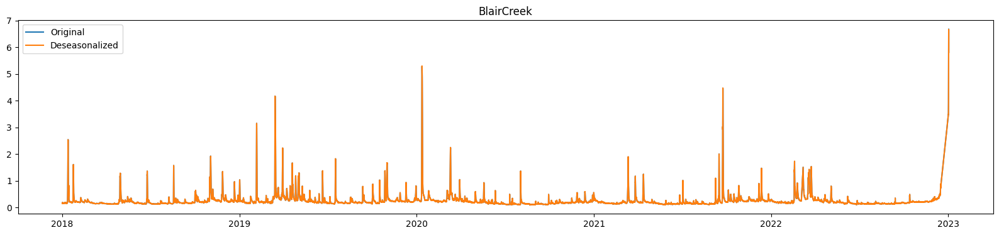

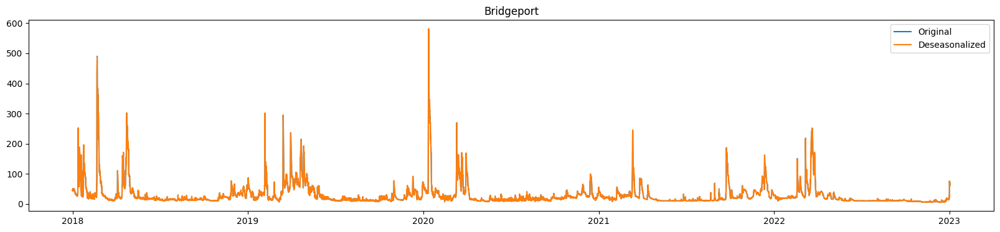

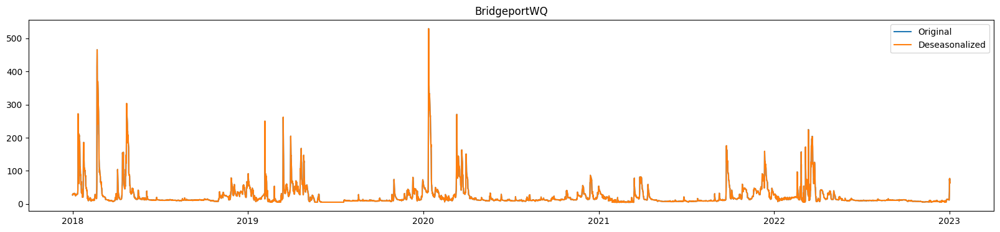

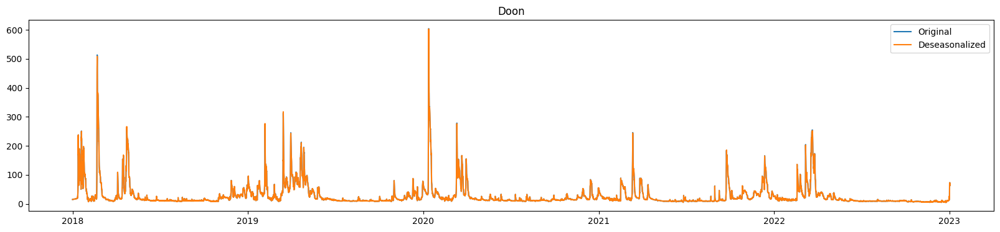

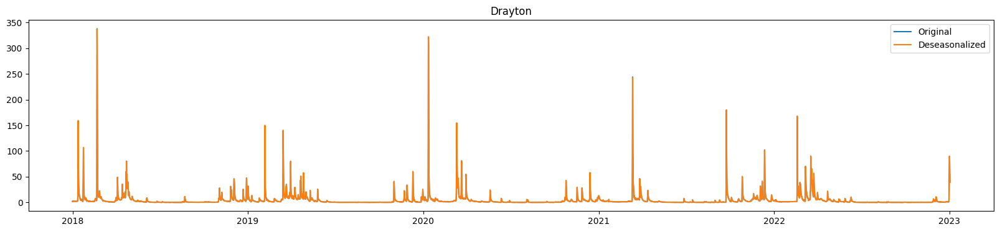

...

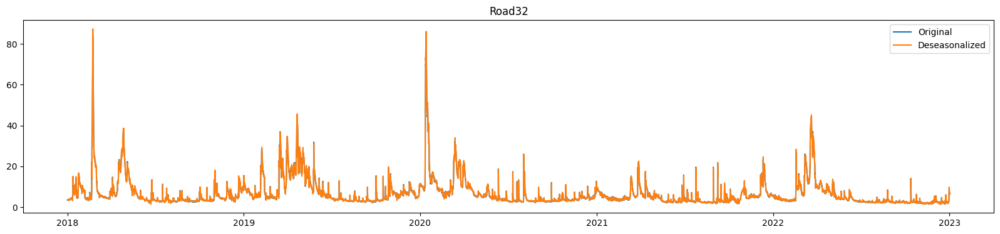

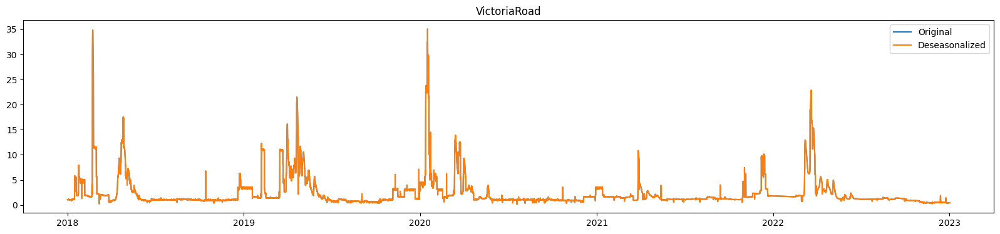

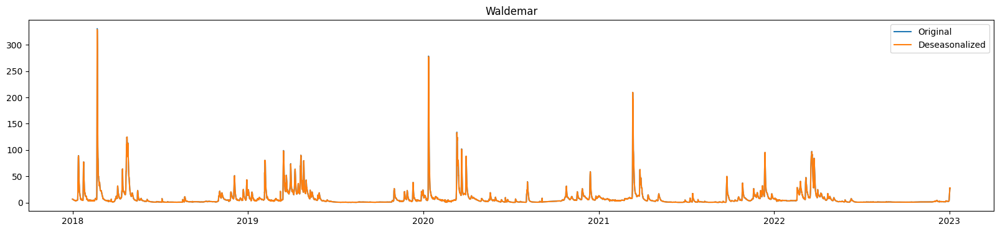

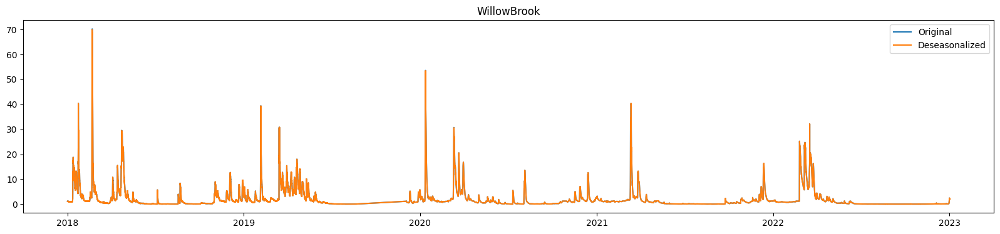

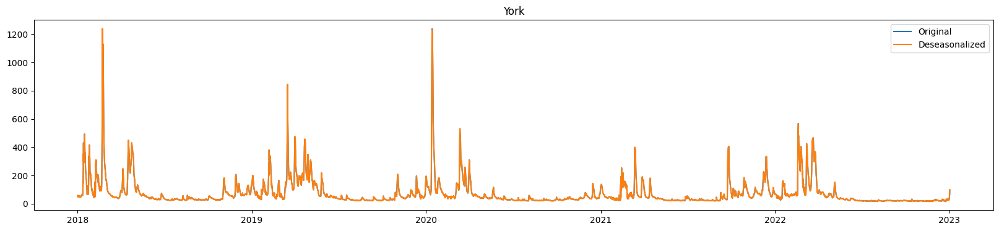

In [ ]:
for i in range(0, len(river_flow.columns)):
  result_mul = seasonal_decompose(river_flow.iloc[:, i], model= "multiplicative", period= 24)
  deseasonalized = river_flow.iloc[:, i].values / result_mul.seasonal
  plt.figure(figsize= (20, 4))
  plt.plot(river_flow.iloc[:, i])
  plt.plot(deseasonalized)
  plt.legend(["Original", "Deseasonalized"])
  plt.title(river_flow.columns[i])

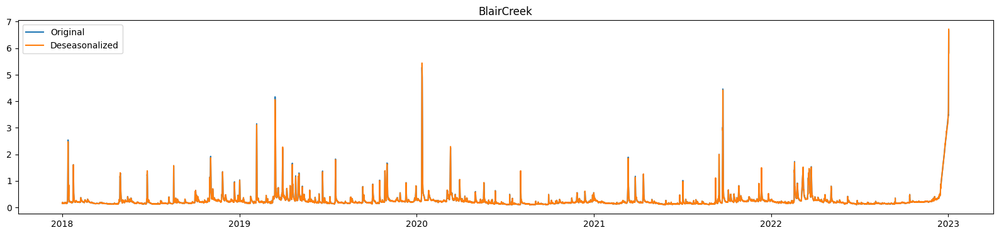

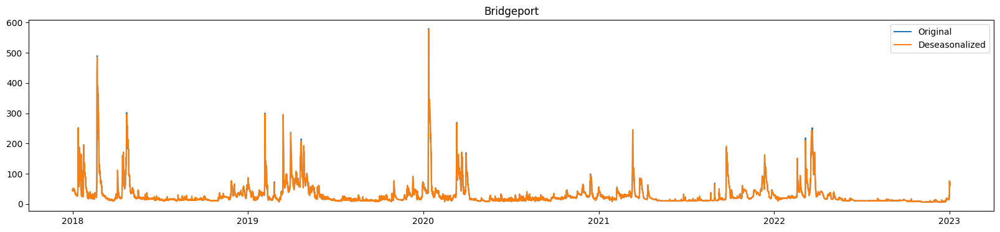

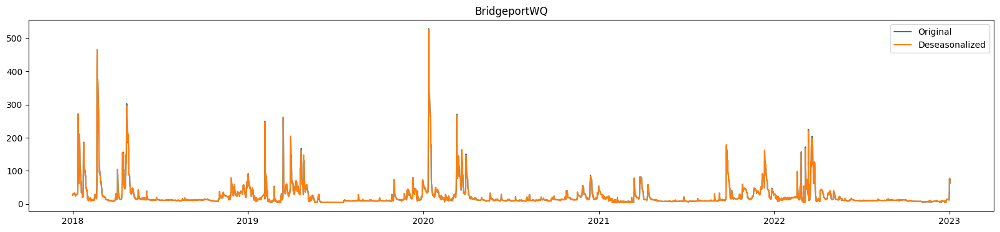

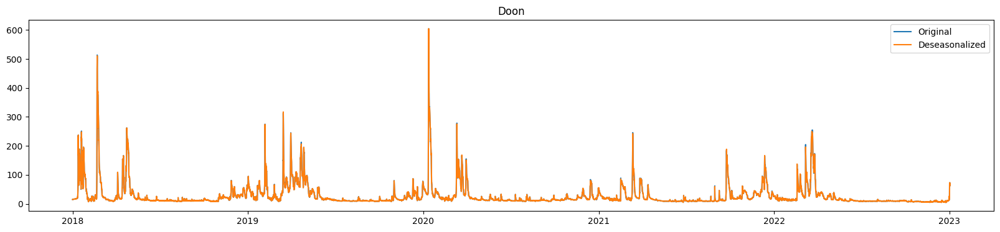

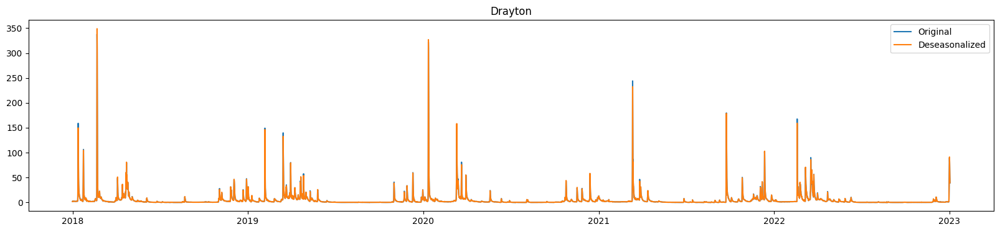

...

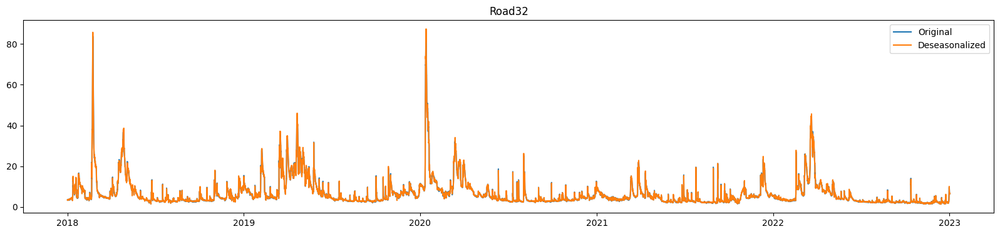

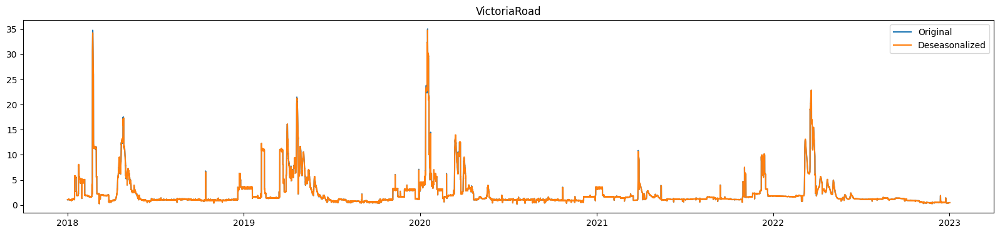

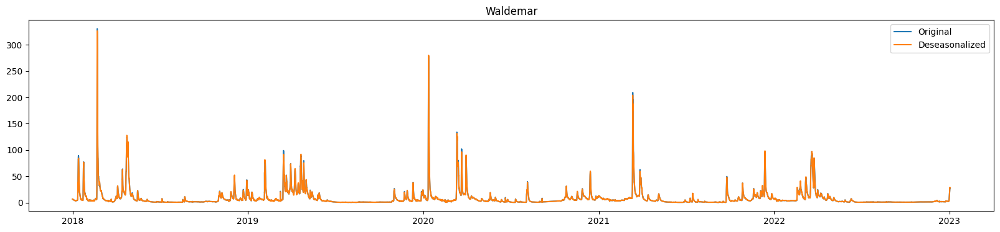

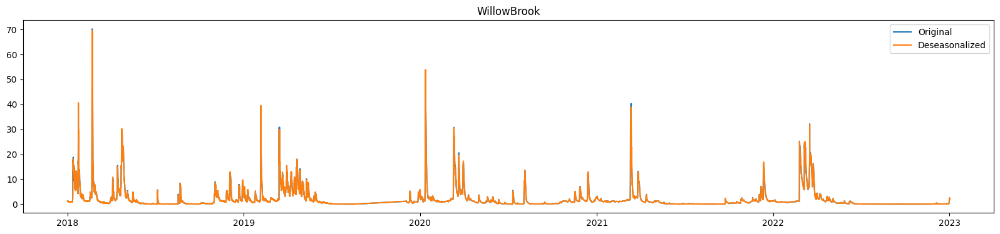

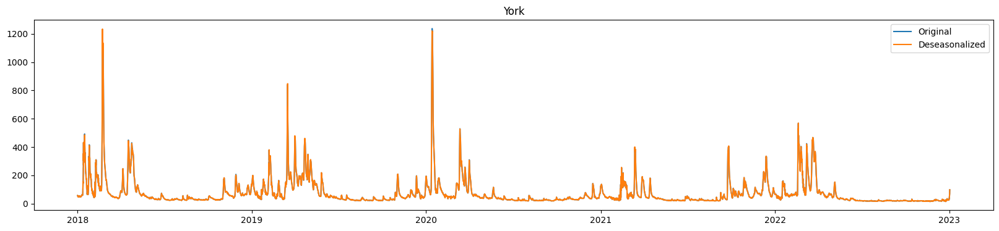

In [ ]:
for i in range(0, len(river_flow.columns)):
  result_mul = seasonal_decompose(river_flow.iloc[:, i], model= "multiplicative", period= 168)
  deseasonalized = river_flow.iloc[:, i].values / result_mul.seasonal
  plt.figure(figsize= (20, 4))
  plt.plot(river_flow.iloc[:, i])
  plt.plot(deseasonalized)
  plt.legend(["Original", "Deseasonalized"])
  plt.title(river_flow.columns[i])

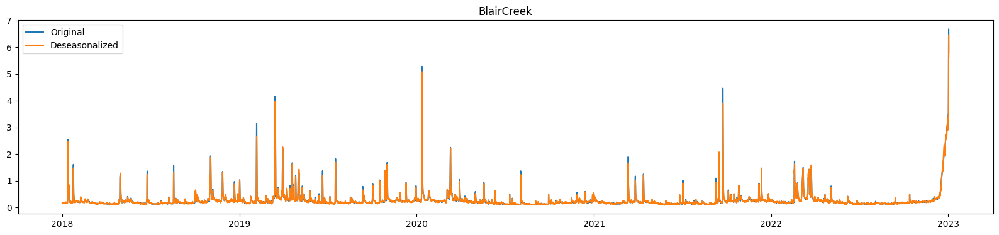

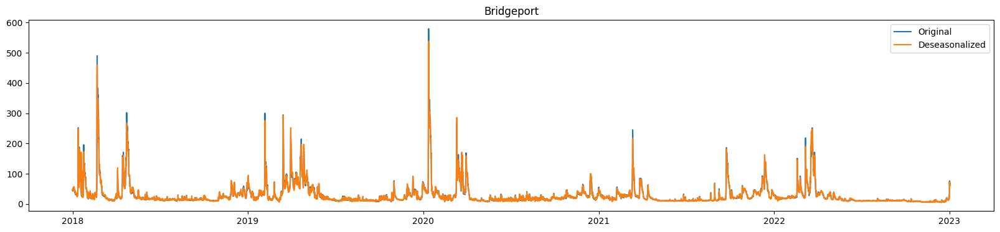

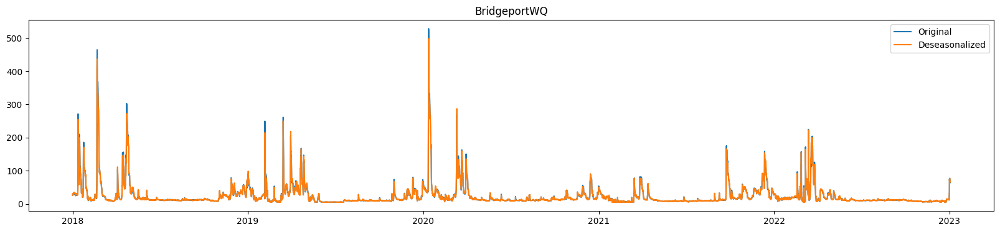

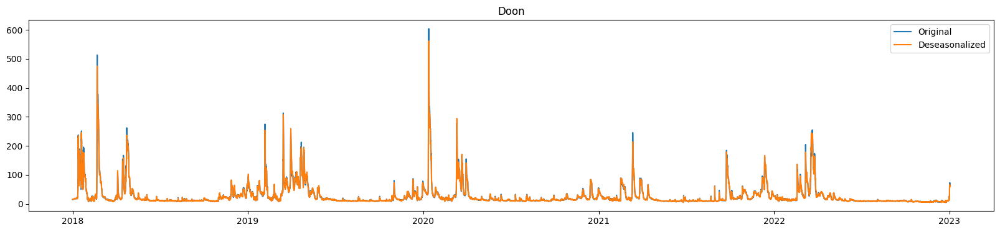

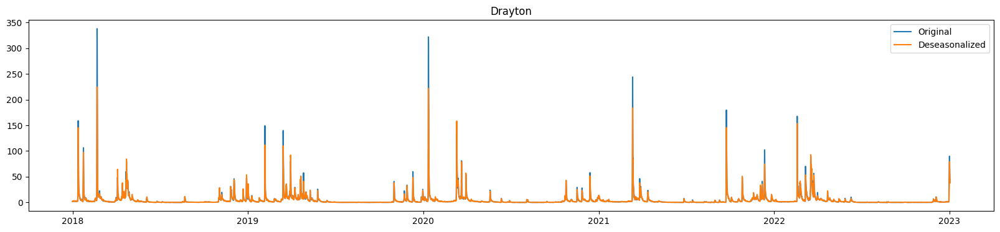

...

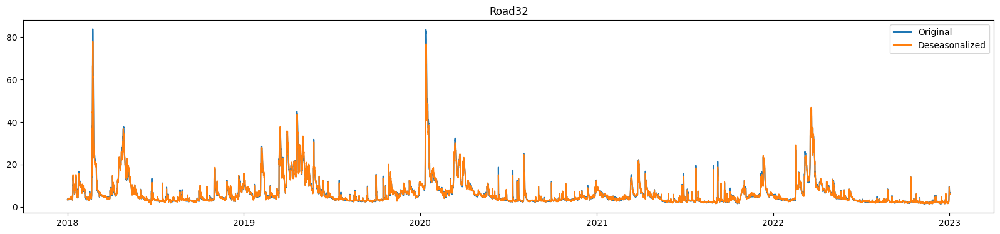

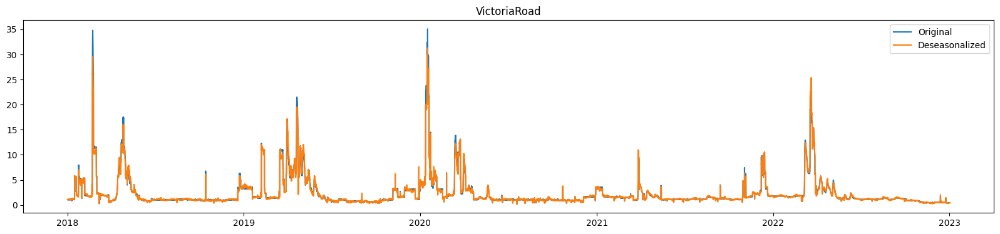

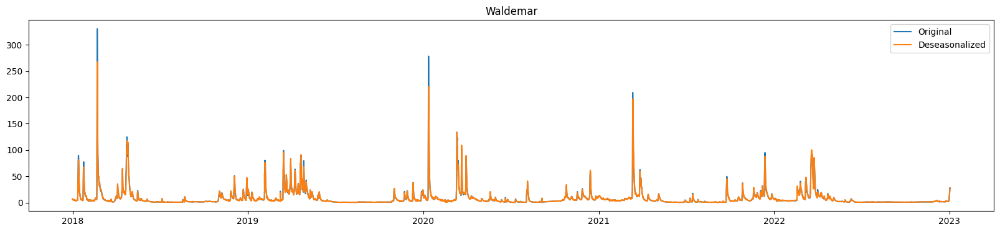

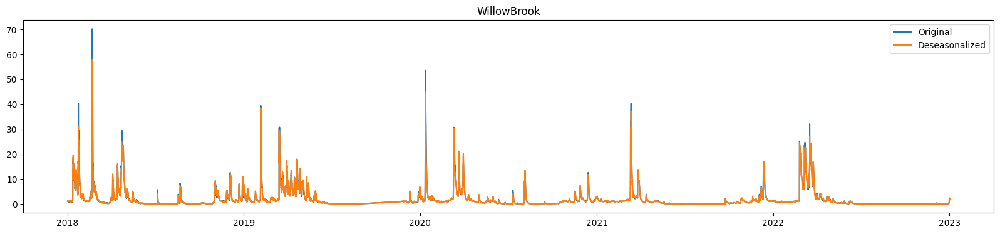

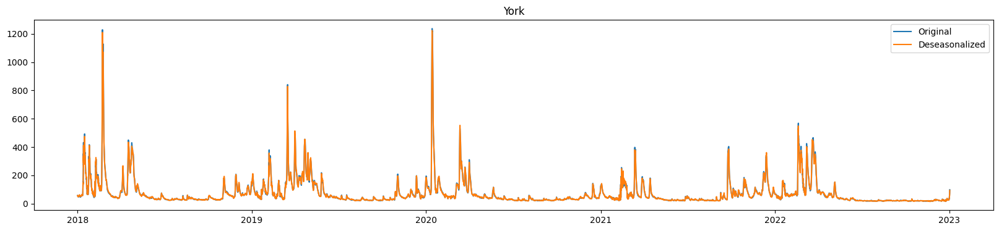

In [ ]:
for i in range(0, len(river_flow.columns)):
  result_mul = seasonal_decompose(river_flow.iloc[:, i], model= "multiplicative", period= 720)
  deseasonalized = river_flow.iloc[:, i].values / result_mul.seasonal
  plt.figure(figsize= (20, 4))
  plt.plot(river_flow.iloc[:, i])
  plt.plot(deseasonalized)
  plt.legend(["Original", "Deseasonalized"])
  plt.title(river_flow.columns[i])

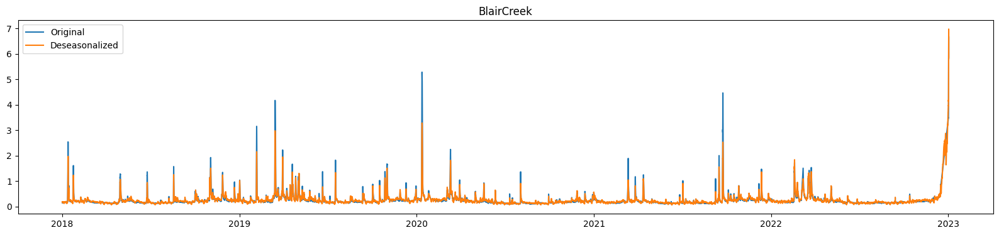

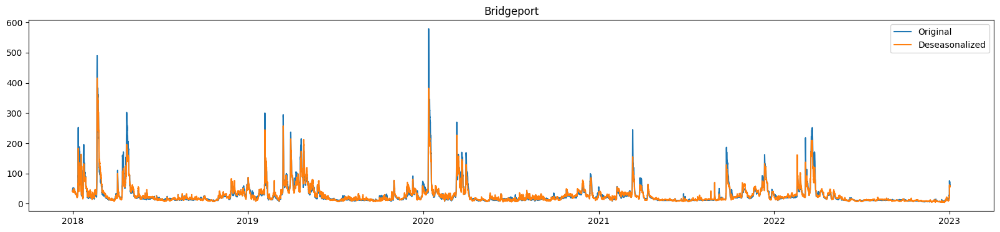

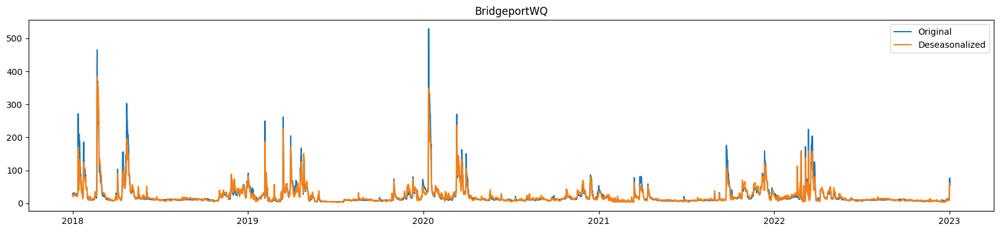

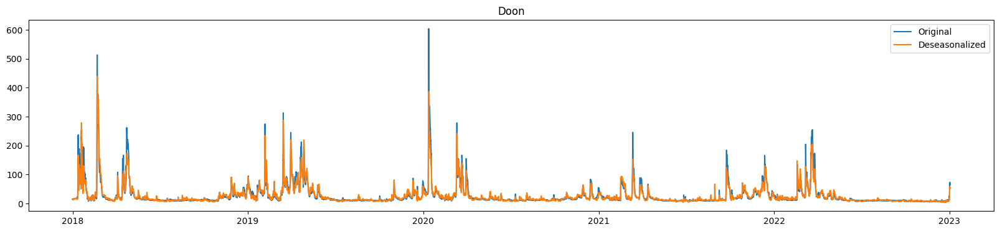

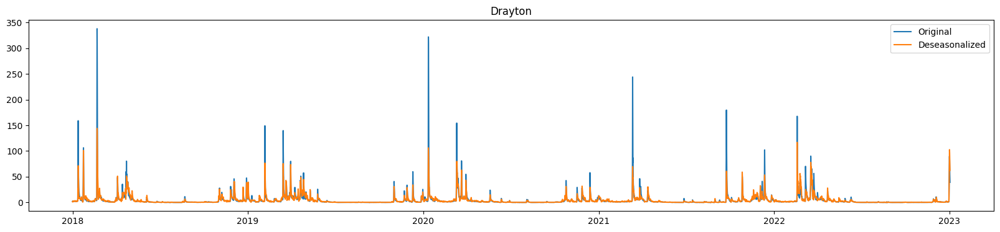

...

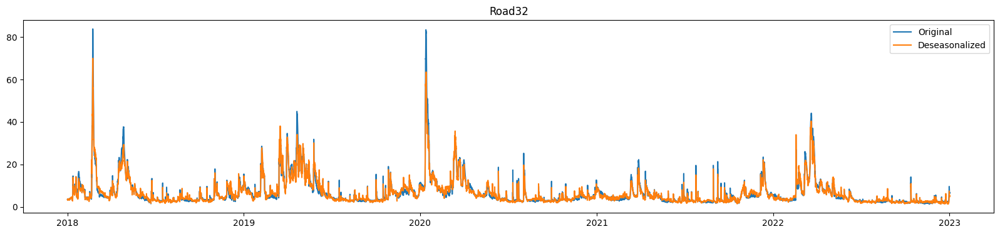

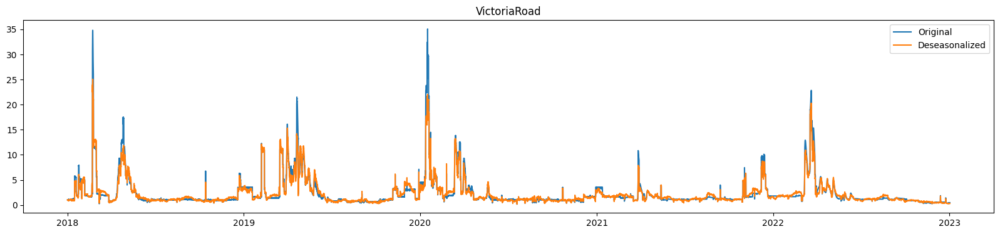

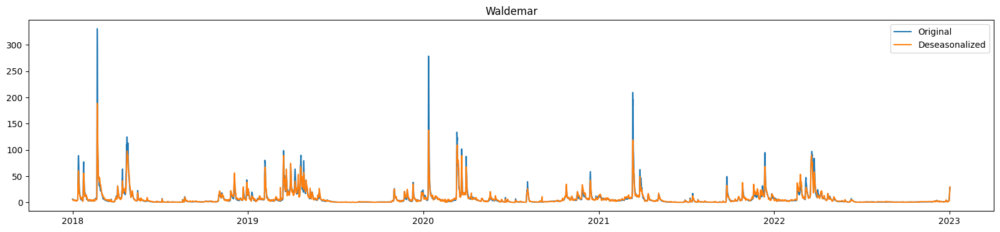

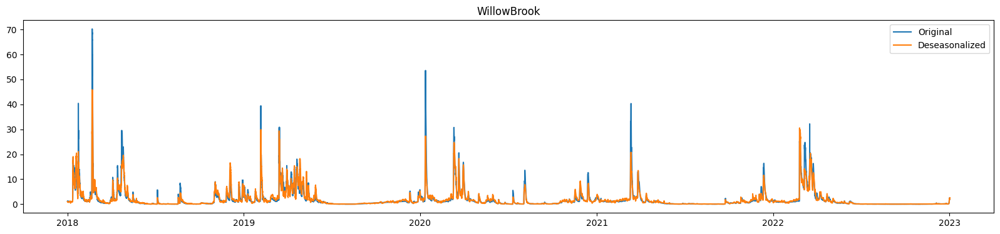

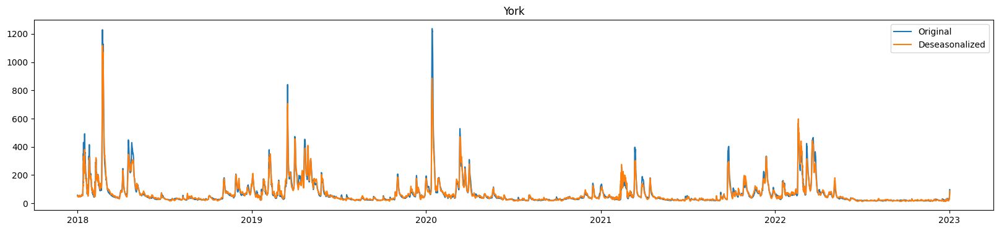

In [ ]:
for i in range(0, len(river_flow.columns)):
  result_mul = seasonal_decompose(river_flow.iloc[:, i], model= "multiplicative", period= 2160)
  deseasonalized = river_flow.iloc[:, i].values / result_mul.seasonal
  plt.figure(figsize= (20, 4))
  plt.plot(river_flow.iloc[:, i])
  plt.plot(deseasonalized)
  plt.legend(["Original", "Deseasonalized"])
  plt.title(river_flow.columns[i])

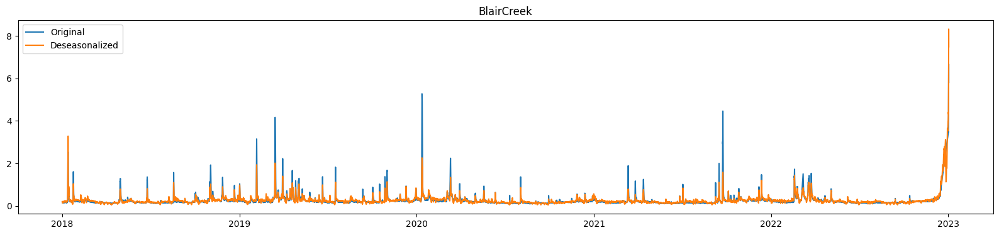

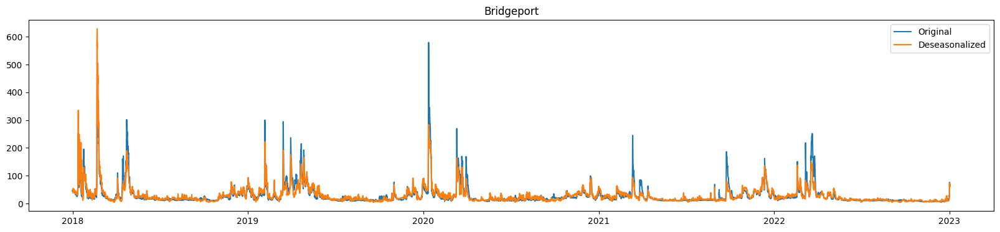

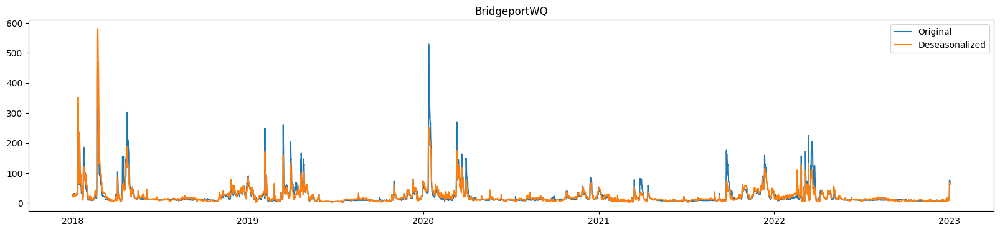

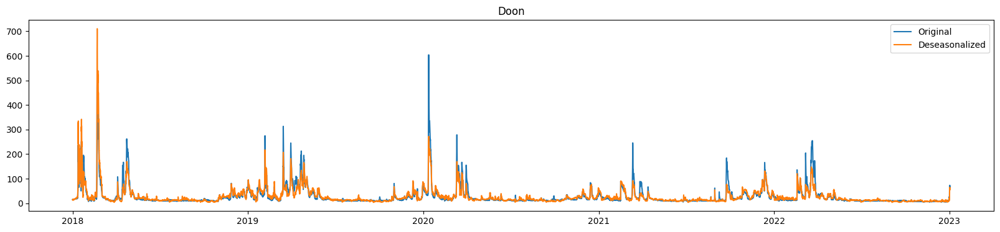

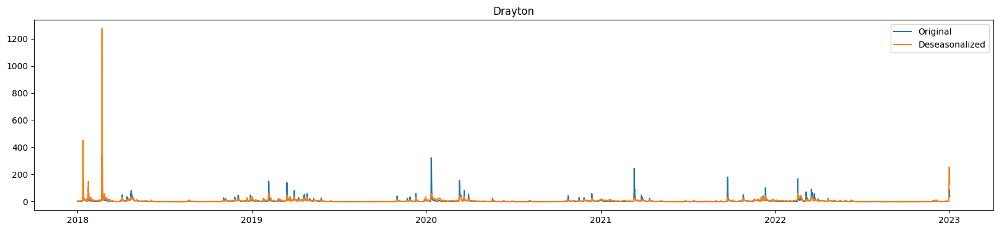

...

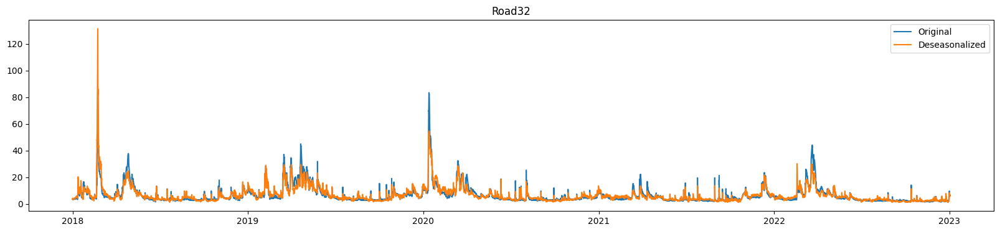

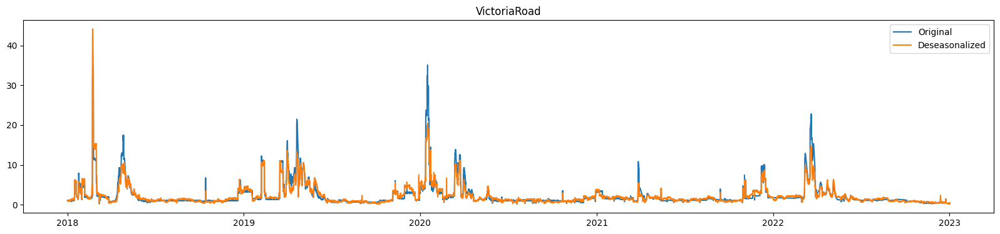

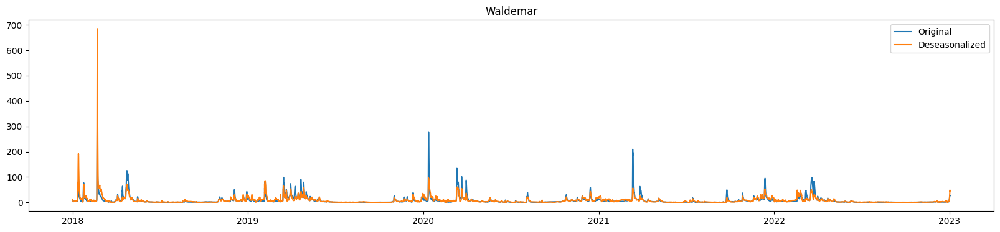

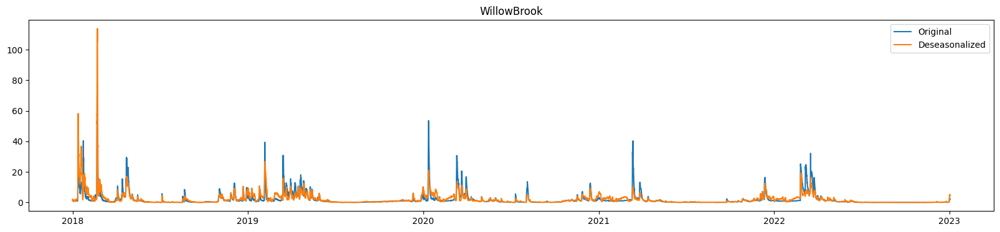

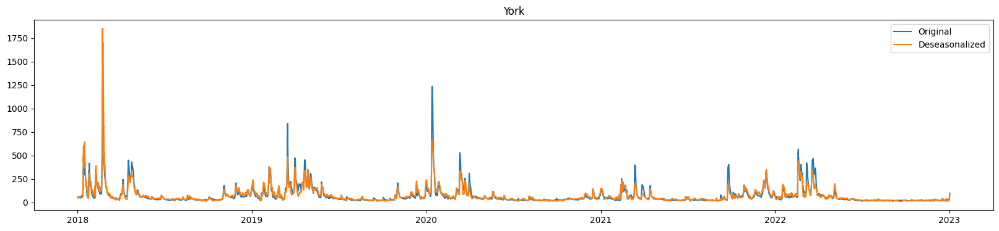

In [ ]:
for i in range(0, len(river_flow.columns)):
  result_mul = seasonal_decompose(river_flow.iloc[:, i], model= "multiplicative", period= 4320)
  deseasonalized = river_flow.iloc[:, i].values / result_mul.seasonal
  plt.figure(figsize= (20, 4))
  plt.plot(river_flow.iloc[:, i])
  plt.plot(deseasonalized)
  plt.legend(["Original", "Deseasonalized"])
  plt.title(river_flow.columns[i])

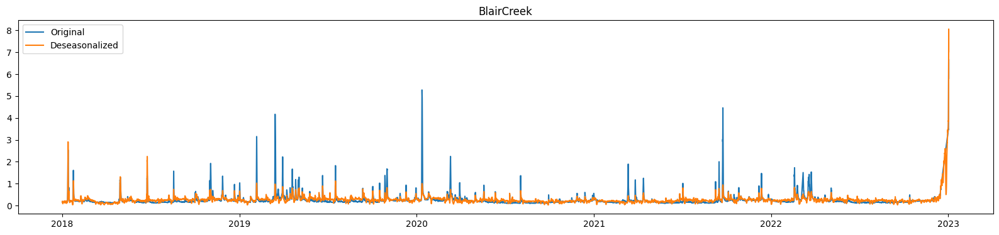

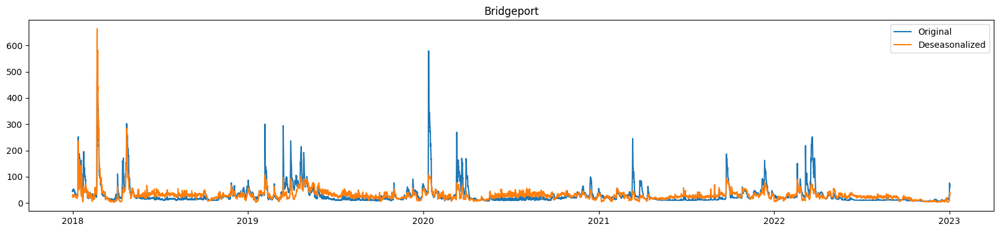

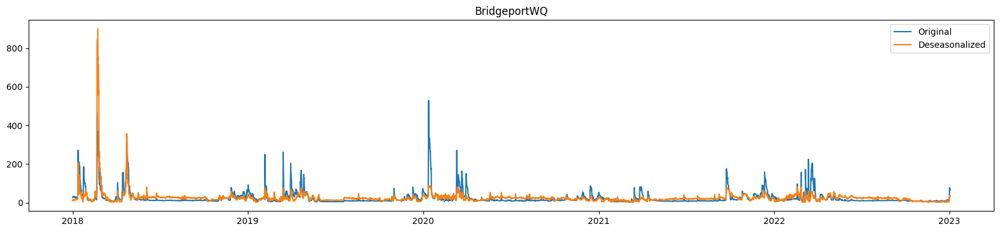

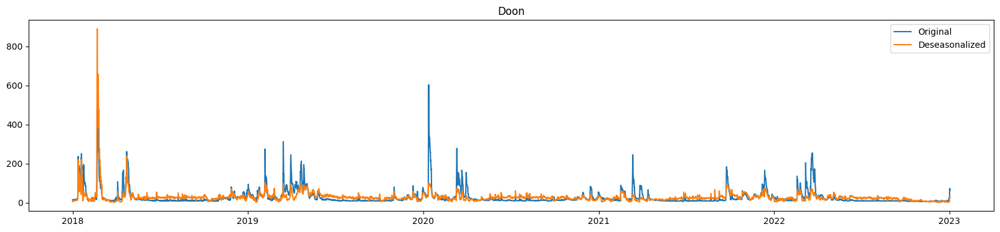

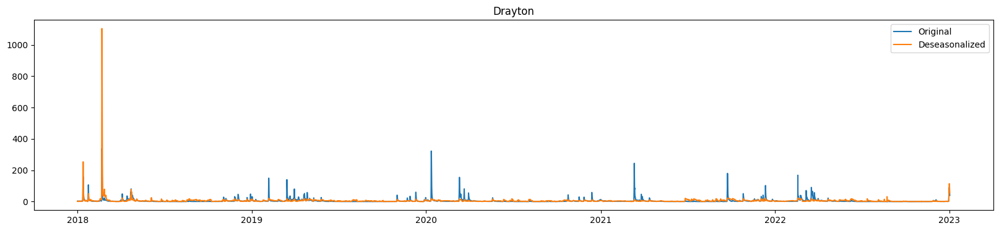

...

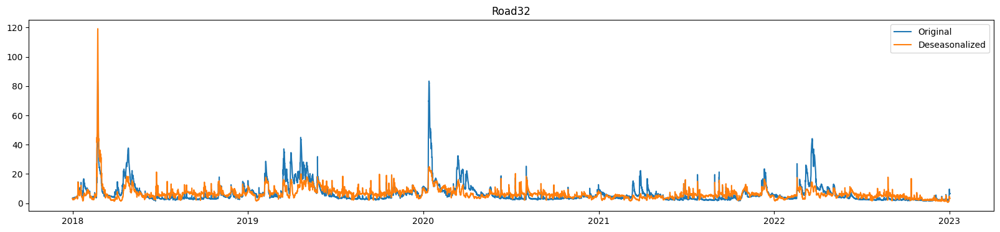

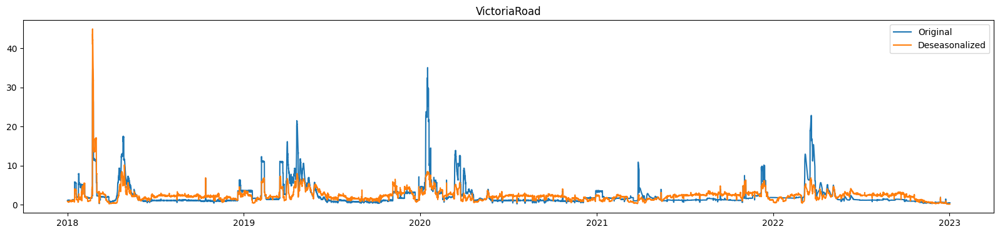

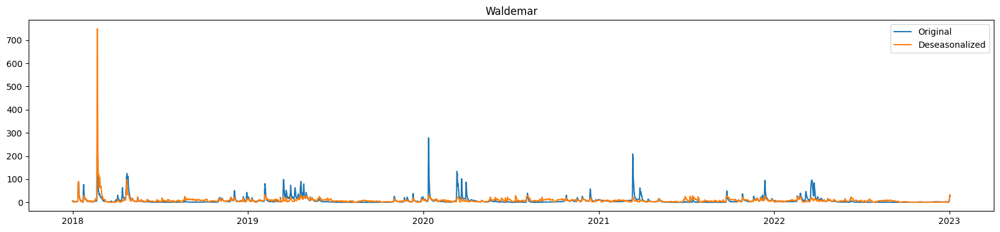

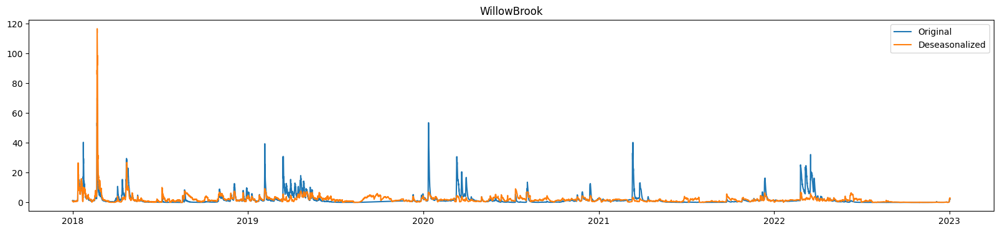

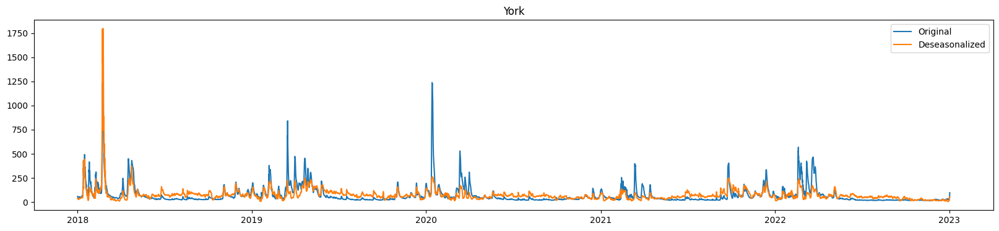

In [ ]:
for i in range(0, len(river_flow.columns)):
  result_mul = seasonal_decompose(river_flow.iloc[:, i], model= "multiplicative", period= 8640)
  deseasonalized = river_flow.iloc[:, i].values / result_mul.seasonal
  plt.figure(figsize= (20, 4))
  plt.plot(river_flow.iloc[:, i])
  plt.plot(deseasonalized)
  plt.legend(["Original", "Deseasonalized"])
  plt.title(river_flow.columns[i])

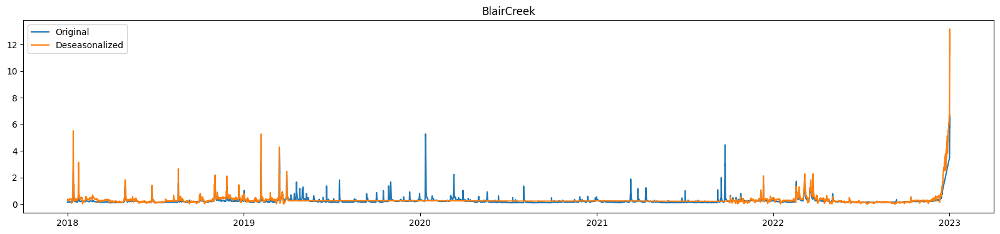

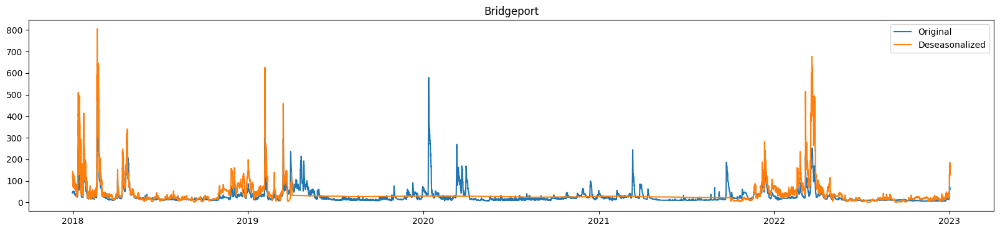

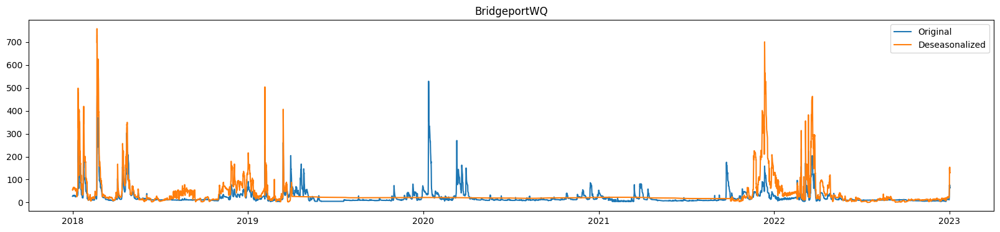

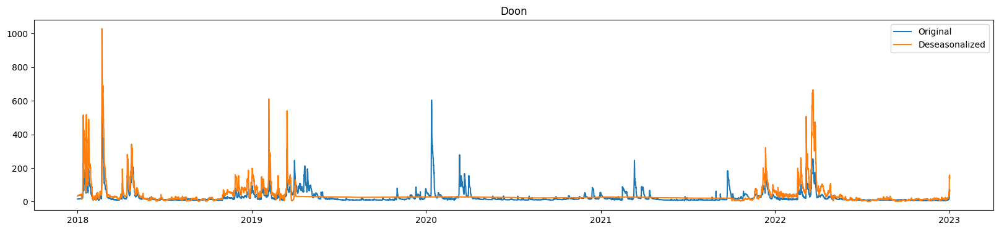

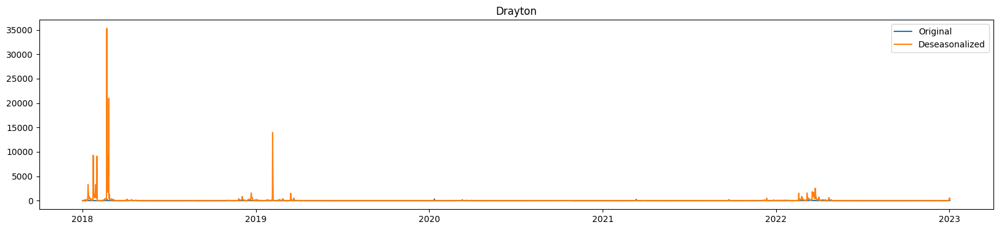

...

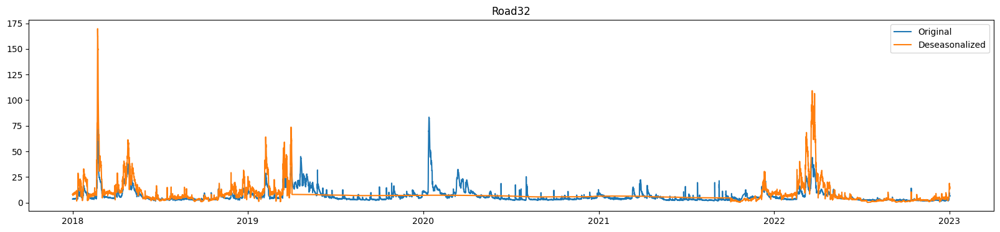

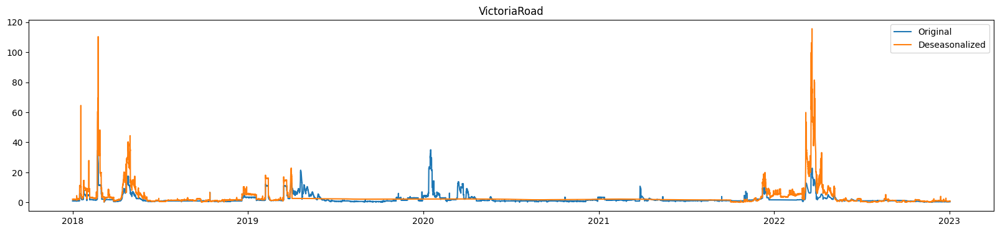

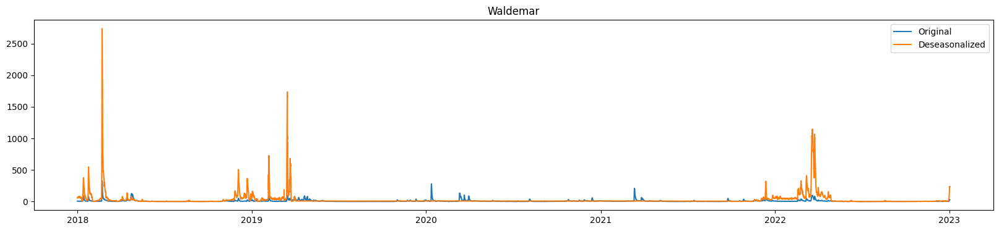

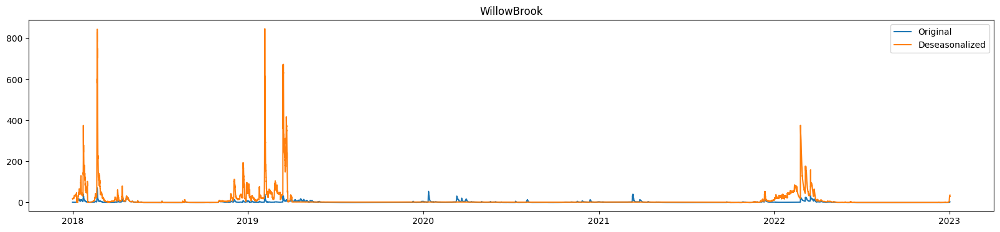

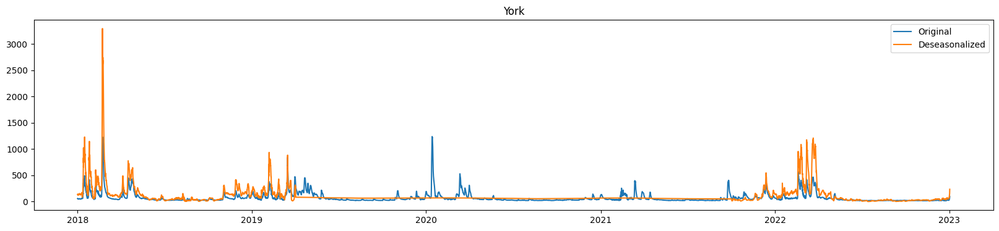

In [ ]:
for i in range(0, len(river_flow.columns)):
  result_mul = seasonal_decompose(river_flow.iloc[:, i], model= "multiplicative", period= 21924)
  deseasonalized = river_flow.iloc[:, i].values / result_mul.seasonal
  plt.figure(figsize= (20, 4))
  plt.plot(river_flow.iloc[:, i])
  plt.plot(deseasonalized)
  plt.legend(["Original", "Deseasonalized"])
  plt.title(river_flow.columns[i])

# **Testing for Seasonality**

The common way to test for seasonality of a time series is to plot the series and check for repeatable patterns in fixed time intervales. So, the type of seasonality is determined by the clock or the calendar.
1. Hour of the day
2. Day of the month
3. Weekly
4. Monthly
5. Yearly

However, if we want a more definitive inspection of the seasonality, we can use the **Autocorrelation Function (ACF) plot**. There is a strong seasonal pattern, the ACF plot usually reveals definitive repeated spikes at the multiples of the seasonal window.

<Axes: xlabel='Lag', ylabel='Autocorrelation'>

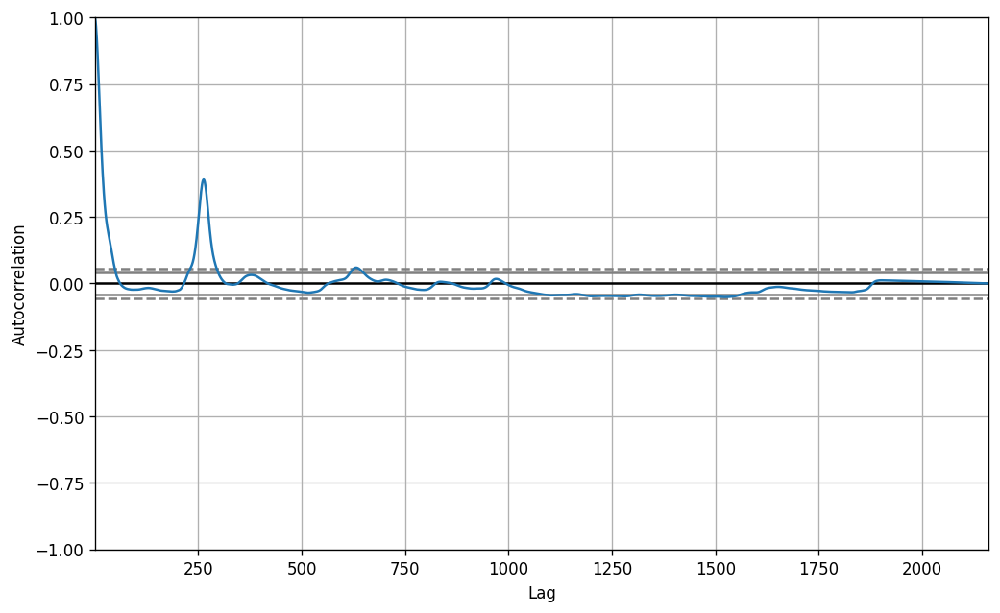

In [ ]:
# Test for seasonality
from pandas.plotting import autocorrelation_plot

# Draw Plot
plt.rcParams.update({'figure.figsize':(10,6), 'figure.dpi':120})
autocorrelation_plot(river_flow.iloc[:2160, 0].tolist())

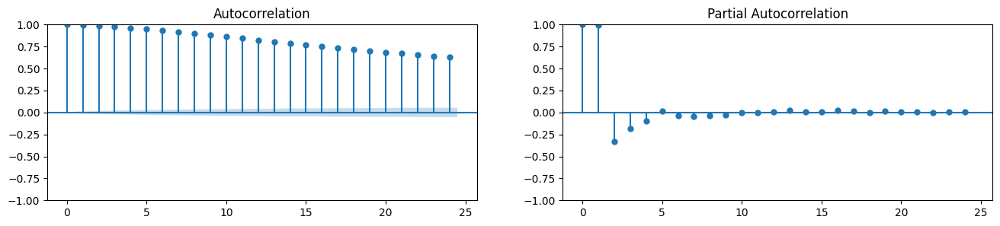

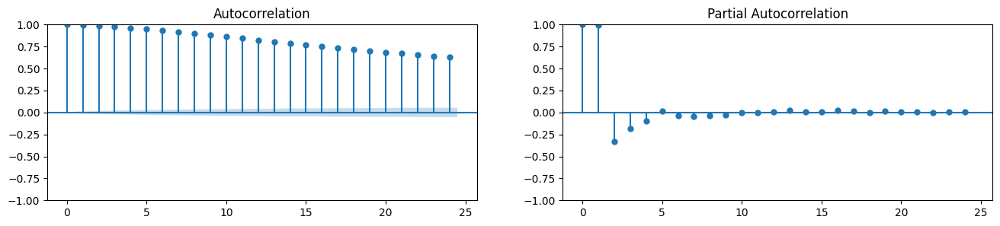

In [ ]:
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Draw Plot
fig, axes = plt.subplots(1,2,figsize=(16,3), dpi= 100)
plot_acf(river_flow.iloc[:, 0].tolist(), lags=24, ax=axes[0])
plot_pacf(river_flow.iloc[:, 0].tolist(), lags=24, ax=axes[1])

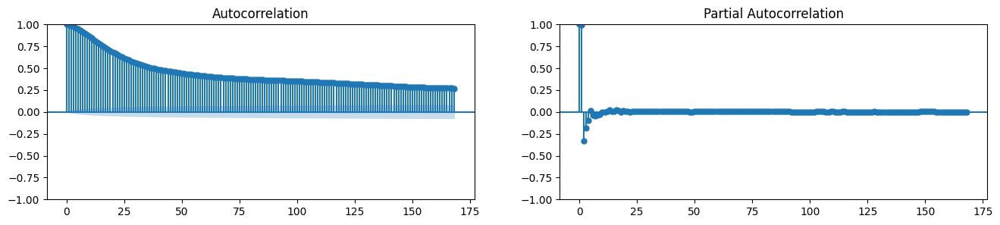

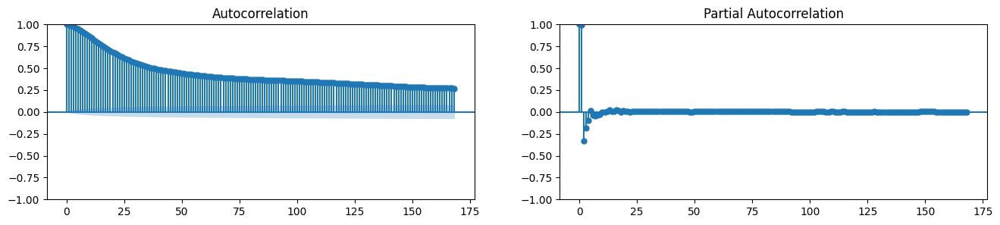

In [ ]:
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Draw Plot
fig, axes = plt.subplots(1,2,figsize=(16,3), dpi= 100)
plot_acf(river_flow.iloc[:, 0].tolist(), lags=168, ax=axes[0])
plot_pacf(river_flow.iloc[:, 0].tolist(), lags=168, ax=axes[1])

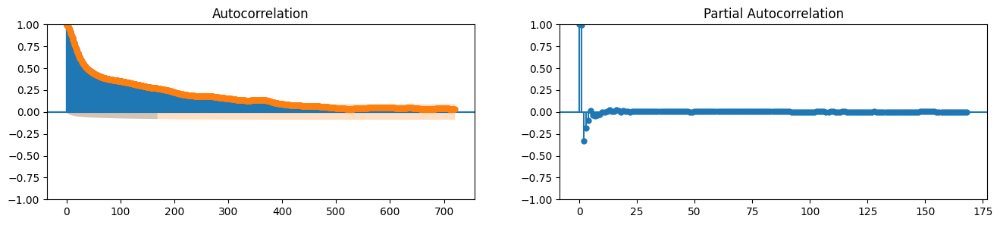

In [ ]:
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Draw Plot
fig, axes = plt.subplots(1,2,figsize=(16,3), dpi= 100)
plot_acf(river_flow.iloc[:, 0].tolist(), lags=720, ax=axes[0])
plot_pacf(river_flow.iloc[:, 0].tolist(), lags=720, ax=axes[1])

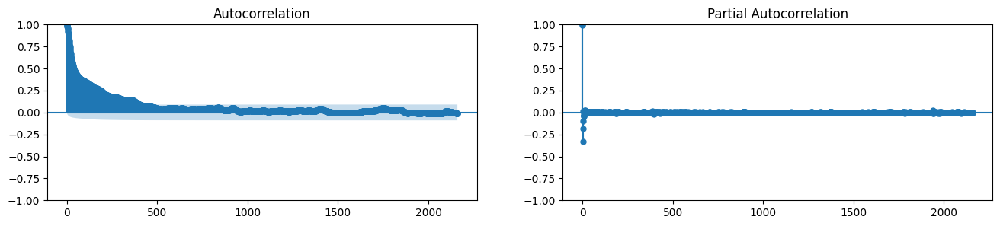

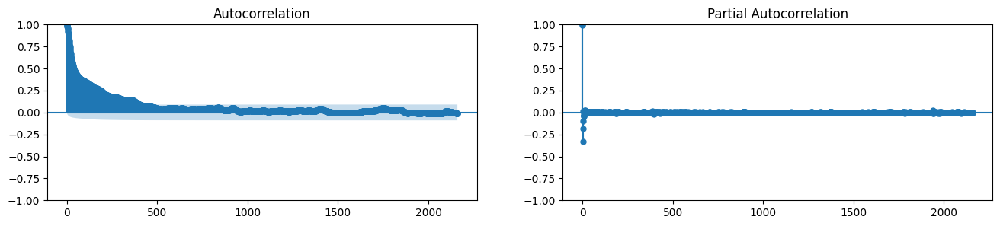

In [ ]:
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Draw Plot
fig, axes = plt.subplots(1,2,figsize=(16,3), dpi= 100)
plot_acf(river_flow.iloc[:, 0].tolist(), lags=2160, ax=axes[0])
plot_pacf(river_flow.iloc[:, 0].tolist(), lags=2160, ax=axes[1])

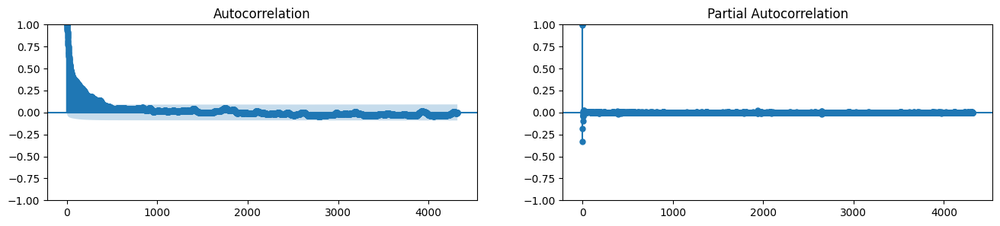

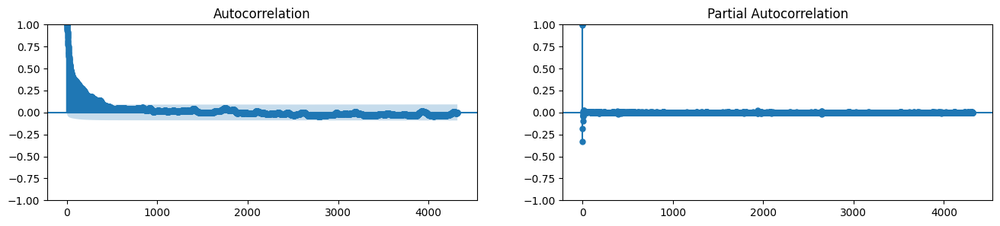

In [ ]:
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Draw Plot
fig, axes = plt.subplots(1,2,figsize=(16,3), dpi= 100)
plot_acf(river_flow.iloc[:, 0].tolist(), lags=4320, ax=axes[0])
plot_pacf(river_flow.iloc[:, 0].tolist(), lags=4320, ax=axes[1])

# **Granger Causality Test**

This test is used to determine if one time series will be usefull to forecast another. It is based on the idea that if X causes Y, then the forecast to Y based on previous values of Y and the previous values of X should outperform the forecast of Y based on previous values of Y alone.

In [ ]:
from statsmodels.tsa.stattools import grangercausalitytests
from datetime import datetime

In [ ]:
river_flow_copy = river_flow.copy()
river_flow_copy["month"] = pd.DatetimeIndex(river_flow_copy.index).month

In [ ]:
river_flow_copy

,BlairCreek,Bridgeport,BridgeportWQ,Doon,Drayton,Elmira,Erbsville,Keldon,Leggatt,MillCreek,Moorefield,Phillipsburg,Road32,VictoriaRoad,Waldemar,WillowBrook,York,month
Timestamp,,,,,,,,,,,,,,,,,,
2018-01-01 00:00:00,0.162000,44.202684,26.932000,15.136015,1.633473,0.6800,0.135527,1.207453,2.940143,0.898000,0.883397,2.394857,3.568644,1.059240,6.571770,1.142622,56.884066,1
2018-01-01 01:00:00,0.162000,44.040912,26.825400,15.150000,1.611479,0.6800,0.135047,1.223004,2.957151,0.902000,0.887479,2.416549,3.634335,1.066568,6.589006,1.123353,55.332323,1
2018-01-01 02:00:00,0.162250,44.404860,26.710600,15.163985,1.615141,0.6800,0.135527,1.230818,2.962889,0.898000,0.887479,2.387635,3.688094,1.051899,6.554596,1.156076,54.987491,1
2018-01-01 03:00:00,0.156458,44.040912,26.620400,15.177970,1.607817,0.6800,0.136970,1.230835,2.957201,0.902000,0.888838,2.380400,3.697868,1.055549,6.545890,1.156076,54.987491,1
2018-01-01 04:00:00,0.149000,44.121798,26.612200,15.191955,1.589485,0.6800,0.135047,1.223056,2.957189,0.902000,0.888838,2.344251,3.683207,1.059232,6.537265,1.156076,54.987491,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-01-01 19:00:00,6.112500,63.906250,66.752000,69.145801,44.066383,3.1520,0.462402,11.259375,27.373467,2.099606,13.084098,61.677028,6.587513,0.456600,26.698283,1.973442,70.339806,1
2023-01-01 20:00:00,6.677500,62.625000,65.328000,67.147994,42.725918,3.1205,0.433461,10.779167,26.982467,2.065631,12.854528,58.653723,6.661228,0.456600,26.765158,2.023615,77.500000,1
2023-01-01 21:00:00,6.511250,61.468750,63.942500,66.370603,41.430100,3.0890,0.410553,10.689583,26.656740,2.033860,12.601612,55.564362,6.686446,0.456600,26.984320,2.150197,86.687500,1


In [ ]:
river_flow_copy[["York", "month"]]

,York,month
Timestamp,,
2018-01-01 00:00:00,56.884066,1
2018-01-01 01:00:00,55.332323,1
2018-01-01 02:00:00,54.987491,1
2018-01-01 03:00:00,54.987491,1
2018-01-01 04:00:00,54.987491,1
...,...,...
2023-01-01 19:00:00,70.339806,1
2023-01-01 20:00:00,77.500000,1
2023-01-01 21:00:00,86.687500,1


In [ ]:
for i in range(0, len(river_flow.columns)):
  print("For : ", river_flow.columns[i])
  grangercausalitytests(river_flow_copy[[river_flow_copy.columns[i], "month"]], maxlag= 24)
  print("\n\n")

For :  BlairCreek

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.2095  , p=0.6472  , df_denom=43844, df_num=1
ssr based chi2 test:   chi2=0.2095  , p=0.6472  , df=1
likelihood ratio test: chi2=0.2095  , p=0.6472  , df=1
parameter F test:         F=0.2095  , p=0.6472  , df_denom=43844, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=2.4369  , p=0.0874  , df_denom=43841, df_num=2
ssr based chi2 test:   chi2=4.8743  , p=0.0874  , df=2
likelihood ratio test: chi2=4.8741  , p=0.0874  , df=2
parameter F test:         F=2.4369  , p=0.0874  , df_denom=43841, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=2.3510  , p=0.0702  , df_denom=43838, df_num=3
ssr based chi2 test:   chi2=7.0540  , p=0.0702  , df=3
likelihood ratio test: chi2=7.0534  , p=0.0702  , df=3
parameter F test:         F=2.3510  , p=0.0702  , df_denom=43838, df_num=3

Granger Causality
number of lags (no zero) 4
ssr based F test: 

It can be seen that almost all the columns' pvalues are less than 0.05 for a lag of 3-4. This means that months granger causes the values of river-flow with a lag of 3-4 months behind.

# **Smoothening the Time Series**

This may be useful in the following circumstances.
1. Reducing the effect of noise in a signal get a fair approximation of the noise-filtered series.
2. The smoothed version of series can be used as a feature to explain the original series itself.
3. visualize the underlying trend better.

We can smoothen a time series using the following methods:
1. Take a moving average
2. Do a LOESS smoothning (Localized Regression)
3. Do a LOWESS smoothning (Locally Weighted Regression)

## **Moving Average**

Moving Average is the average of a rolling window of defined width. We must choose the window-width wisely, because, large window-size will over-smooth the series. For example, a window-size equal to the seasonal duration will effectively nullify the seasonal effect.

In [ ]:
roll = river_flow.rolling(window= 24)
roll_mean = roll.mean()

In [ ]:
roll_mean.head(24)

,BlairCreek,Bridgeport,BridgeportWQ,Doon,Drayton,Elmira,Erbsville,Keldon,Leggatt,MillCreek,Moorefield,Phillipsburg,Road32,VictoriaRoad,Waldemar,WillowBrook,York
Timestamp,,,,,,,,,,,,,,,,,
2018-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 05:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 06:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 07:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 08:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


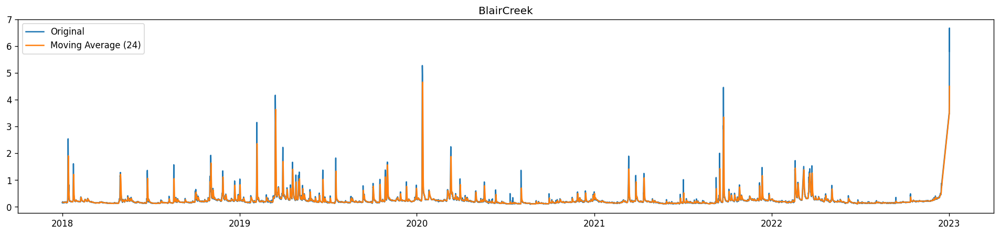

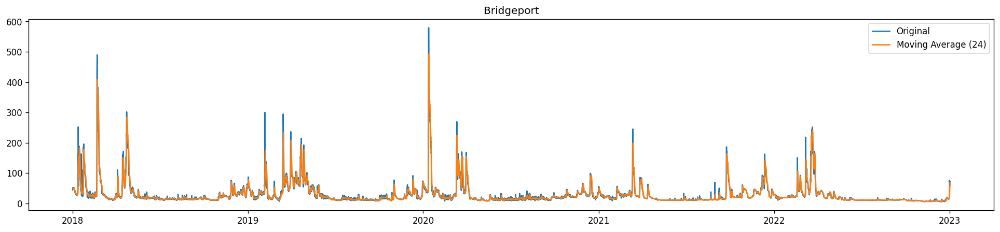

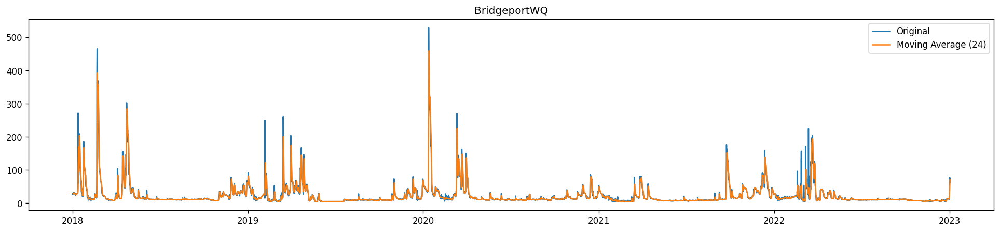

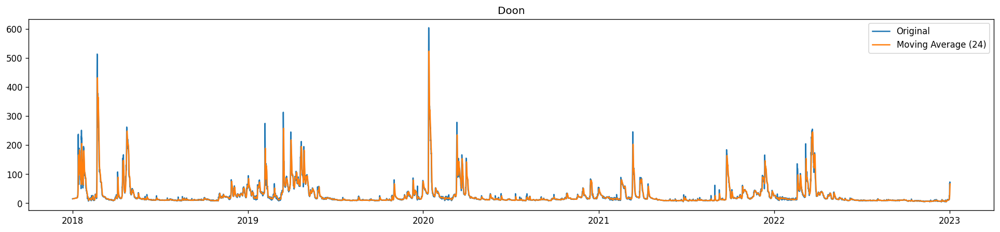

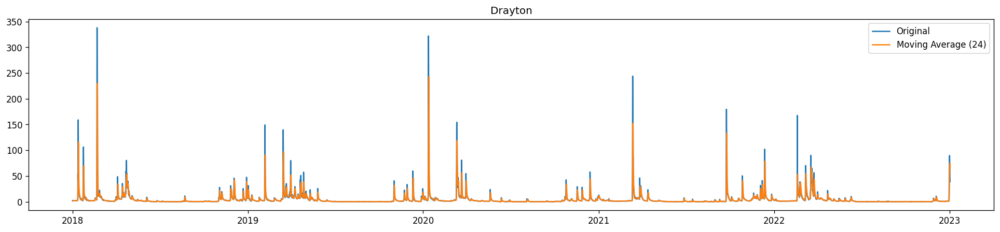

...

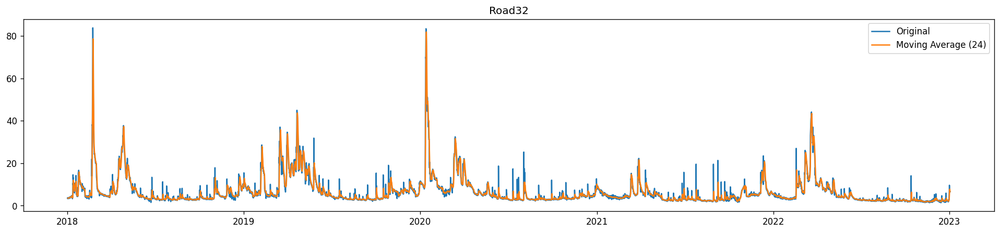

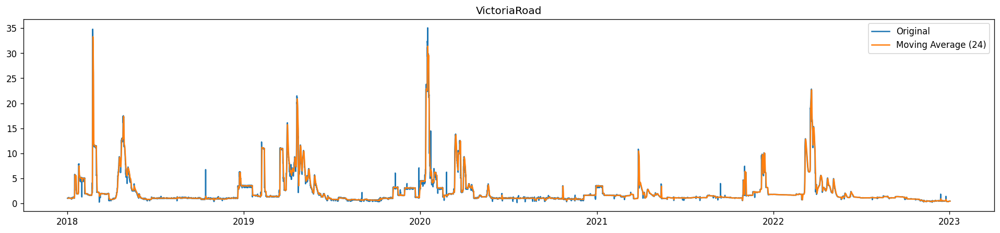

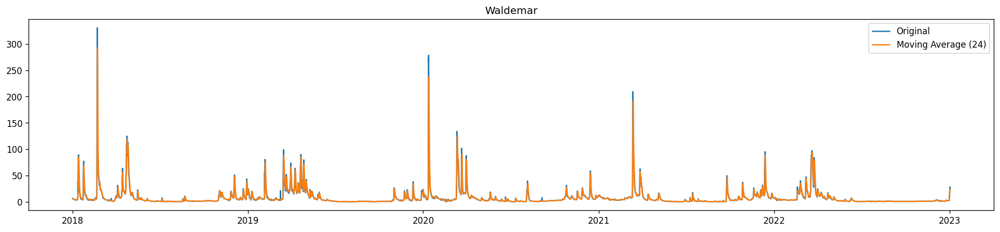

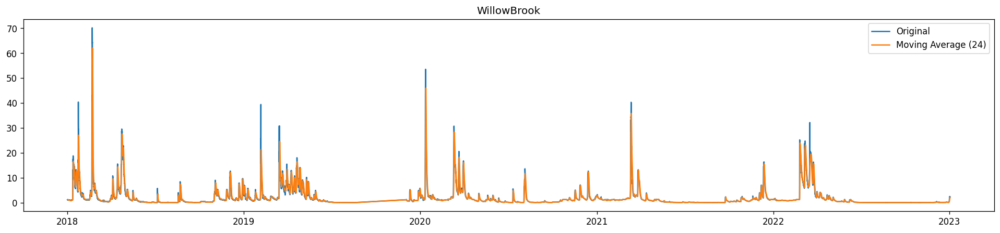

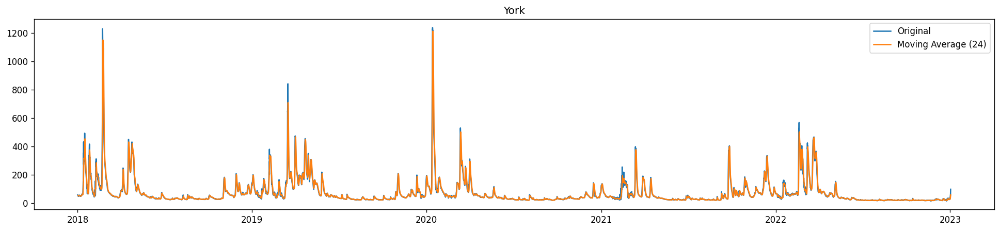

In [ ]:
for i in range(0, len(river_flow.columns)):
  plt.figure(figsize= (20, 4))
  plt.plot(river_flow.iloc[:, i], label= "Original")
  plt.plot(roll_mean.iloc[:, i], label= "Moving Average (24)")
  plt.title(river_flow.columns[i])
  plt.legend()
  plt.show()

## **LOWESS Smoothning**

In [ ]:
from statsmodels.nonparametric.smoothers_lowess import lowess

In [ ]:
river_flow.index.dtype

dtype('<M8[ns]')

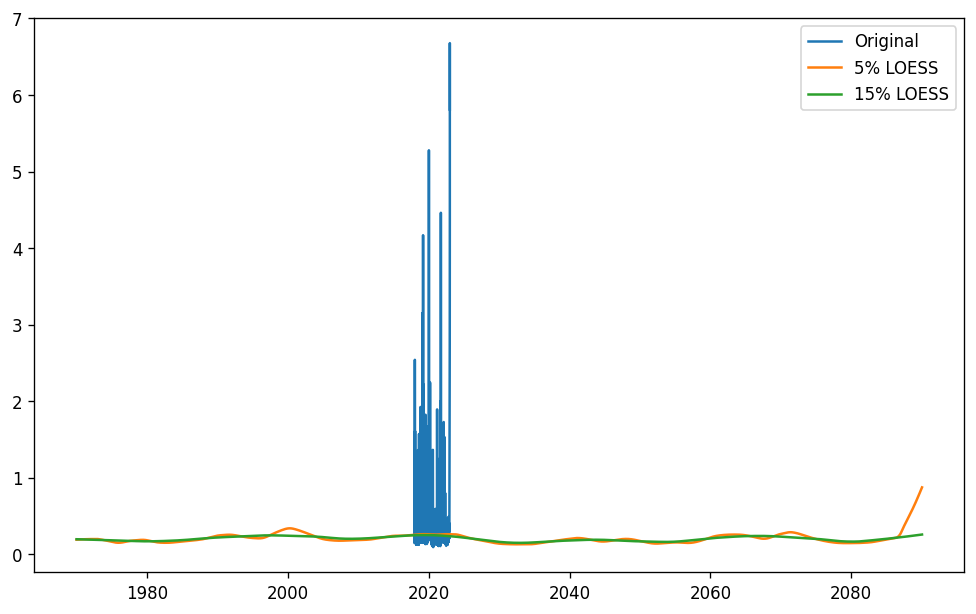

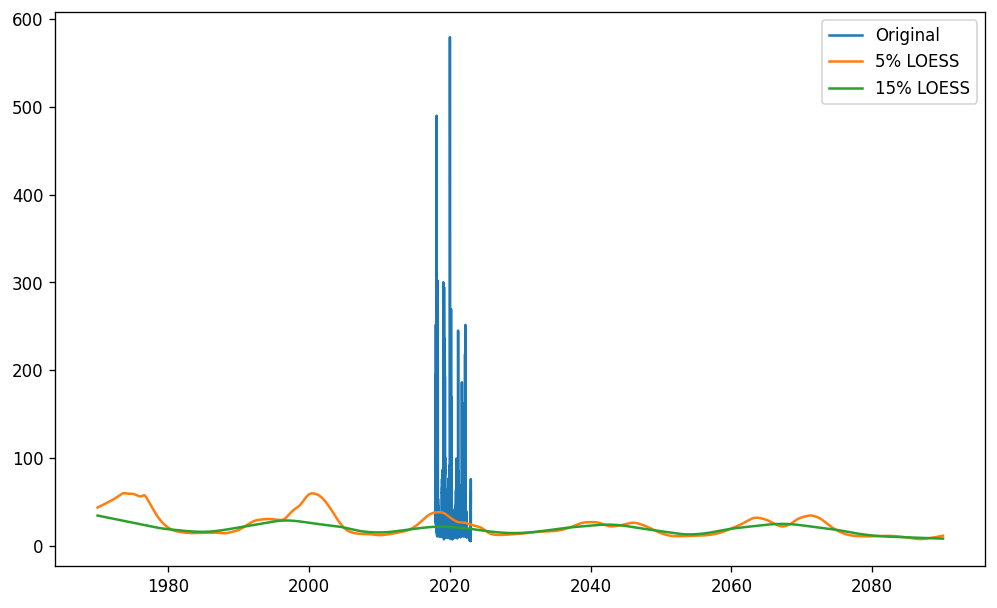

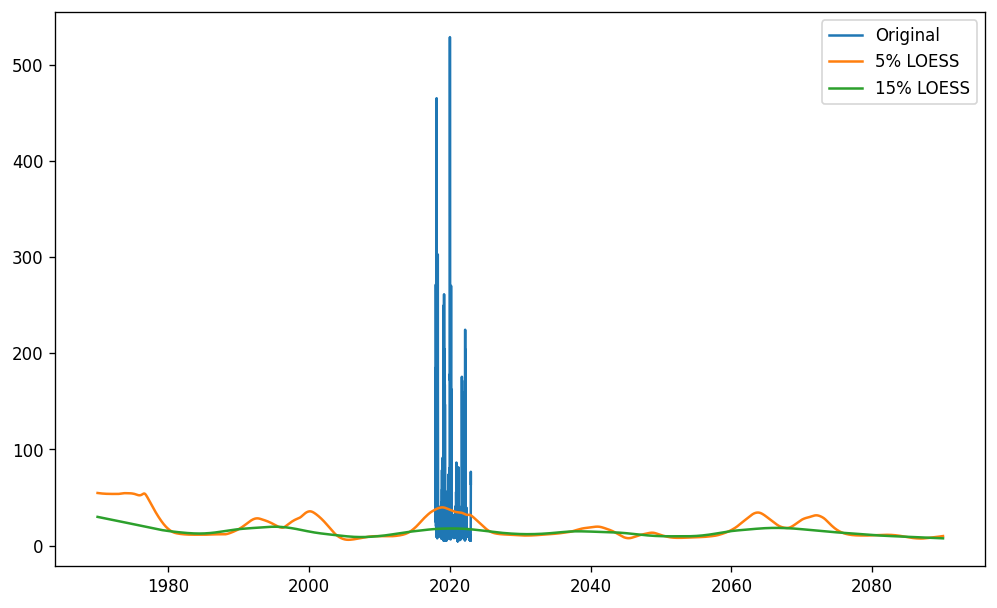

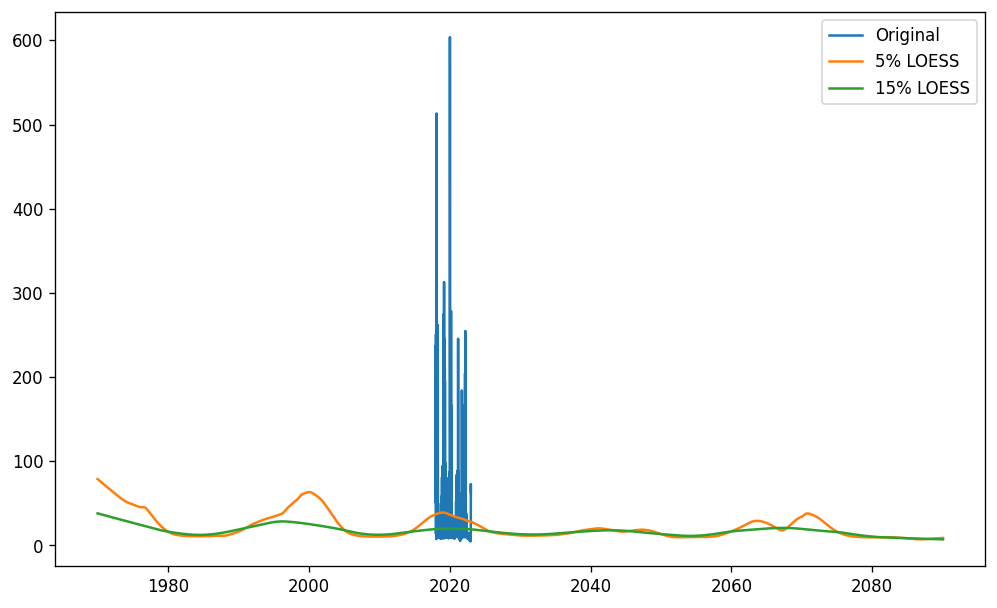

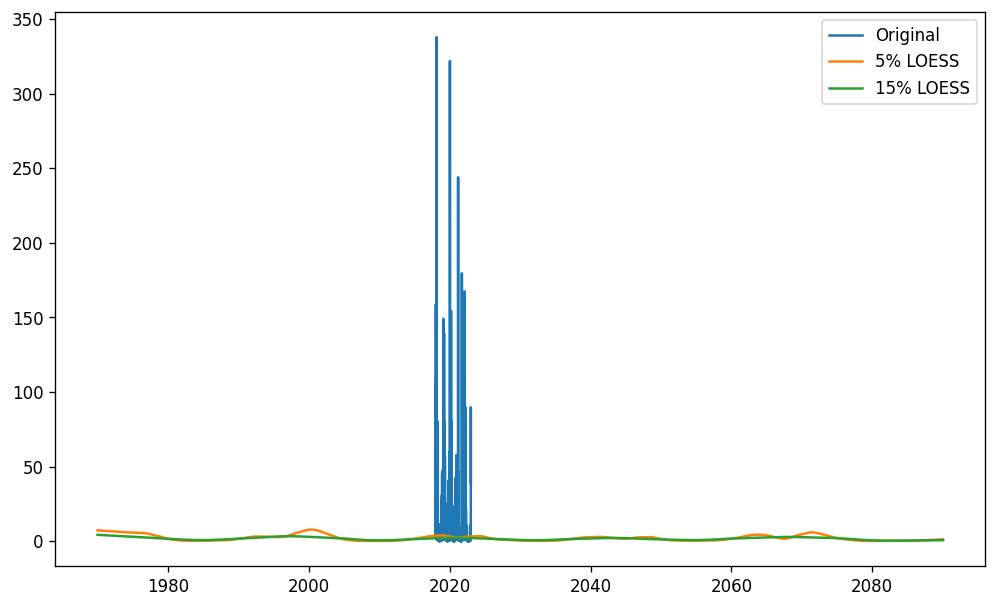

...

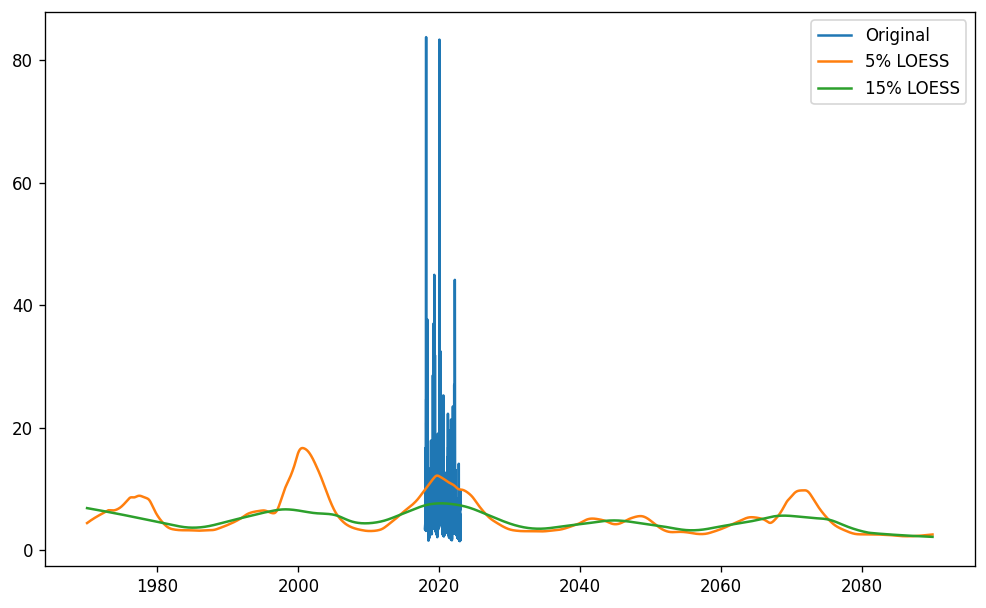

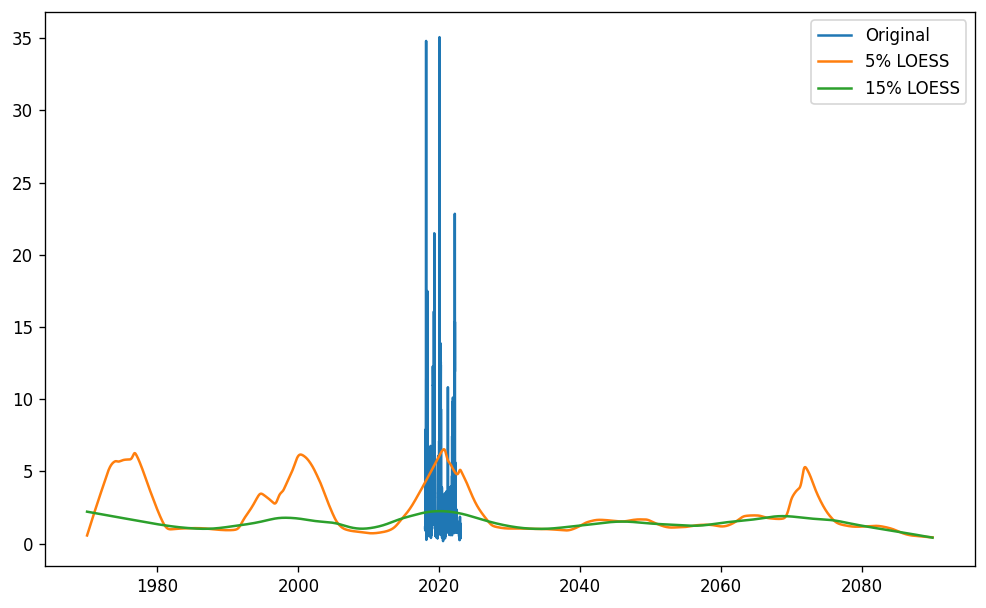

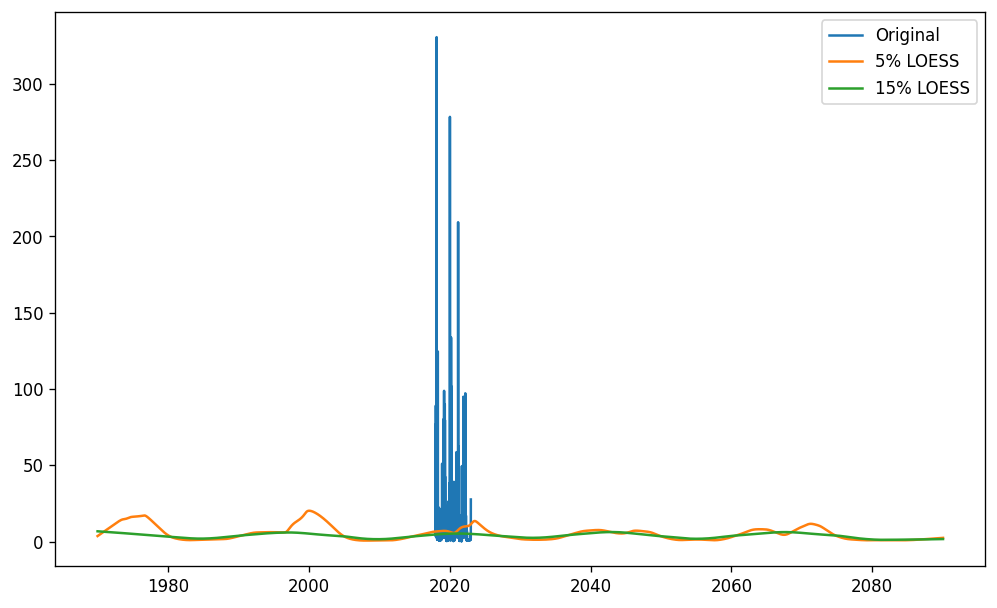

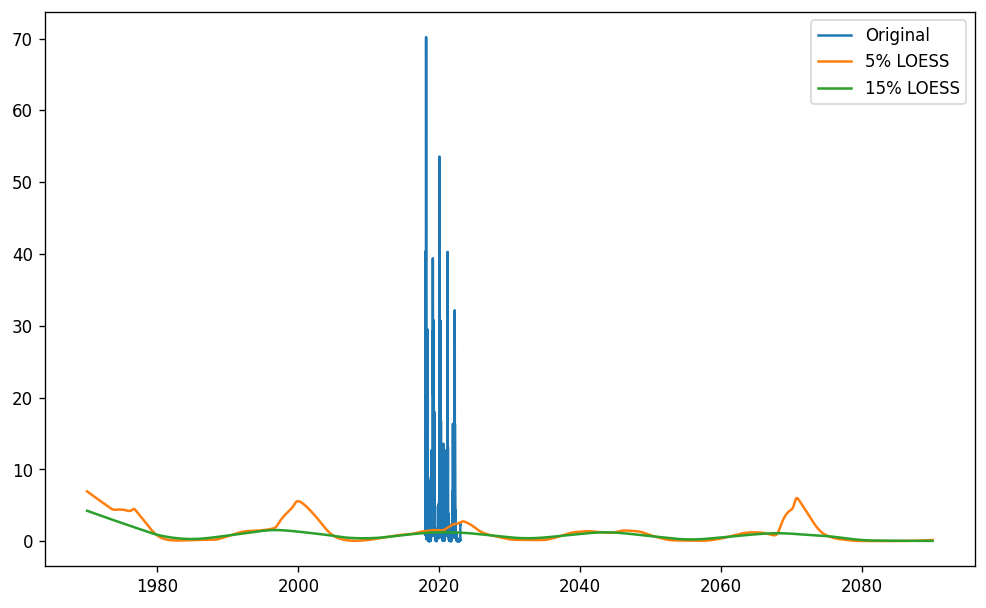

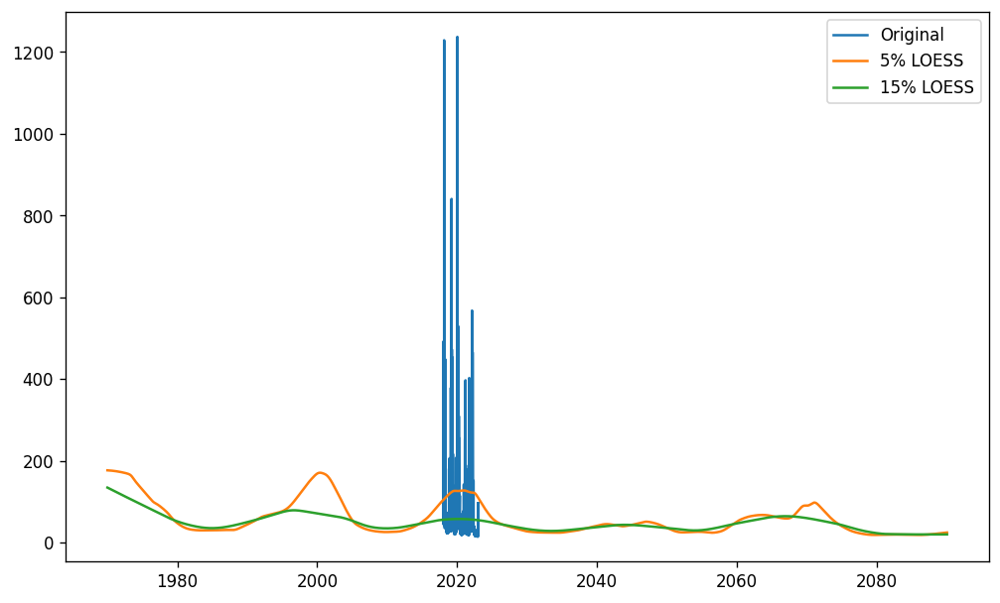

In [ ]:
for i in range(0, len(river_flow.columns)):
  river_flow_loess_5 = lowess(river_flow.iloc[:, i].values, np.arange(len(river_flow)), frac=0.05)
  river_flow_loess_15 = lowess(river_flow.iloc[:, i].values, np.arange(len(river_flow)), frac=0.15)
  plt.plot(river_flow.iloc[:, i])
  plt.plot(river_flow_loess_5[:, 1])
  plt.plot(river_flow_loess_15[:, 1])
  plt.legend(["Original", "5% LOESS", "15% LOESS"])
  plt.show()

It can be seen that the smoothning using LOESS is also not very effective.

# **Summation by year (after interpolation)**

In [ ]:
river_flow

,BlairCreek,Bridgeport,BridgeportWQ,Doon,Drayton,Elmira,Erbsville,Keldon,Leggatt,MillCreek,Moorefield,Phillipsburg,Road32,VictoriaRoad,Waldemar,WillowBrook,York
Timestamp,,,,,,,,,,,,,,,,,
2018-01-01 00:00:00,0.162000,44.202684,26.932000,15.136015,1.633473,0.6800,0.135527,1.207453,2.940143,0.898000,0.883397,2.394857,3.568644,1.059240,6.571770,1.142622,56.884066
2018-01-01 01:00:00,0.162000,44.040912,26.825400,15.150000,1.611479,0.6800,0.135047,1.223004,2.957151,0.902000,0.887479,2.416549,3.634335,1.066568,6.589006,1.123353,55.332323
2018-01-01 02:00:00,0.162250,44.404860,26.710600,15.163985,1.615141,0.6800,0.135527,1.230818,2.962889,0.898000,0.887479,2.387635,3.688094,1.051899,6.554596,1.156076,54.987491
2018-01-01 03:00:00,0.156458,44.040912,26.620400,15.177970,1.607817,0.6800,0.136970,1.230835,2.957201,0.902000,0.888838,2.380400,3.697868,1.055549,6.545890,1.156076,54.987491
2018-01-01 04:00:00,0.149000,44.121798,26.612200,15.191955,1.589485,0.6800,0.135047,1.223056,2.957189,0.902000,0.888838,2.344251,3.683207,1.059232,6.537265,1.156076,54.987491
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-01-01 19:00:00,6.112500,63.906250,66.752000,69.145801,44.066383,3.1520,0.462402,11.259375,27.373467,2.099606,13.084098,61.677028,6.587513,0.456600,26.698283,1.973442,70.339806
2023-01-01 20:00:00,6.677500,62.625000,65.328000,67.147994,42.725918,3.1205,0.433461,10.779167,26.982467,2.065631,12.854528,58.653723,6.661228,0.456600,26.765158,2.023615,77.500000
2023-01-01 21:00:00,6.511250,61.468750,63.942500,66.370603,41.430100,3.0890,0.410553,10.689583,26.656740,2.033860,12.601612,55.564362,6.686446,0.456600,26.984320,2.150197,86.687500


In [ ]:
river_flow_2018 = river_flow[river_flow.index < '2019-01-01 00:00:00']
river_flow_2018

,BlairCreek,Bridgeport,BridgeportWQ,Doon,Drayton,Elmira,Erbsville,Keldon,Leggatt,MillCreek,Moorefield,Phillipsburg,Road32,VictoriaRoad,Waldemar,WillowBrook,York
Timestamp,,,,,,,,,,,,,,,,,
2018-01-01 00:00:00,0.162000,44.202684,26.932000,15.136015,1.633473,0.680000,0.135527,1.207453,2.940143,0.8980,0.883397,2.394857,3.568644,1.059240,6.571770,1.142622,56.884066
2018-01-01 01:00:00,0.162000,44.040912,26.825400,15.150000,1.611479,0.680000,0.135047,1.223004,2.957151,0.9020,0.887479,2.416549,3.634335,1.066568,6.589006,1.123353,55.332323
2018-01-01 02:00:00,0.162250,44.404860,26.710600,15.163985,1.615141,0.680000,0.135527,1.230818,2.962889,0.8980,0.887479,2.387635,3.688094,1.051899,6.554596,1.156076,54.987491
2018-01-01 03:00:00,0.156458,44.040912,26.620400,15.177970,1.607817,0.680000,0.136970,1.230835,2.957201,0.9020,0.888838,2.380400,3.697868,1.055549,6.545890,1.156076,54.987491
2018-01-01 04:00:00,0.149000,44.121798,26.612200,15.191955,1.589485,0.680000,0.135047,1.223056,2.957189,0.9020,0.888838,2.344251,3.683207,1.059232,6.537265,1.156076,54.987491
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-12-31 19:00:00,0.221000,49.750000,54.167500,51.408000,6.718746,1.333108,0.181729,2.633566,7.890114,1.0855,1.793504,6.437500,8.482749,3.558557,14.077868,3.216322,126.104367
2018-12-31 20:00:00,0.222750,49.725000,54.100417,51.423250,6.633372,1.335187,0.179023,2.348465,8.469533,1.0855,1.769258,6.343438,8.583621,3.515312,13.601045,3.210000,125.177649
2018-12-31 21:00:00,0.237000,50.137500,54.272917,51.850250,6.578992,1.335187,0.179292,2.229764,9.194351,1.0855,1.772458,6.308438,8.665095,3.521399,13.523175,2.792647,124.945970


In [ ]:
river_flow_2019 = river_flow[(river_flow.index >= '2019-01-01 00:00:00') & (river_flow.index < '2020-01-01 00:00:00')]
river_flow_2019

,BlairCreek,Bridgeport,BridgeportWQ,Doon,Drayton,Elmira,Erbsville,Keldon,Leggatt,MillCreek,Moorefield,Phillipsburg,Road32,VictoriaRoad,Waldemar,WillowBrook,York
Timestamp,,,,,,,,,,,,,,,,,
2019-01-01 00:00:00,0.364500,55.333333,55.173750,53.619250,6.726380,1.414000,0.244948,2.197043,8.112986,1.17750,1.812880,6.529375,11.180662,3.509038,13.587536,2.867800,123.787573
2019-01-01 01:00:00,0.463250,57.031250,56.304583,55.251000,6.773179,1.480367,0.290035,2.197040,7.704364,1.23375,1.854892,6.853125,12.406764,3.502813,13.755110,2.872215,123.787573
2019-01-01 02:00:00,0.551250,59.114583,57.905000,58.209500,6.905065,1.575777,0.337076,2.220718,7.578538,1.33240,1.925951,7.564063,13.537173,3.508983,14.064551,2.796668,125.641008
2019-01-01 03:00:00,0.601875,60.645833,59.217917,60.161500,7.052766,1.673259,0.384703,2.253300,7.578398,1.41680,2.051766,8.789062,14.635888,3.527569,13.974683,2.796668,127.726123
2019-01-01 04:00:00,0.660813,62.333333,60.463750,62.512750,7.495382,1.791274,0.423873,2.383559,7.519884,1.51200,2.318401,10.656800,15.209403,3.521427,14.077667,2.872136,129.390683
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-31 19:00:00,0.388583,71.459000,67.600000,75.735000,12.223629,3.097558,0.336044,4.699100,19.452176,2.17690,3.638606,20.802500,11.372606,3.114211,22.863011,5.616200,182.455000
2019-12-31 20:00:00,0.379417,71.178125,66.992000,75.157000,11.539169,3.004223,0.326519,4.621225,19.030382,2.13910,3.593694,20.087500,11.434218,3.132457,22.613337,5.565000,183.960000
2019-12-31 21:00:00,0.370875,69.760375,66.352000,74.542000,11.065611,2.985554,0.317347,4.459175,18.511352,2.10670,3.557023,19.323125,11.465023,3.132498,22.436699,5.495000,185.640000


In [ ]:
river_flow_2020 = river_flow[(river_flow.index >= '2020-01-01 00:00:00') & (river_flow.index < '2021-01-01 00:00:00')]
river_flow_2020

,BlairCreek,Bridgeport,BridgeportWQ,Doon,Drayton,Elmira,Erbsville,Keldon,Leggatt,MillCreek,Moorefield,Phillipsburg,Road32,VictoriaRoad,Waldemar,WillowBrook,York
Timestamp,,,,,,,,,,,,,,,,,
2020-01-01 00:00:00,0.359375,66.947917,66.144000,71.962000,9.687763,2.786577,0.291418,4.050900,17.278382,2.0300,3.427644,17.325750,11.360758,3.126441,21.288686,5.239063,190.750
2020-01-01 01:00:00,0.352500,67.177083,65.616000,71.575000,9.303932,2.684893,0.286800,3.908275,16.856588,2.0125,3.373255,16.717750,11.396303,3.126400,20.966166,5.125312,191.625
2020-01-01 02:00:00,0.349250,66.427083,64.976000,71.575000,8.982354,2.604056,0.280553,3.811150,16.564790,1.9900,3.320514,16.128750,11.401042,3.150757,20.540585,5.026875,192.640
2020-01-01 03:00:00,0.346250,65.947917,64.320000,71.575000,8.598892,2.494549,0.275392,3.675000,16.131926,1.9675,3.265301,15.580125,11.303885,3.114266,20.192292,4.910938,193.200
2020-01-01 04:00:00,0.345125,66.364583,63.640625,71.300875,8.287372,2.463256,0.270774,3.558275,15.896790,1.9475,3.206380,15.076625,11.223316,3.114184,19.792380,4.795000,193.200
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31 19:00:00,0.468125,53.625000,51.658500,53.710750,12.384277,2.073386,0.309586,2.525974,7.919143,1.4008,2.698682,31.986607,9.280181,3.533774,12.645997,2.942000,124.900
2020-12-31 20:00:00,0.459500,51.862500,50.778750,53.726000,12.159584,2.036021,0.307822,2.522963,7.909508,1.3944,2.666273,31.570833,9.315726,3.515215,12.800555,2.946500,125.500
2020-12-31 21:00:00,0.447417,51.300000,50.256000,53.726000,11.861878,2.014095,0.305353,2.511125,7.948134,1.3912,2.638795,31.069940,9.325205,3.521399,12.800727,2.954000,125.500


In [ ]:
river_flow_2021 = river_flow[(river_flow.index >= '2021-01-01 00:00:00') & (river_flow.index < '2022-01-01 00:00:00')]
river_flow_2021

,BlairCreek,Bridgeport,BridgeportWQ,Doon,Drayton,Elmira,Erbsville,Keldon,Leggatt,MillCreek,Moorefield,Phillipsburg,Road32,VictoriaRoad,Waldemar,WillowBrook,York
Timestamp,,,,,,,,,,,,,,,,,
2021-01-01 00:00:00,0.420833,50.83750,48.67500,51.926500,11.077545,1.937357,0.300925,2.371925,7.928848,1.381600,2.644784,28.339583,9.318096,3.527597,12.878047,2.9540,125.125000
2021-01-01 01:00:00,0.411062,49.65000,48.15225,51.316500,10.790720,1.924200,0.299296,2.360013,7.919165,1.381600,2.547909,27.233036,9.289660,3.521427,12.890991,2.9540,124.787500
2021-01-01 02:00:00,0.412438,49.08750,47.75700,50.569250,10.651556,1.878157,0.297666,2.339279,7.919154,1.375200,2.501409,25.982440,9.232787,3.527597,12.865225,2.9540,124.487500
2021-01-01 03:00:00,0.401917,47.90000,47.24700,49.913500,10.402913,1.845264,0.295493,2.342221,7.899862,1.372000,2.471466,24.833333,9.161697,3.502855,12.878104,2.9540,124.187500
2021-01-01 04:00:00,0.384417,47.57500,46.78800,49.187500,10.236689,1.803610,0.292505,2.324468,7.851557,1.365600,2.445750,23.599107,9.105441,3.502799,12.878118,2.9540,124.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-12-31 19:00:00,0.268750,29.37000,28.84260,26.341583,2.597282,0.822800,0.191208,1.154133,6.461800,0.721439,0.900703,3.284200,5.501196,1.794825,6.820522,1.1996,65.679612
2021-12-31 20:00:00,0.275667,29.35250,28.85490,26.343510,2.593598,0.822800,0.193511,1.147993,6.445227,0.725965,0.899805,3.300175,5.549692,1.796192,6.819065,1.1996,65.679612
2021-12-31 21:00:00,0.277667,29.34375,28.86720,26.393680,2.585558,0.822800,0.196737,1.148578,6.417730,0.731376,0.900526,3.325025,5.588489,1.796335,6.799055,1.1996,65.656311


In [ ]:
river_flow_2022 = river_flow[(river_flow.index >= '2022-01-01 00:00:00') & (river_flow.index < '2023-01-01 00:00:00')]
river_flow_2022

,BlairCreek,Bridgeport,BridgeportWQ,Doon,Drayton,Elmira,Erbsville,Keldon,Leggatt,MillCreek,Moorefield,Phillipsburg,Road32,VictoriaRoad,Waldemar,WillowBrook,York
Timestamp,,,,,,,,,,,,,,,,,
2022-01-01 00:00:00,0.282500,29.413750,28.867200,26.461227,2.569811,0.8228,0.206416,1.126650,6.365938,0.742368,0.904455,3.408450,5.567151,1.797953,6.796433,1.199600,64.864078
2022-01-01 01:00:00,0.281667,29.413750,28.953300,26.462467,2.578307,0.8228,0.207212,1.126357,6.348800,0.747018,0.907554,3.440400,5.584610,1.799247,6.796044,1.199600,64.747573
2022-01-01 02:00:00,0.293000,29.405000,28.965600,26.465963,2.590249,0.8228,0.207497,1.127819,6.332038,0.748053,0.910941,3.459925,5.594309,1.801406,6.797404,1.199600,64.584466
2022-01-01 03:00:00,0.293000,29.387500,28.965600,26.460703,2.597222,0.8228,0.206330,1.139514,6.325258,0.748842,0.914027,3.504300,5.590429,1.802338,6.796821,1.199600,64.561165
2022-01-01 04:00:00,0.293000,29.413750,28.965600,26.468253,2.602158,0.8228,0.205992,1.149163,6.303600,0.750649,0.918092,3.568200,5.561331,1.802623,6.802552,1.199600,64.561165
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-31 19:00:00,3.414751,27.882500,35.507512,25.917887,80.996334,1.3580,0.678115,17.110417,15.778777,2.213550,20.702985,59.246144,8.798945,0.450000,13.128768,1.590900,32.432992
2022-12-31 20:00:00,3.421887,30.459000,39.056625,25.812627,84.655214,1.4490,0.698579,18.926250,16.427015,2.255045,19.568160,63.458821,8.546764,0.449972,14.471586,1.691700,32.782172
2022-12-31 21:00:00,3.429023,46.725000,61.081875,24.723682,88.247291,1.5120,0.716709,17.387500,17.249255,2.290004,18.904592,62.515519,8.199530,0.449472,15.118833,1.743900,33.422336


In [ ]:
river_flow_2018.sum()

BlairCreek        2085.840338
Bridgeport      308686.267712
BridgeportWQ    277264.361018
Doon            283765.210990
Drayton          48255.505816
Elmira            9754.141247
Erbsville         1784.437476
Keldon           23661.074673
Leggatt          56430.878633
MillCreek        10454.249681
Moorefield       16676.843377
Phillipsburg     65256.675516
Road32           61149.670619
VictoriaRoad     21152.357595
Waldemar         86987.251997
WillowBrook      22935.769408
York            784917.588252
dtype: float64

In [ ]:
sum_river_flow = pd.DataFrame(river_flow.columns, columns=["Location"])
sum_river_flow

,Location
0,BlairCreek
1,Bridgeport
2,BridgeportWQ
3,Doon
4,Drayton
5,Elmira
6,Erbsville
7,Keldon
8,Leggatt
9,MillCreek


In [ ]:
sum_river_flow["2018"] = river_flow_2018.sum().values
sum_river_flow["2019"] = river_flow_2019.sum().values
sum_river_flow["2020"] = river_flow_2020.sum().values
sum_river_flow["2021"] = river_flow_2021.sum().values
sum_river_flow["2022"] = river_flow_2022.sum().values
sum_river_flow

,Location,2018,2019,2020,2021,2022
0,BlairCreek,2085.840338,2717.880607,2145.506603,2083.794325,2842.333615
1,Bridgeport,308686.267712,290559.869101,276419.398429,235453.200542,192009.483444
2,BridgeportWQ,277264.361018,190774.712963,238374.306121,181633.847929,151313.492448
3,Doon,283765.210990,287128.020573,251415.600682,224359.290595,180107.944362
4,Drayton,48255.505816,40591.827149,40936.122053,39268.823357,30730.116483
5,Elmira,9754.141247,10601.020801,8691.846484,6853.173830,6822.384040
6,Erbsville,1784.437476,1889.716907,1307.763249,1514.460207,1426.397568
7,Keldon,23661.074673,27210.251380,16942.531171,18400.284754,13831.876358
8,Leggatt,56430.878633,50619.593851,50634.652770,48551.100823,37510.001489
9,MillCreek,10454.249681,12097.070473,8703.248279,5814.243296,6003.878862


In [ ]:
sum_river_flow.columns

Index(['Location', '2018', '2019', '2020', '2021', '2022'], dtype='object')

In [ ]:
sum_river_flow.set_index("Location", inplace= True)

In [ ]:
sum_river_flow

,2018,2019,2020,2021,2022
Location,,,,,
BlairCreek,2085.840338,2717.880607,2145.506603,2083.794325,2842.333615
Bridgeport,308686.267712,290559.869101,276419.398429,235453.200542,192009.483444
BridgeportWQ,277264.361018,190774.712963,238374.306121,181633.847929,151313.492448
Doon,283765.210990,287128.020573,251415.600682,224359.290595,180107.944362
Drayton,48255.505816,40591.827149,40936.122053,39268.823357,30730.116483
Elmira,9754.141247,10601.020801,8691.846484,6853.173830,6822.384040
Erbsville,1784.437476,1889.716907,1307.763249,1514.460207,1426.397568
Keldon,23661.074673,27210.251380,16942.531171,18400.284754,13831.876358
Leggatt,56430.878633,50619.593851,50634.652770,48551.100823,37510.001489


In [ ]:
sum_river_flow = sum_river_flow*3600

In [ ]:
sum_river_flow = sum_river_flow/1000
sum_river_flow

,2018,2019,2020,2021,2022
Location,,,,,
BlairCreek,7.509025e+03,9.784370e+03,7.723824e+03,7.501660e+03,1.023240e+04
Bridgeport,1.111271e+06,1.046016e+06,9.951098e+05,8.476315e+05,6.912341e+05
BridgeportWQ,9.981517e+05,6.867890e+05,8.581475e+05,6.538819e+05,5.447286e+05
Doon,1.021555e+06,1.033661e+06,9.050962e+05,8.076934e+05,6.483886e+05
Drayton,1.737198e+05,1.461306e+05,1.473700e+05,1.413678e+05,1.106284e+05
Elmira,3.511491e+04,3.816367e+04,3.129065e+04,2.467143e+04,2.456058e+04
Erbsville,6.423975e+03,6.802981e+03,4.707948e+03,5.452057e+03,5.135031e+03
Keldon,8.517987e+04,9.795690e+04,6.099311e+04,6.624103e+04,4.979475e+04
Leggatt,2.031512e+05,1.822305e+05,1.822847e+05,1.747840e+05,1.350360e+05


This gives the annual flow for each locations in million litres/hour.

In [ ]:
sum_river_flow.to_csv("SummationRiverFlowAfterInterpolation.csv")

In [ ]:
from google.colab import files
down = files.download("SummationRiverFlowAfterInterpolation.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>